
# 1.0 Importing Libraries

In [1]:
# Installing Necessary Libraries
!pip install termcolor
!pip install tensorflow
!pip install keras-tuner
!pip install keras scikit-learn
!pip install pandas
!pip install seaborn
!pip install matplotlib
!pip install statsmodels
#!pip install pydot
#!pip install graphviz
#!pip install memory_profiler
#!pip install keras-flops
#!pip install openpyxl

# Importing Necessary Libraries
import os
import datetime
import psutil
import time
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import csv
import keras
import keras_tuner
import tensorflow as tf
import statsmodels.api as sm
#import plotly.express as px

from math import sqrt
from termcolor import colored
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import TimeSeriesSplit
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import mutual_info_regression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
from statsmodels.tsa.seasonal import seasonal_decompose
from keras.models import Sequential
from keras.layers import Reshape, LSTM, GRU, Bidirectional, Conv1D, Dropout, Dense, MaxPooling1D, Flatten
from functools import partial
from keras_tuner import HyperParameters
from keras_tuner import BayesianOptimization
from keras.optimizers import Adam
from tensorflow.keras.layers import Reshape
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import plot_model
#from memory_profiler import memory_usage
#from keras_flops import get_flops
#from plotly import figure_factory as figfac

# Enable inline plotting in Jupyter Notebook
%matplotlib inline

# Display Message
print(colored("Libraries has been successfully imported...", color = "green", attrs = ["bold", "dark"]))


Libraries has been successfully imported...


# 2.0 Loading and Reading Dataset

**Dataset Features**
- **Gold ETF** : Date, Open, High, Low, Close and Volume.
- **S&P 500 Index** : 'SP_open', 'SP_high', 'SP_low', 'SP_close', 'SP_Ajclose', 'SP_volume'
- **Dow Jones Index** : 'DJ_open','DJ_high', 'DJ_low', 'DJ_close', 'DJ_Ajclose', 'DJ_volume'
- **Eldorado Gold Corporation (EGO)** : 'EG_open', 'EG_high', 'EG_low', 'EG_close', 'EG_Ajclose', 'EG_volume'
- **EURO - USD Exchange Rate** : 'EU_Price','EU_open', 'EU_high', 'EU_low', 'EU_Trend'
- **Brent Crude Oil Futures** : 'OF_Price', 'OF_Open', 'OF_High', 'OF_Low', 'OF_Volume', 'OF_Trend'
- **Crude Oil WTI USD** : 'OS_Price', 'OS_Open', 'OS_High', 'OS_Low', 'OS_Trend'
- **Silver Futures** : 'SF_Price', 'SF_Open', 'SF_High', 'SF_Low', 'SF_Volume', 'SF_Trend'
- **US Bond Rate (10 years)** : 'USB_Price', 'USB_Open', 'USB_High','USB_Low', 'USB_Trend'
- **Platinum Price** : 'PLT_Price', 'PLT_Open', 'PLT_High', 'PLT_Low','PLT_Trend'
- **Palladium Price** : 'PLD_Price', 'PLD_Open', 'PLD_High', 'PLD_Low','PLD_Trend'
- **Rhodium Prices** : 'RHO_PRICE'
- **US Dollar Index** : 'USDI_Price', 'USDI_Open', 'USDI_High','USDI_Low', 'USDI_Volume', 'USDI_Trend'
- **Gold Miners ETF** : 'GDX_Open', 'GDX_High', 'GDX_Low', 'GDX_Close', 'GDX_Adj Close', 'GDX_Volume'
- **Oil ETF USO** : 'USO_Open','USO_High', 'USO_Low', 'USO_Close', 'USO_Adj Close', 'USO_Volume'


**Target Variable**
- **Gold ETF** :- Adjusted Close

In [2]:
# Reading the Gold Price Dataset(s)
df = pd.read_csv('C:/Users/60164/FYP/input/FINAL_USO.csv')
df.head()

,Date,Open,High,Low,Close,Adj Close,Volume,SP_open,SP_high,SP_low,...,GDX_Low,GDX_Close,GDX_Adj Close,GDX_Volume,USO_Open,USO_High,USO_Low,USO_Close,USO_Adj Close,USO_Volume
0,2011-12-15,154.740005,154.949997,151.710007,152.330002,152.330002,21521900,123.029999,123.199997,121.989998,...,51.570000,51.680000,48.973877,20605600,36.900002,36.939999,36.049999,36.130001,36.130001,12616700
1,2011-12-16,154.309998,155.369995,153.899994,155.229996,155.229996,18124300,122.230003,122.949997,121.300003,...,52.040001,52.680000,49.921513,16285400,36.180000,36.500000,35.730000,36.270000,36.270000,12578800
2,2011-12-19,155.479996,155.860001,154.360001,154.869995,154.869995,12547200,122.059998,122.320000,120.029999,...,51.029999,51.169998,48.490578,15120200,36.389999,36.450001,35.930000,36.200001,36.200001,7418200
3,2011-12-20,156.820007,157.429993,156.580002,156.979996,156.979996,9136300,122.180000,124.139999,120.370003,...,52.369999,52.990002,50.215282,11644900,37.299999,37.610001,37.220001,37.560001,37.560001,10041600
4,2011-12-21,156.979996,157.529999,156.130005,157.160004,157.160004,11996100,123.930000,124.360001,122.750000,...,52.419998,52.959999,50.186852,8724300,37.669998,38.240002,37.520000,38.110001,38.110001,10728000


# 3.0 Dataset Overview and Descriptive Analysis

In [3]:
# Determine the Shape of the Dataset
shape = df.shape
print("Dataset Shape: ", shape)
print(f"This dataset has {shape[0]} rows and {shape[1]} columns.")

Dataset Shape:  (1718, 81)
This dataset has 1718 rows and 81 columns.


In [4]:
# Determine the Details and Information of the Dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1718 entries, 0 to 1717
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           1718 non-null   object 
 1   Open           1718 non-null   float64
 2   High           1718 non-null   float64
 3   Low            1718 non-null   float64
 4   Close          1718 non-null   float64
 5   Adj Close      1718 non-null   float64
 6   Volume         1718 non-null   int64  
 7   SP_open        1718 non-null   float64
 8   SP_high        1718 non-null   float64
 9   SP_low         1718 non-null   float64
 10  SP_close       1718 non-null   float64
 11  SP_Ajclose     1718 non-null   float64
 12  SP_volume      1718 non-null   int64  
 13  DJ_open        1718 non-null   float64
 14  DJ_high        1718 non-null   float64
 15  DJ_low         1718 non-null   float64
 16  DJ_close       1718 non-null   float64
 17  DJ_Ajclose     1718 non-null   float64
 18  DJ_volum

In [5]:
# Determine the Unique Elements in Each Column of the Dataset
df.nunique()

Date             1718
Open             1363
High             1368
Low              1356
Close            1384
                 ... 
USO_High         1102
USO_Low          1124
USO_Close        1128
USO_Adj Close    1128
USO_Volume       1716
Length: 81, dtype: int64

In [6]:
# Describe the Dataset
df.describe()

,Open,High,Low,Close,Adj Close,Volume,SP_open,SP_high,SP_low,SP_close,...,GDX_Low,GDX_Close,GDX_Adj Close,GDX_Volume,USO_Open,USO_High,USO_Low,USO_Close,USO_Adj Close,USO_Volume
count,1718.000000,1718.000000,1718.000000,1718.000000,1718.000000,1.718000e+03,1718.000000,1718.000000,1718.000000,1718.000000,...,1718.000000,1718.000000,1718.000000,1.718000e+03,1718.000000,1718.000000,1718.000000,1718.000000,1718.000000,1.718000e+03
mean,127.323434,127.854237,126.777695,127.319482,127.319482,8.446327e+06,204.490023,205.372637,203.487014,204.491222,...,26.384575,26.715012,25.924624,4.356515e+07,22.113417,22.307148,21.904657,22.109051,22.109051,1.922313e+07
std,17.526993,17.631189,17.396513,17.536269,17.536269,4.920731e+06,43.831928,43.974644,43.618940,43.776999,...,10.490908,10.603110,9.886570,2.909151e+07,11.431056,11.478671,11.373997,11.432787,11.432787,1.575743e+07
min,100.919998,100.989998,100.230003,100.500000,100.500000,1.501600e+06,122.059998,122.320000,120.029999,120.290001,...,12.400000,12.470000,12.269618,4.729000e+06,7.820000,8.030000,7.670000,7.960000,7.960000,1.035100e+06
25%,116.220001,116.540001,115.739998,116.052502,116.052502,5.412925e+06,170.392498,170.962506,169.577499,170.397500,...,20.355000,20.585000,20.180950,2.259968e+07,11.420000,11.500000,11.300000,11.392500,11.392500,6.229500e+06
50%,121.915001,122.325001,121.369999,121.795002,121.795002,7.483900e+06,205.464996,206.459999,204.430000,205.529999,...,22.870001,23.054999,22.677604,3.730465e+07,16.450000,16.635001,16.040000,16.345000,16.345000,1.613015e+07
75%,128.427494,129.087498,127.840001,128.470001,128.470001,1.020795e+07,237.292500,237.722500,236.147503,236.889996,...,26.797500,27.317500,26.478154,5.697055e+07,34.419998,34.667499,34.110000,34.417499,34.417499,2.672375e+07
max,173.199997,174.070007,172.919998,173.610001,173.610001,9.380420e+07,293.089996,293.940002,291.809998,293.579987,...,56.770000,57.470001,54.617039,2.321536e+08,41.599998,42.299999,41.299999,42.009998,42.009998,1.102657e+08


# 4.0 Data Preprocessing

## 4.1 Data Cleaning

### 4.1.1 Detecting and Handling Duplicates in the Dataset

In [7]:
# Checking for Duplicates
num_duplicates = df.duplicated().sum()
print("Number of Duplicates:", num_duplicates)

Number of Duplicates: 0


In [8]:
# Handling Duplicates (Drop Any Duplicate Rows)
if df.duplicated().any():
    # Drop duplicate rows from the DataFrame
    df.drop_duplicates(inplace=True)
    print(colored("Duplicate rows have been dropped.", color="green", attrs=["bold", "dark"]))
else:
    print(colored("No duplicate rows found. Data is already deduplicated.", color="green", attrs=["bold", "dark"]))

No duplicate rows found. Data is already deduplicated.


### 4.1.2 Detecting and Handling Missing Values in the Dataset

In [9]:
# Checking for Missing Values
missing_values = df.isnull().values.any()
print("Missing Values: ", missing_values)

Missing Values:  False


In [10]:
# Checking for Missing Values in Each Individual Column
missing_values = df.isnull().sum()
print("Missing Values in Each Individual Column: ")
print(missing_values)

Missing Values in Each Individual Column: 
Date             0
Open             0
High             0
Low              0
Close            0
                ..
USO_High         0
USO_Low          0
USO_Close        0
USO_Adj Close    0
USO_Volume       0
Length: 81, dtype: int64


In [11]:
# Handling Missing Values (Replace with the Mean of the Respective Column)
if missing_values.any():
    # Calculate the mean of each column
    column_means = df.mean()
    
    # Replace missing values with column means
    df.fillna(column_means, inplace=True)
    print(colored("Missing values replaced with column means.", color = "green", attrs = ["bold", "dark"]))
else:
    print(colored("No missing values found. Data is already clean.", color = "green", attrs = ["bold", "dark"]))

No missing values found. Data is already clean.


### 4.1.3 Detecting and Handling Outliers in the Dataset

In [12]:
# Exclude non-numeric columns
numeric_cols = df.select_dtypes(include=['float64', 'int64'])

# Calculate IQR for numeric columns
Q1 = numeric_cols.quantile(0.25)
Q3 = numeric_cols.quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Detect outliers using Interquartile Range (IQR) method
outliers_iqr = (numeric_cols < lower_bound) | (numeric_cols > upper_bound)

# Extract rows containing outliers based on IQR method
outliers_iqr_df = df[outliers_iqr.any(axis=1)]

# Display the number of rows containing outliers and the first few of these rows
num_outliers = len(outliers_iqr_df)

print("Number of Outliers based on IQR method:", num_outliers)
print("Outliers based on IQR method:")
outliers_iqr_df

Number of Outliers based on IQR method: 883
Outliers based on IQR method:


,Date,Open,High,Low,Close,Adj Close,Volume,SP_open,SP_high,SP_low,...,GDX_Low,GDX_Close,GDX_Adj Close,GDX_Volume,USO_Open,USO_High,USO_Low,USO_Close,USO_Adj Close,USO_Volume
0,2011-12-15,154.740005,154.949997,151.710007,152.330002,152.330002,21521900,123.029999,123.199997,121.989998,...,51.570000,51.680000,48.973877,20605600,36.900002,36.939999,36.049999,36.130001,36.130001,12616700
1,2011-12-16,154.309998,155.369995,153.899994,155.229996,155.229996,18124300,122.230003,122.949997,121.300003,...,52.040001,52.680000,49.921513,16285400,36.180000,36.500000,35.730000,36.270000,36.270000,12578800
2,2011-12-19,155.479996,155.860001,154.360001,154.869995,154.869995,12547200,122.059998,122.320000,120.029999,...,51.029999,51.169998,48.490578,15120200,36.389999,36.450001,35.930000,36.200001,36.200001,7418200
3,2011-12-20,156.820007,157.429993,156.580002,156.979996,156.979996,9136300,122.180000,124.139999,120.370003,...,52.369999,52.990002,50.215282,11644900,37.299999,37.610001,37.220001,37.560001,37.560001,10041600
4,2011-12-21,156.979996,157.529999,156.130005,157.160004,157.160004,11996100,123.930000,124.360001,122.750000,...,52.419998,52.959999,50.186852,8724300,37.669998,38.240002,37.520000,38.110001,38.110001,10728000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1713,2018-12-24,119.570000,120.139999,119.570000,120.019997,120.019997,9736400,239.039993,240.839996,234.270004,...,20.650000,21.090000,21.090000,60507000,9.490000,9.520000,9.280000,9.290000,9.290000,21598200
1714,2018-12-26,120.620003,121.000000,119.570000,119.660004,119.660004,14293500,235.970001,246.179993,233.759995,...,20.530001,20.620001,20.620001,76365200,9.250000,9.920000,9.230000,9.900000,9.900000,40978800
1715,2018-12-27,120.570000,120.900002,120.139999,120.570000,120.570000,11874400,242.570007,248.289993,238.960007,...,20.700001,20.969999,20.969999,52393000,9.590000,9.650000,9.370000,9.620000,9.620000,36578700
1716,2018-12-28,120.800003,121.080002,120.720001,121.059998,121.059998,6864700,249.580002,251.399994,246.449997,...,20.570000,20.600000,20.600000,49835000,9.540000,9.650000,9.380000,9.530000,9.530000,22803400


Note: While outlier detection on time series gold price data is essential, it is important to consider market volatility that may arise from extreme market events. Hence, the preservation of these critical data points, characterized by their outlier nature becomes a necessity to avoid inadvertently erasing invaluable insights into the intricate complexities of the gold market.

### 4.1.4 Displaying the Cleaned DataFrame

In [13]:
print("Cleaned DataFrame:")
df.head()

Cleaned DataFrame:


,Date,Open,High,Low,Close,Adj Close,Volume,SP_open,SP_high,SP_low,...,GDX_Low,GDX_Close,GDX_Adj Close,GDX_Volume,USO_Open,USO_High,USO_Low,USO_Close,USO_Adj Close,USO_Volume
0,2011-12-15,154.740005,154.949997,151.710007,152.330002,152.330002,21521900,123.029999,123.199997,121.989998,...,51.570000,51.680000,48.973877,20605600,36.900002,36.939999,36.049999,36.130001,36.130001,12616700
1,2011-12-16,154.309998,155.369995,153.899994,155.229996,155.229996,18124300,122.230003,122.949997,121.300003,...,52.040001,52.680000,49.921513,16285400,36.180000,36.500000,35.730000,36.270000,36.270000,12578800
2,2011-12-19,155.479996,155.860001,154.360001,154.869995,154.869995,12547200,122.059998,122.320000,120.029999,...,51.029999,51.169998,48.490578,15120200,36.389999,36.450001,35.930000,36.200001,36.200001,7418200
3,2011-12-20,156.820007,157.429993,156.580002,156.979996,156.979996,9136300,122.180000,124.139999,120.370003,...,52.369999,52.990002,50.215282,11644900,37.299999,37.610001,37.220001,37.560001,37.560001,10041600
4,2011-12-21,156.979996,157.529999,156.130005,157.160004,157.160004,11996100,123.930000,124.360001,122.750000,...,52.419998,52.959999,50.186852,8724300,37.669998,38.240002,37.520000,38.110001,38.110001,10728000


## 4.2 Data Transformation

In [14]:
# Convert the 'Date' column to pandas datetime
df['Date'] = pd.to_datetime(df['Date'])

In [15]:
df['Date'].min()

Timestamp('2011-12-15 00:00:00')

In [16]:
df['Date'].max()

Timestamp('2018-12-31 00:00:00')

In [17]:
# Set 'Date' column as the index
df.set_index('Date', inplace=True)

# Sort the DataFrame by the 'Date' column in ascending order
df.sort_values(by='Date', inplace=True)

## 4.3 Feature Selection and Extraction

### 4.3.1 Handling the ‘Adjusted Close’ and ‘Close’ Columns

The relevant features will be used as the input (independent variables) for model training to forecast the gold prices, while the 'Adj Close' and 'Close' columns will be retained separately as the target variable (dependant variable) during the model training and evaluation process. Consequently, both these columns are dropped from the dataframe, with 'Close' being removed due to its high similarity to 'Adj Close', which may lead to multicollinearity issues.

In [18]:
# Drop the 'Adj Close' column from the DataFrame
gold_price = df.drop(['Adj Close'],axis=1)

# Drop the 'Close' column from the DataFrame
gold_price = gold_price.drop(['Close'],axis=1)

In [19]:
# Target column
target_adj_close = pd.DataFrame(df['Adj Close'])

### 4.3.2 Correlation Coefficient

<Axes: title={'center': 'The Correlation with Adj Close'}>

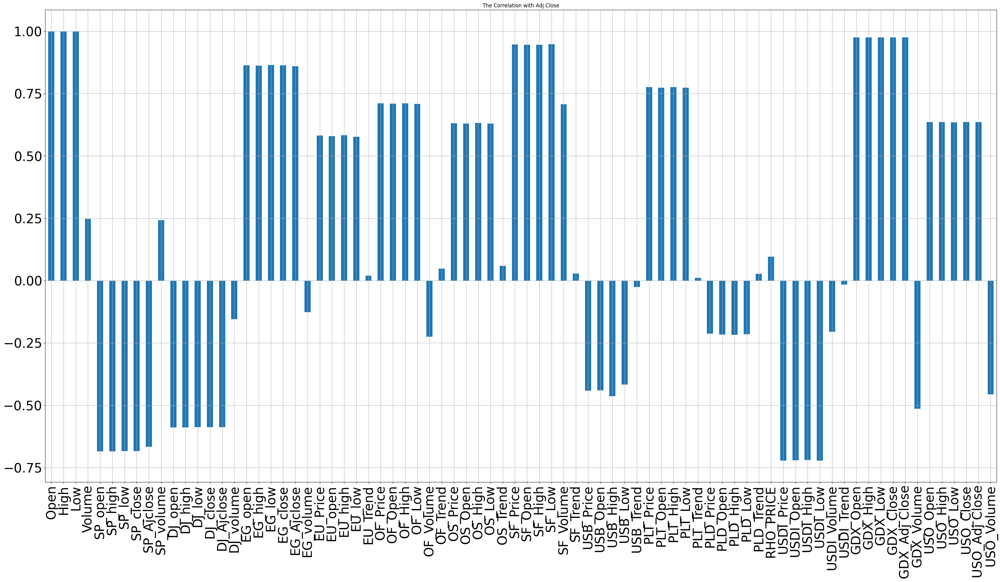

In [20]:
# Calculate the Correlation between Each Column in DataFrame 'gold_price' and the 'Adj Close' Column in df
correlation_with_adj_close = gold_price.corrwith(df['Adj Close'])

# Plot the Correlation Values as a Bar Chart
correlation_with_adj_close.plot.bar(figsize=(40, 20), title="The Correlation with Adj Close", fontsize=30,
                                    rot=90, grid=True)

In [21]:
# Calculate the Correlation Matrix for the DataFrame df
correlation_matrix = df.corr()

# Extract the Correlation Coefficients Between the 'Adj Close' Column and all other columns
coefficient = correlation_matrix["Adj Close"].sort_values(ascending=False)

In [22]:
# Filter Attributes with Positive Correlation
positive_correlations = coefficient[coefficient > 0]

# Display the Positively Correlated Attributes
print("Positively Correlated Attributes:")
positive_correlations

Positively Correlated Attributes:


Close            1.000000
Adj Close        1.000000
High             0.999535
Low              0.999532
Open             0.998976
GDX_Low          0.975561
GDX_Close        0.975459
GDX_High         0.975255
GDX_Adj Close    0.974980
GDX_Open         0.974824
SF_Low           0.947842
SF_Price         0.947420
SF_Open          0.945557
SF_High          0.945203
EG_low           0.863917
EG_open          0.862900
EG_close         0.862770
EG_high          0.861479
EG_Ajclose       0.859850
PLT_Price        0.775861
PLT_High         0.775481
PLT_Low          0.773993
PLT_Open         0.773760
OF_High          0.711334
OF_Price         0.710693
OF_Open          0.709096
OF_Low           0.708266
SF_Volume        0.706505
USO_Adj Close    0.635675
USO_Close        0.635675
USO_High         0.635311
USO_Open         0.635197
USO_Low          0.634732
OS_High          0.632001
OS_Price         0.630817
OS_Open          0.630046
OS_Low           0.629083
EU_high          0.582969
EU_Price    

In [23]:
# Filter Attributes with Negative Correlation
negative_correlations = coefficient[coefficient < 0]

# Display the Negatively Correlated Attributes
print("Negatively Correlated Attributes:")
negative_correlations

Negatively Correlated Attributes:


USDI_Trend    -0.016641
USB_Trend     -0.025933
EG_volume     -0.126586
DJ_volume     -0.155526
USDI_Volume   -0.205954
PLD_Price     -0.213179
PLD_Low       -0.214919
PLD_Open      -0.216426
PLD_High      -0.217490
OF_Volume     -0.225436
USB_Low       -0.417352
USB_Open      -0.440822
USB_Price     -0.441347
USO_Volume    -0.456193
USB_High      -0.464116
GDX_Volume    -0.514616
DJ_low        -0.588157
DJ_Ajclose    -0.588411
DJ_close      -0.588411
DJ_high       -0.588778
DJ_open       -0.588800
SP_Ajclose    -0.666071
SP_low        -0.683750
SP_close      -0.684284
SP_open       -0.684618
SP_high       -0.684904
USDI_High     -0.720023
USDI_Open     -0.720140
USDI_Price    -0.721569
USDI_Low      -0.722078
Name: Adj Close, dtype: float64

#### 4.3.2.1 Understanding the Correlation between Dataset Variables

In [24]:
# Display the Correlation Matrix
print("Correlation Matrix:")
df[list(df.columns)[1:]].corr()

Correlation Matrix:


,High,Low,Close,Adj Close,Volume,SP_open,SP_high,SP_low,SP_close,SP_Ajclose,...,GDX_Low,GDX_Close,GDX_Adj Close,GDX_Volume,USO_Open,USO_High,USO_Low,USO_Close,USO_Adj Close,USO_Volume
High,1.000000,0.999262,0.999535,0.999535,0.261064,-0.688118,-0.688365,-0.687325,-0.687817,-0.669657,...,0.975650,0.975341,0.974746,-0.508782,0.637101,0.637208,0.636538,0.637483,0.637483,-0.454913
Low,0.999262,1.000000,0.999532,0.999532,0.237031,-0.680911,-0.681242,-0.679988,-0.680567,-0.662325,...,0.975337,0.974568,0.974182,-0.519988,0.633591,0.633623,0.633140,0.633994,0.633994,-0.457628
Close,0.999535,0.999532,1.000000,1.000000,0.246778,-0.684618,-0.684904,-0.683750,-0.684284,-0.666071,...,0.975561,0.975459,0.974980,-0.514616,0.635197,0.635311,0.634732,0.635675,0.635675,-0.456193
Adj Close,0.999535,0.999532,1.000000,1.000000,0.246778,-0.684618,-0.684904,-0.683750,-0.684284,-0.666071,...,0.975561,0.975459,0.974980,-0.514616,0.635197,0.635311,0.634732,0.635675,0.635675,-0.456193
Volume,0.261064,0.237031,0.246778,0.246778,1.000000,-0.218726,-0.216355,-0.223317,-0.220631,-0.208594,...,0.241727,0.248752,0.250313,0.302225,0.082632,0.083064,0.080475,0.081642,0.081642,0.069580
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
USO_High,0.637208,0.633623,0.635311,0.635311,0.083064,-0.774626,-0.775482,-0.773550,-0.774799,-0.786760,...,0.614587,0.614766,0.600523,-0.522581,0.999857,1.000000,0.999818,0.999867,0.999867,-0.695678
USO_Low,0.636538,0.633140,0.634732,0.634732,0.080475,-0.771235,-0.772154,-0.770087,-0.771396,-0.783347,...,0.613844,0.613931,0.599819,-0.523956,0.999848,0.999818,1.000000,0.999879,0.999879,-0.702665
USO_Close,0.637483,0.633994,0.635675,0.635675,0.081642,-0.773099,-0.773957,-0.771928,-0.773159,-0.785103,...,0.614733,0.614915,0.600756,-0.523801,0.999699,0.999867,0.999879,1.000000,1.000000,-0.699221
USO_Adj Close,0.637483,0.633994,0.635675,0.635675,0.081642,-0.773099,-0.773957,-0.771928,-0.773159,-0.785103,...,0.614733,0.614915,0.600756,-0.523801,0.999699,0.999867,0.999879,1.000000,1.000000,-0.699221


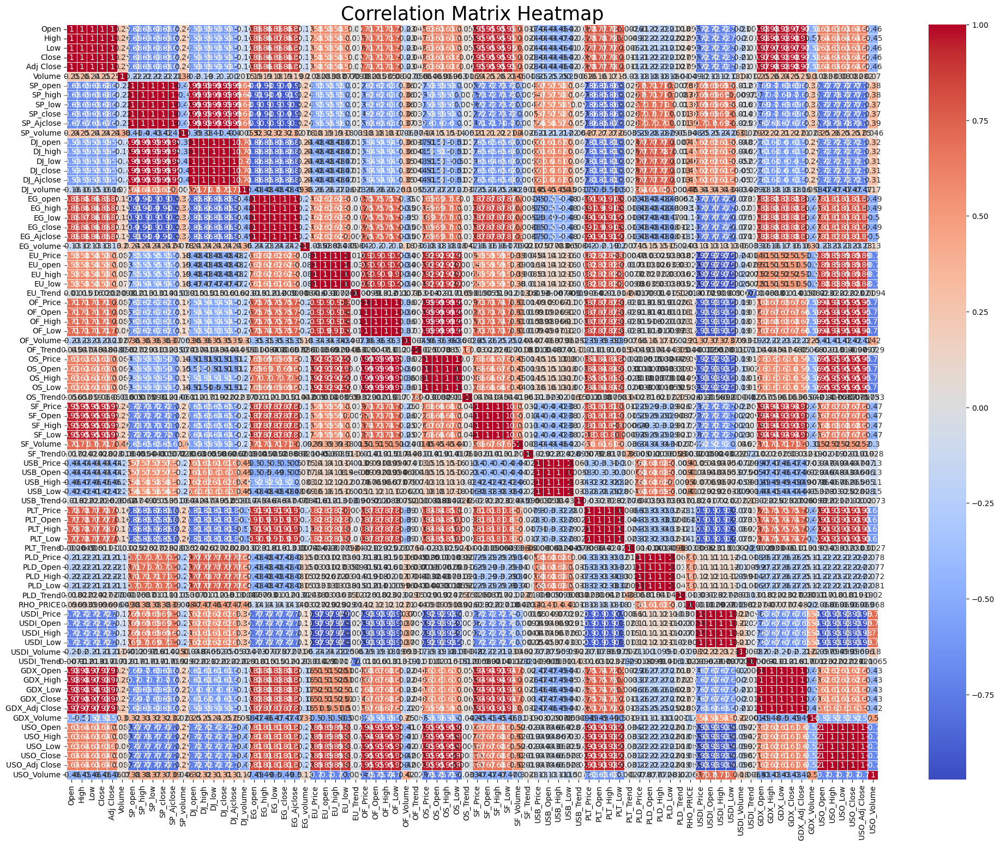

In [25]:
# Plot the Correlation Matrix Heatmap
plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Correlation Matrix Heatmap", fontsize=25)
plt.show()

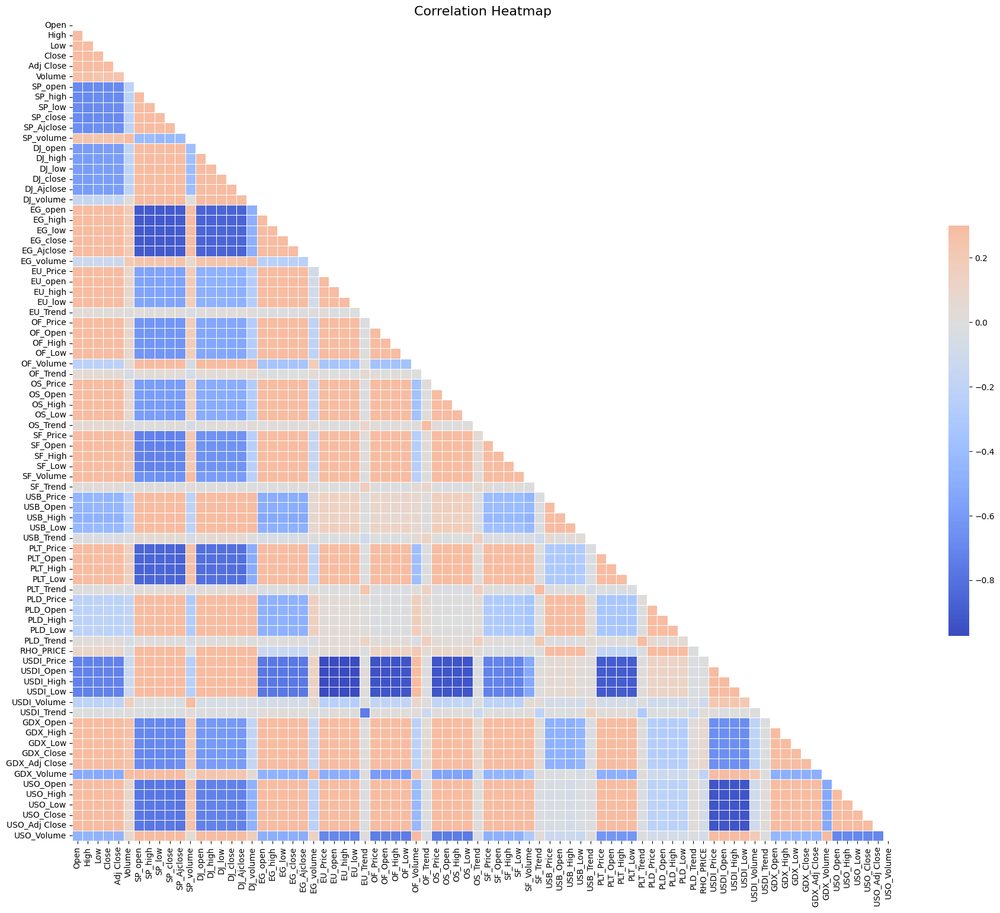

In [26]:
# Generate a Mask for the Upper Triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Plot the Correlation Heatmap
plt.subplots(figsize=(24, 18))
sns.heatmap(correlation_matrix, mask=mask, cmap='coolwarm', vmax=.3, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.title("Correlation Heatmap", fontsize=16)
plt.show()

### 4.3.3 Feature Selection to Avoid Redundancy

In [27]:
# Calculate the correlation between features in df and the target variable 'Adj Close' from target_adj_close DataFrame
correlation = gold_price.corrwith(target_adj_close['Adj Close'])

# Set the threshold for feature selection
correlation_threshold = 0.7

# Filter the features with correlation coefficient above the threshold
selected_features = correlation[correlation.abs() > correlation_threshold].index

# Select the relevant features from the original DataFrame
selected_features_df = df[selected_features]

# Print the selected features along with their column numbers
print('Selected Features:')
for i, feature in enumerate(selected_features, 1):
    print(f"Column {i}: {feature}")

Selected Features:
Column 1: Open
Column 2: High
Column 3: Low
Column 4: EG_open
Column 5: EG_high
Column 6: EG_low
Column 7: EG_close
Column 8: EG_Ajclose
Column 9: OF_Price
Column 10: OF_Open
Column 11: OF_High
Column 12: OF_Low
Column 13: SF_Price
Column 14: SF_Open
Column 15: SF_High
Column 16: SF_Low
Column 17: SF_Volume
Column 18: PLT_Price
Column 19: PLT_Open
Column 20: PLT_High
Column 21: PLT_Low
Column 22: USDI_Price
Column 23: USDI_Open
Column 24: USDI_High
Column 25: USDI_Low
Column 26: GDX_Open
Column 27: GDX_High
Column 28: GDX_Low
Column 29: GDX_Close
Column 30: GDX_Adj Close


In [28]:
# Display the selected features
print('Selected Features')
selected_features_df.head()

Selected Features


,Open,High,Low,EG_open,EG_high,EG_low,EG_close,EG_Ajclose,OF_Price,OF_Open,...,PLT_Low,USDI_Price,USDI_Open,USDI_High,USDI_Low,GDX_Open,GDX_High,GDX_Low,GDX_Close,GDX_Adj Close
Date,,,,,,,,,,,,,,,,,,,,,
2011-12-15,154.740005,154.949997,151.710007,74.550003,76.150002,72.150002,72.900002,70.431755,105.09,104.88,...,1376.85,80.341,80.565,80.630,80.130,53.009998,53.139999,51.570000,51.680000,48.973877
2011-12-16,154.309998,155.369995,153.899994,73.599998,75.099998,73.349998,74.900002,72.364037,103.35,103.51,...,1400.70,80.249,80.175,80.395,79.935,52.500000,53.180000,52.040001,52.680000,49.921513
2011-12-19,155.479996,155.860001,154.360001,69.099998,69.800003,64.199997,64.699997,62.509384,103.64,103.63,...,1404.60,80.207,80.300,80.470,80.125,52.490002,52.549999,51.029999,51.169998,48.490578
2011-12-20,156.820007,157.429993,156.580002,66.449997,68.099998,66.000000,67.000000,64.731514,106.73,104.30,...,1408.15,80.273,80.890,80.940,80.035,52.380001,53.250000,52.369999,52.990002,50.215282
2011-12-21,156.979996,157.529999,156.130005,67.099998,69.400002,66.900002,68.500000,66.180725,107.71,107.15,...,1417.65,80.350,80.105,80.445,79.550,53.150002,53.430000,52.419998,52.959999,50.186852


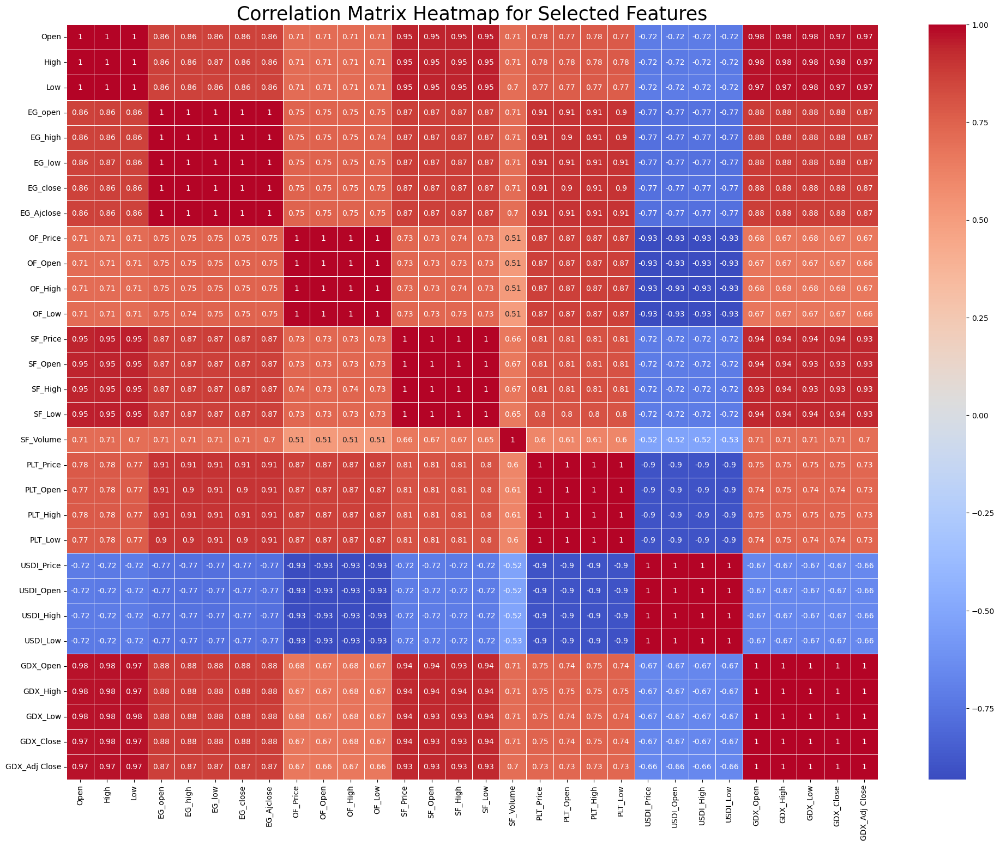

In [29]:
# Calculate the Correlation Matrix for the Selected Features
selected_features_corr = selected_features_df.corr()

# Plot the Correlation Matrix Heatmap for Selected Features
plt.figure(figsize=(24, 18))
sns.heatmap(selected_features_corr, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix Heatmap for Selected Features', fontsize=25)
plt.show()

## 4.4 Data Scaling and Normalization

In [30]:
# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the features
scaled_df = scaler.fit_transform(selected_features_df)
scaled_df = pd.DataFrame(data=scaled_df, columns=selected_features_df.columns, index=gold_price.index)

# Display the normalized DataFrame
print("Scaled DataFrame:")
scaled_df.head()

Scaled DataFrame:


,Open,High,Low,EG_open,EG_high,EG_low,EG_close,EG_Ajclose,OF_Price,OF_Open,...,PLT_Low,USDI_Price,USDI_Open,USDI_High,USDI_Low,GDX_Open,GDX_High,GDX_Low,GDX_Close,GDX_Adj Close
Date,,,,,,,,,,,,,,,,,,,,,
2011-12-15,0.744604,0.738369,0.708213,0.927031,0.937940,0.923507,0.910390,0.899367,0.785133,0.783233,...,0.645945,0.081679,0.093315,0.079047,0.080869,0.899375,0.893381,0.882804,0.871333,0.866741
2011-12-16,0.738655,0.744116,0.738341,0.914762,0.924504,0.939470,0.936364,0.925062,0.767439,0.769278,...,0.670759,0.077997,0.077795,0.069712,0.073024,0.887996,0.894269,0.893396,0.893556,0.889119
2011-12-19,0.754842,0.750821,0.744669,0.856645,0.856686,0.817746,0.803896,0.794015,0.770388,0.770500,...,0.674817,0.076317,0.082770,0.072691,0.080668,0.887773,0.880275,0.870633,0.860000,0.855329
2011-12-20,0.773381,0.772304,0.775210,0.822420,0.834933,0.841692,0.833766,0.823565,0.801810,0.777325,...,0.678510,0.078958,0.106248,0.091360,0.077047,0.885319,0.895824,0.900834,0.900444,0.896056
2011-12-21,0.775595,0.773673,0.769019,0.830815,0.851568,0.853665,0.853247,0.842836,0.811775,0.806356,...,0.688394,0.082039,0.075010,0.071698,0.057534,0.902499,0.899822,0.901961,0.899778,0.895385


# 5.0 Data Visualization

## 5.1 Range of Target Variable

In [31]:
# Find the maximum value of the Gold Price (target variable)
max_gold_price = df['Adj Close'].max()
print("Maximum Gold Price:", max_gold_price)

Maximum Gold Price: 173.610001


In [32]:
# Find the minimum value of the Gold Price (target variable)
min_gold_price = df['Adj Close'].min()
print("Minimum Gold Price:", min_gold_price)

Minimum Gold Price: 100.5


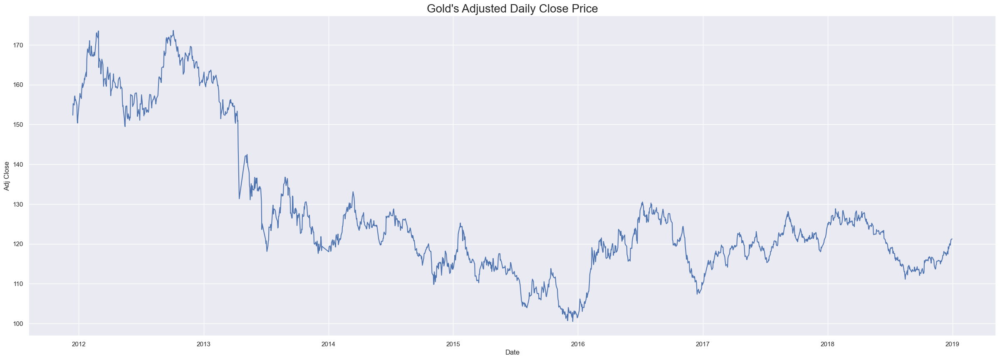

In [33]:
# Adjusted Close with Time Series
sns.set(rc={"figure.figsize":(30, 10)})
daily_change = sns.lineplot(x="Date", y="Adj Close", data=df)
daily_change.set_title("Gold's Adjusted Daily Close Price", fontsize=20)
plt.show()

## 5.2 Distribution Analysis with Histogram, Boxplot, Distplot and Lagplot

### 5.2.1 Histogram of Gold Price Data

array([[<Axes: title={'center': 'Open'}>,
        <Axes: title={'center': 'High'}>,
        <Axes: title={'center': 'Low'}>,
        <Axes: title={'center': 'Close'}>,
        <Axes: title={'center': 'Adj Close'}>,
        <Axes: title={'center': 'Volume'}>,
        <Axes: title={'center': 'SP_open'}>,
        <Axes: title={'center': 'SP_high'}>,
        <Axes: title={'center': 'SP_low'}>],
       [<Axes: title={'center': 'SP_close'}>,
        <Axes: title={'center': 'SP_Ajclose'}>,
        <Axes: title={'center': 'SP_volume'}>,
        <Axes: title={'center': 'DJ_open'}>,
        <Axes: title={'center': 'DJ_high'}>,
        <Axes: title={'center': 'DJ_low'}>,
        <Axes: title={'center': 'DJ_close'}>,
        <Axes: title={'center': 'DJ_Ajclose'}>,
        <Axes: title={'center': 'DJ_volume'}>],
       [<Axes: title={'center': 'EG_open'}>,
        <Axes: title={'center': 'EG_high'}>,
        <Axes: title={'center': 'EG_low'}>,
        <Axes: title={'center': 'EG_close'}>,
        <

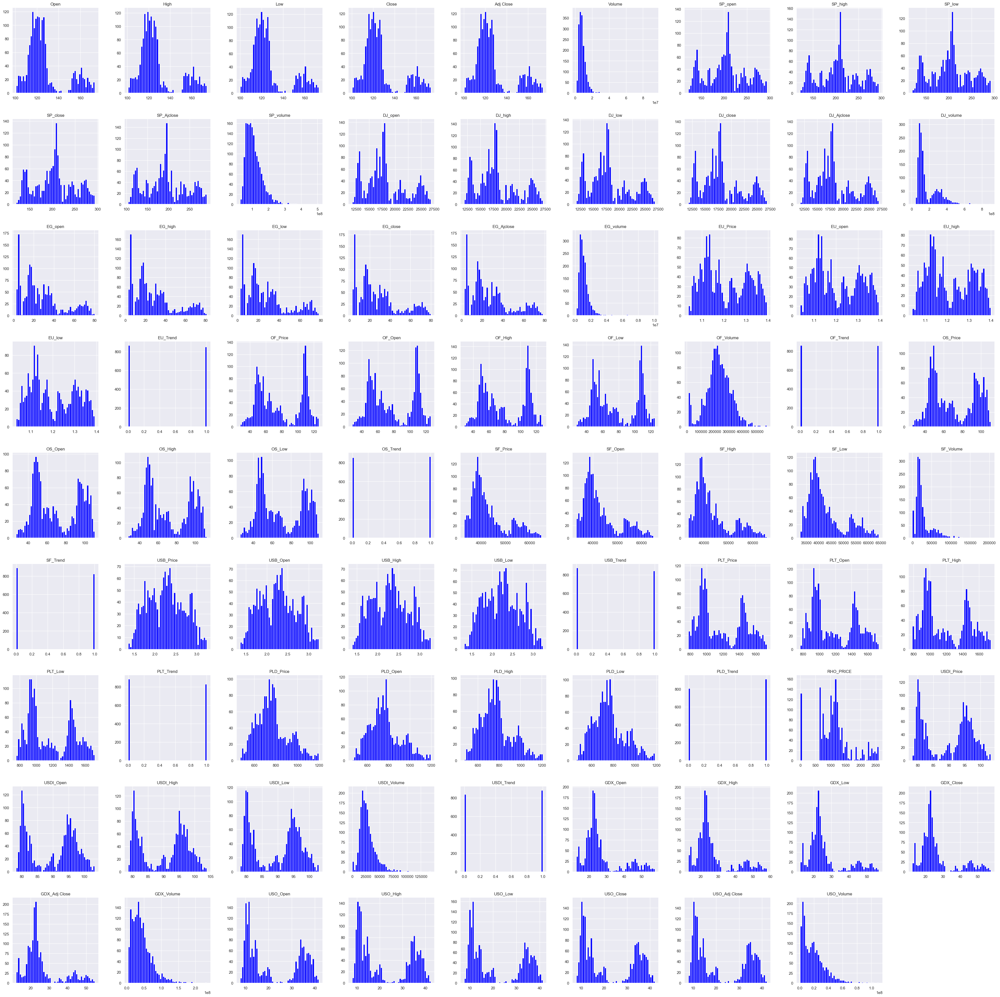

In [34]:
# Plot a histogram for each numeric column in the DataFrame 'df'
df.hist(bins=50, figsize=(50,50), color="blue")

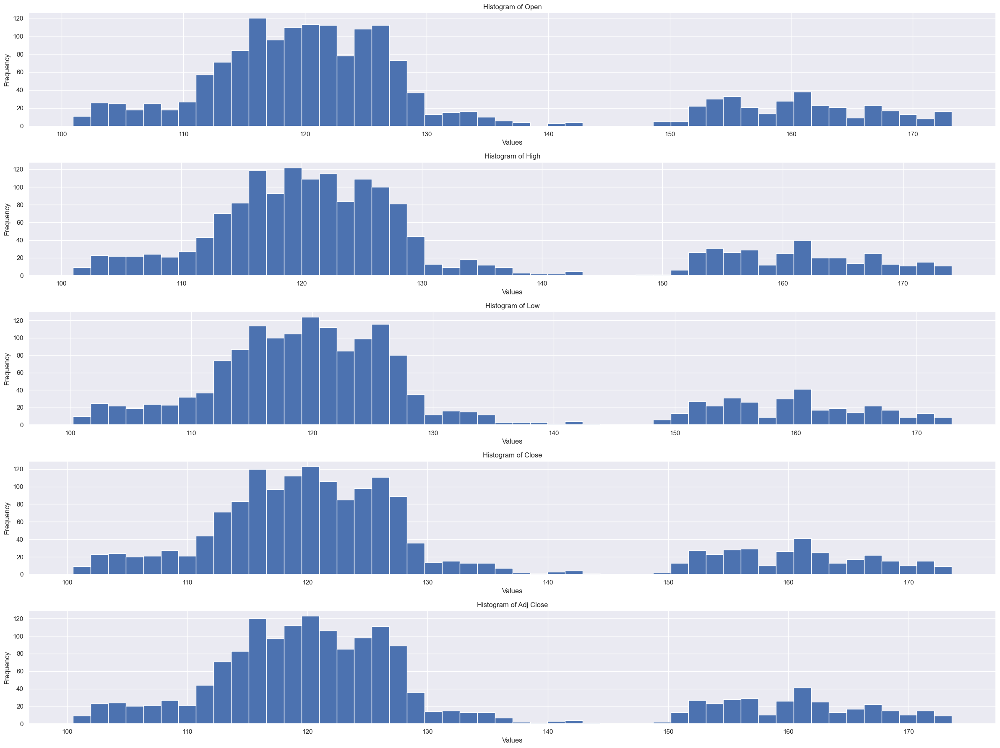

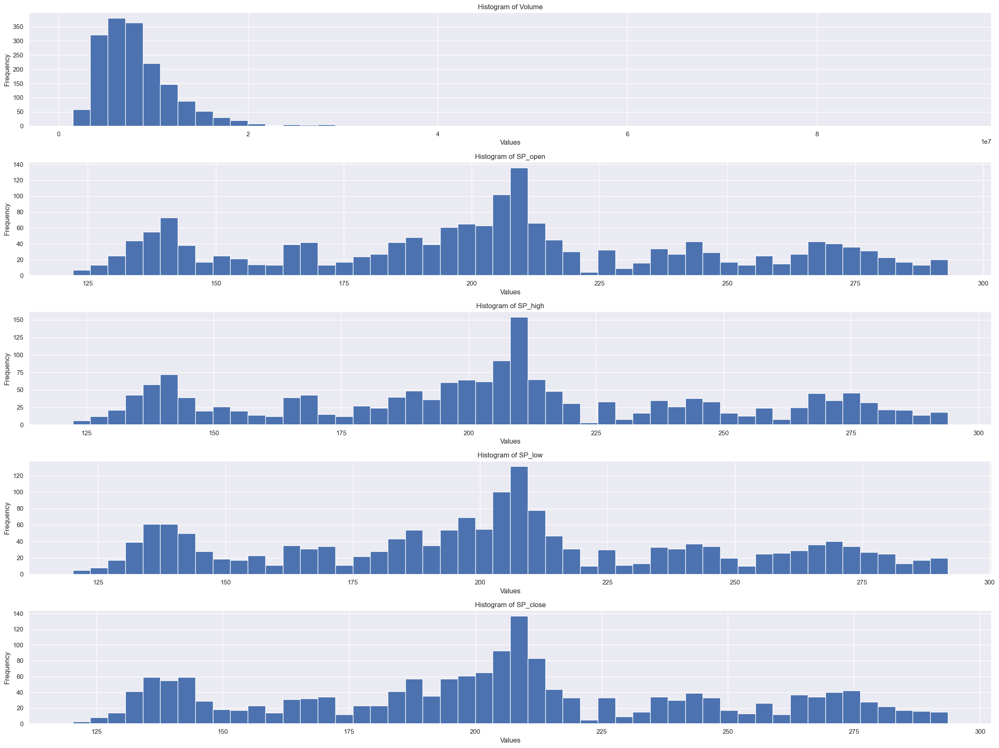

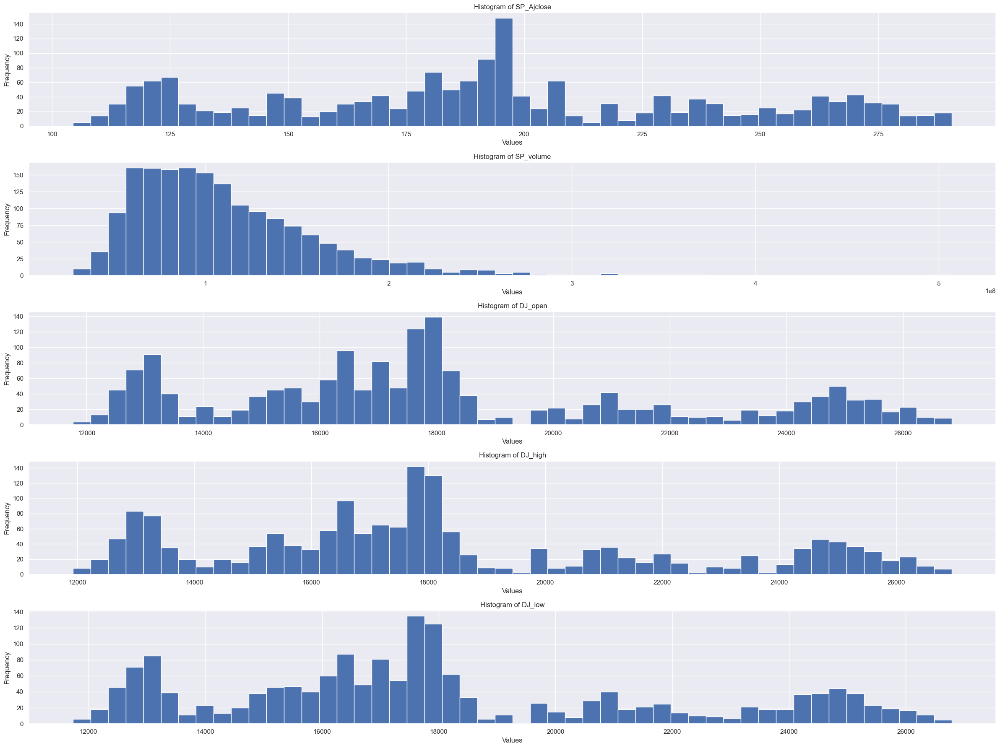

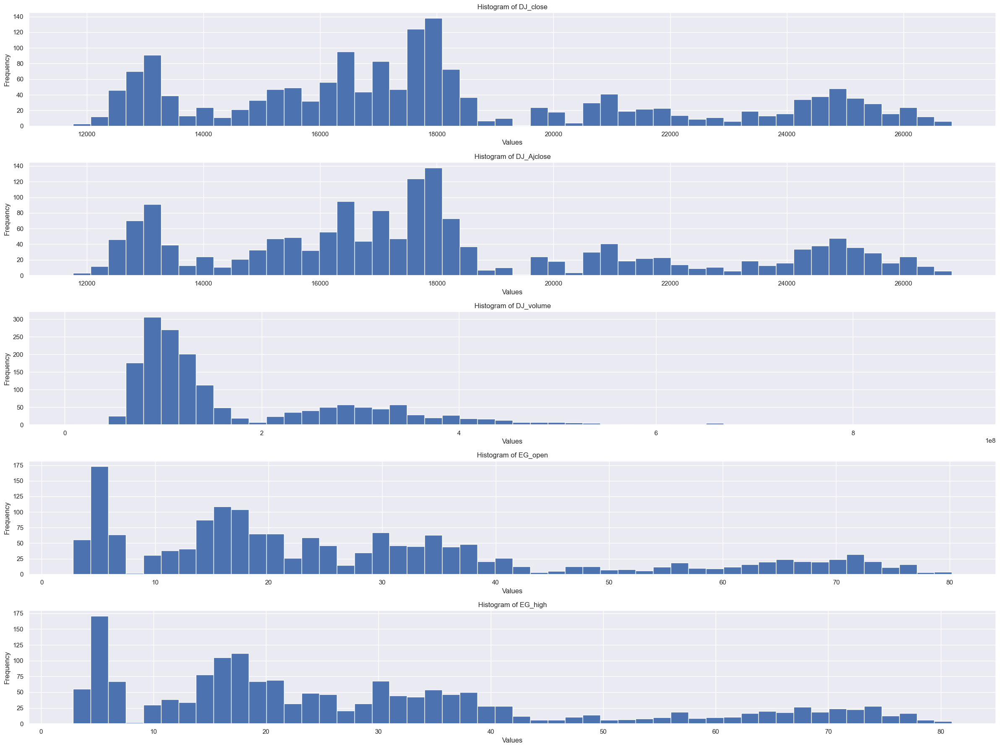

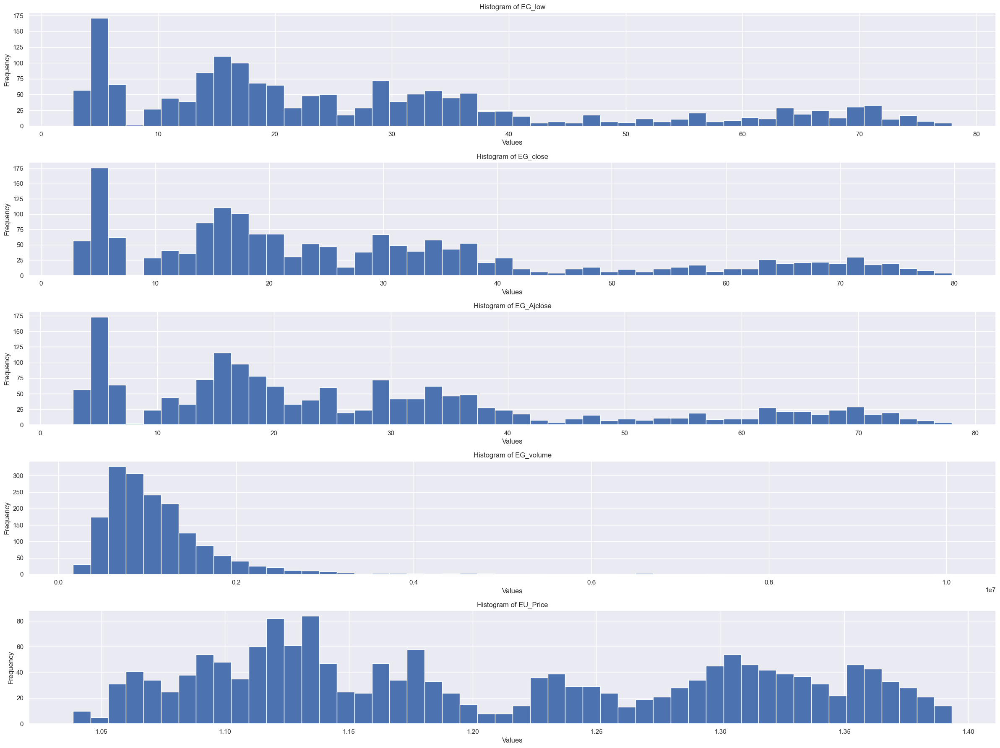

...

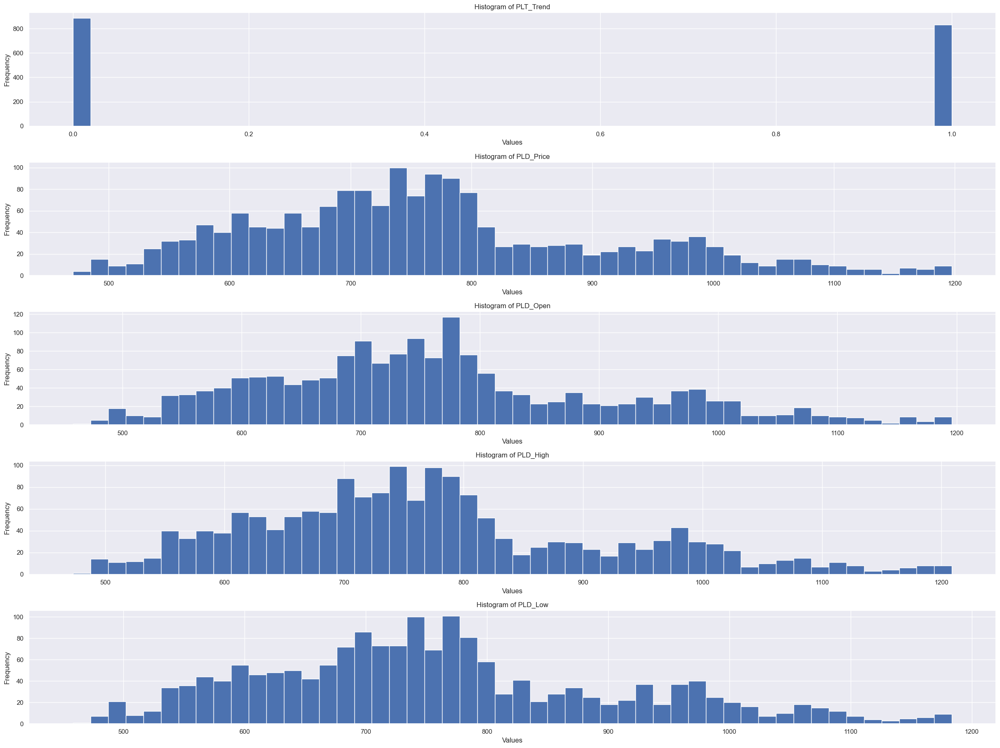

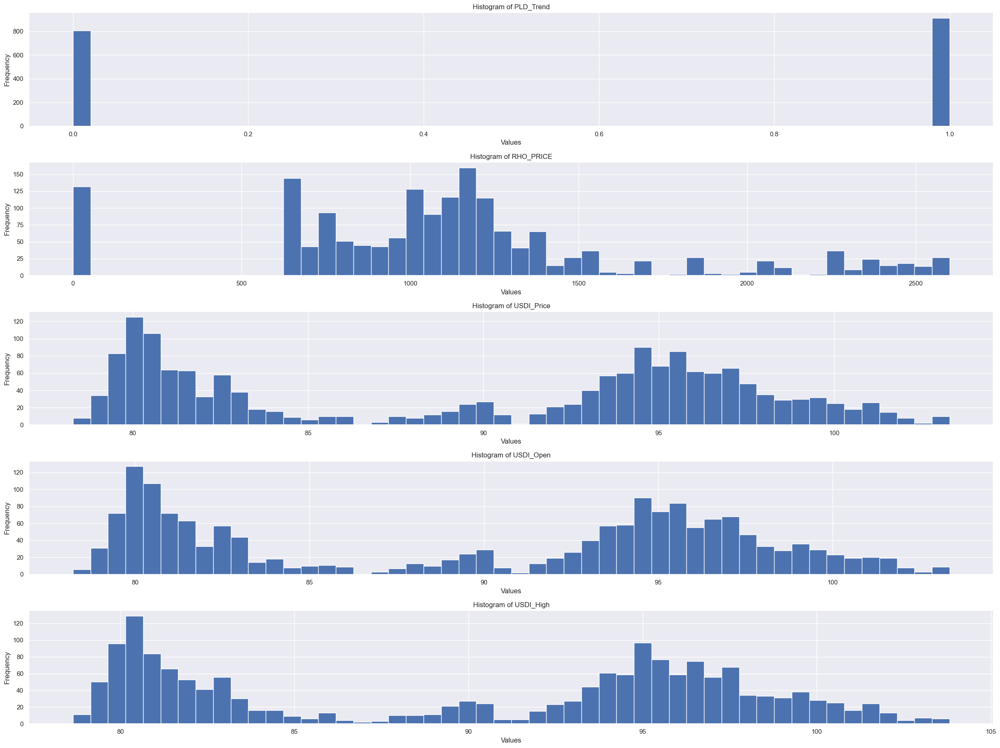

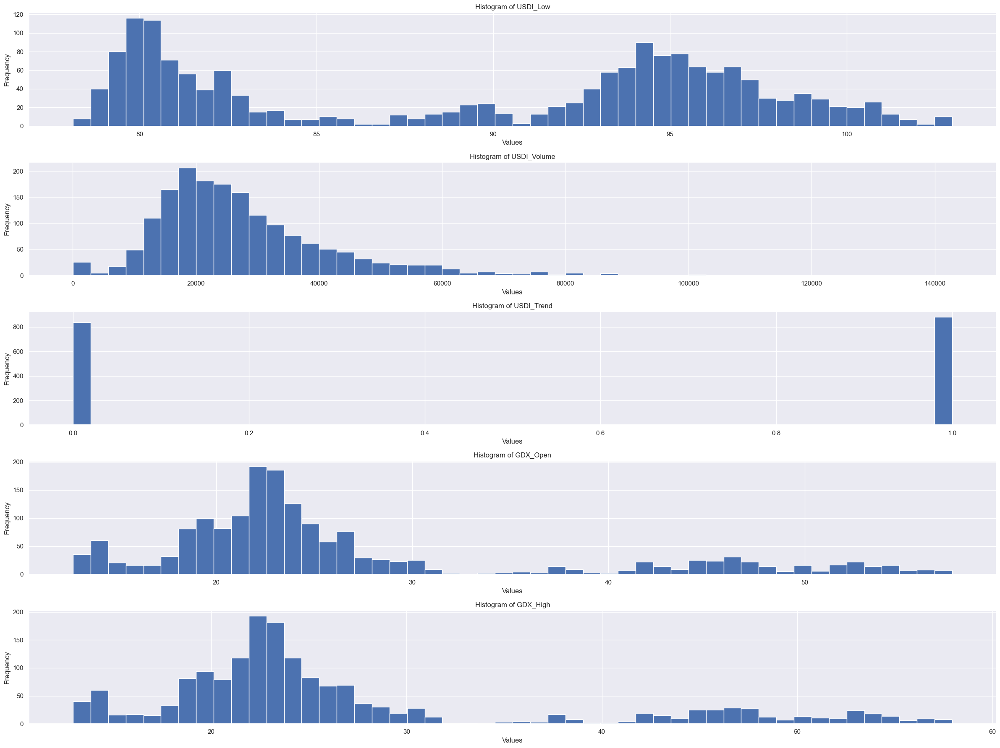

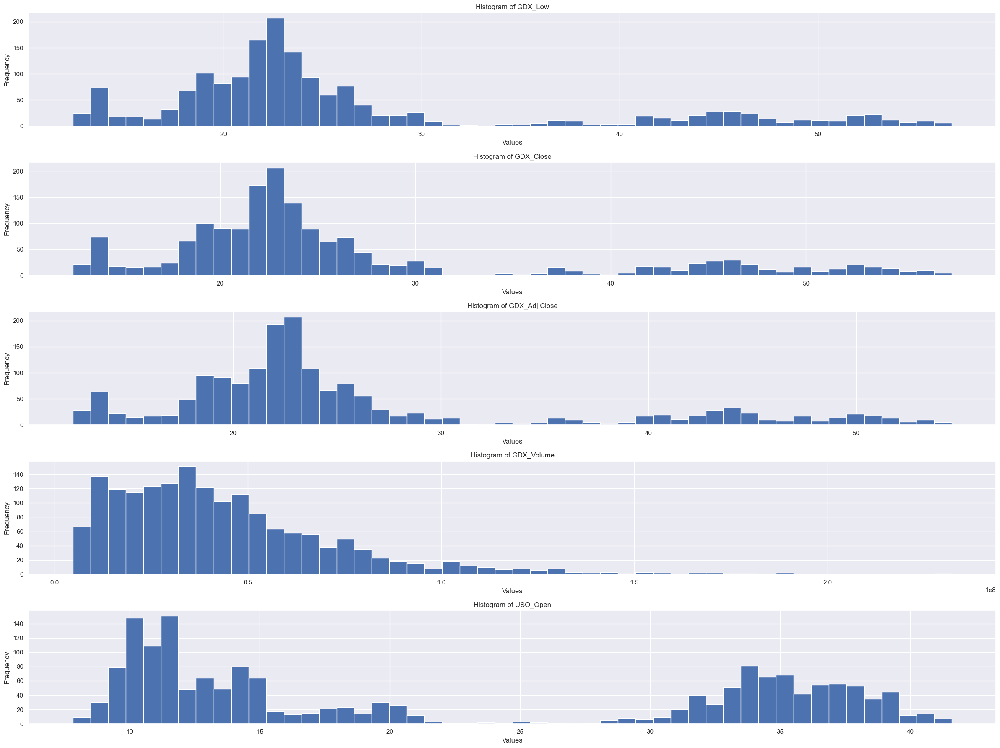

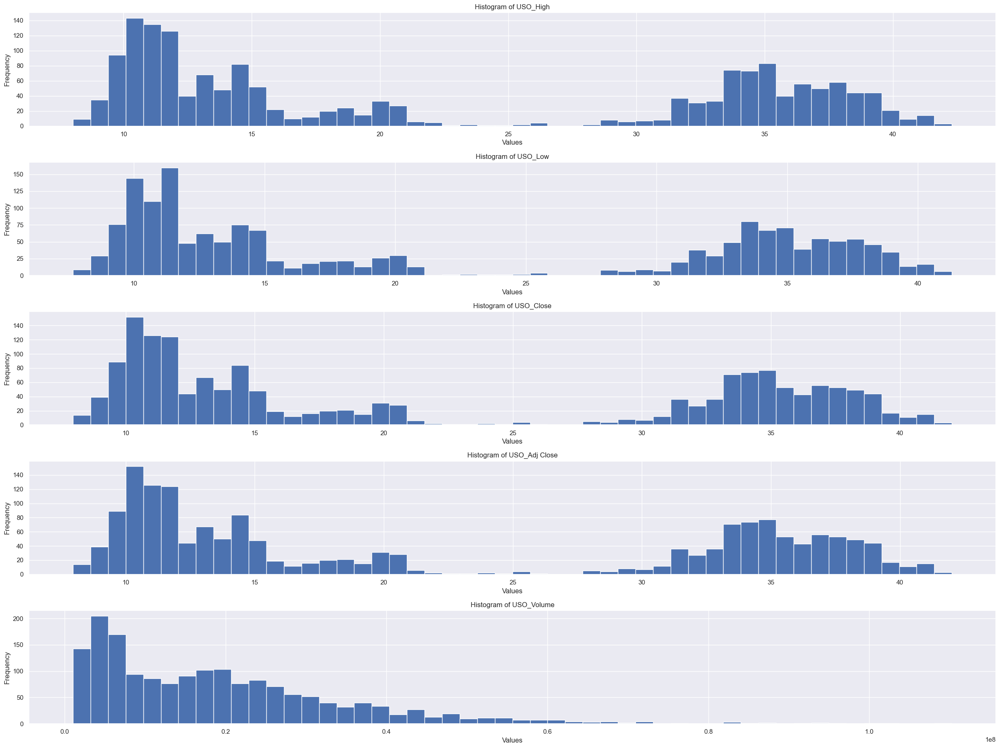

In [35]:
# Define the number of columns per plot
columns_per_plot = 5

# Calculate the number of plots required based on the number of columns
num_plots = -(-len(df.columns) // columns_per_plot)  # Ceiling division

# Plot histograms for each column over time in multiple plots
for plot_number in range(num_plots):
    start_col = plot_number * columns_per_plot
    end_col = (plot_number + 1) * columns_per_plot

    # Create a new figure for each plot
    plt.figure(figsize=(24, 18))
    
    # Select the columns for this plot
    plot_columns = df.columns[start_col:end_col]
    
    for i, column in enumerate(plot_columns):
        plt.subplot(len(plot_columns), 1, i+1)
        plt.hist(df[column], bins=50)
        plt.title(f"Histogram of {column}")
        plt.xlabel("Values")
        plt.ylabel("Frequency")

    # Display the Histogram
    plt.tight_layout()
    plt.show()

### 5.2.2 Boxplot of Gold Price Data

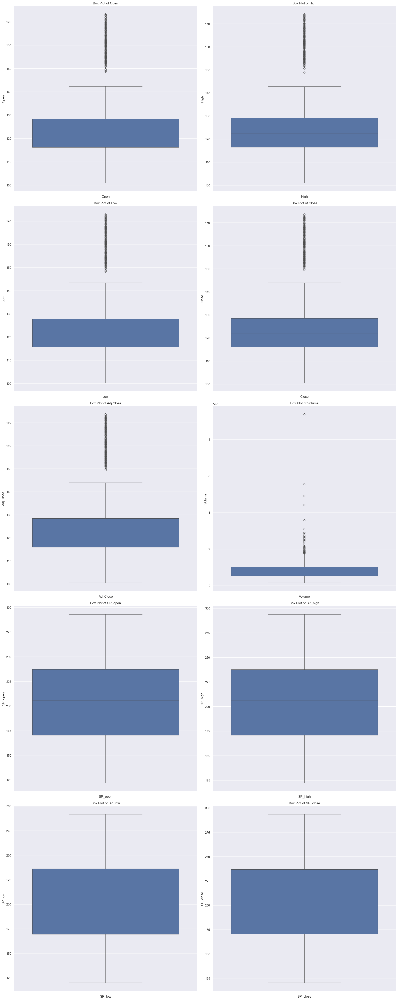

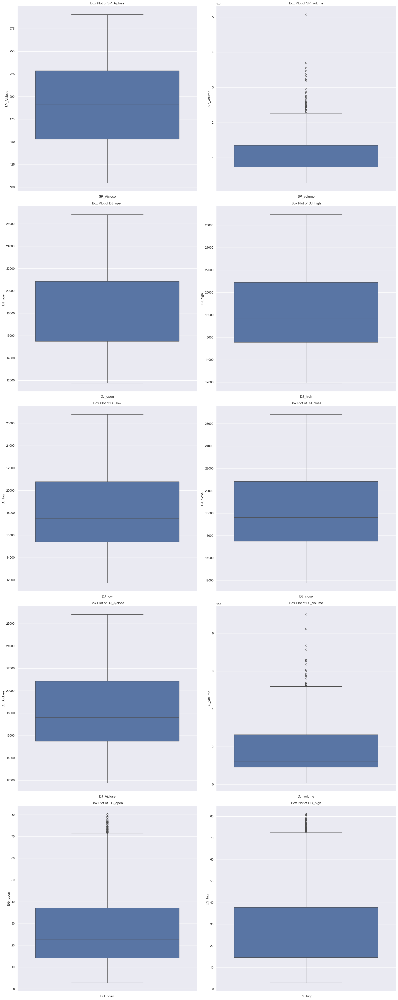

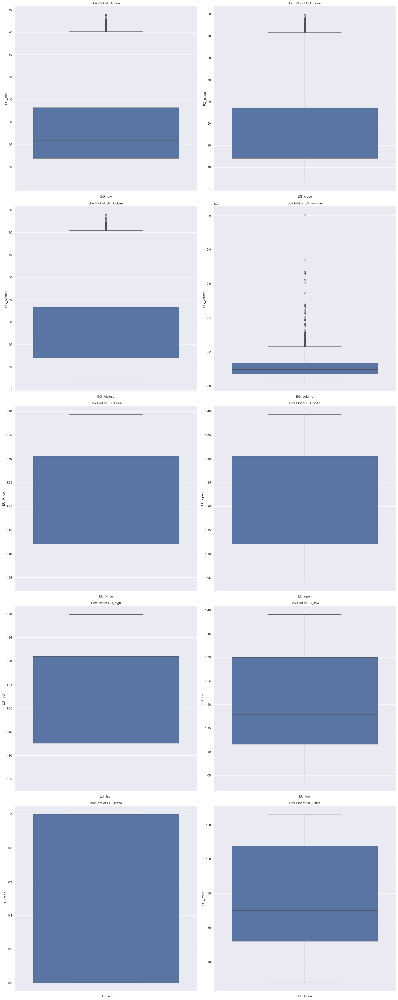

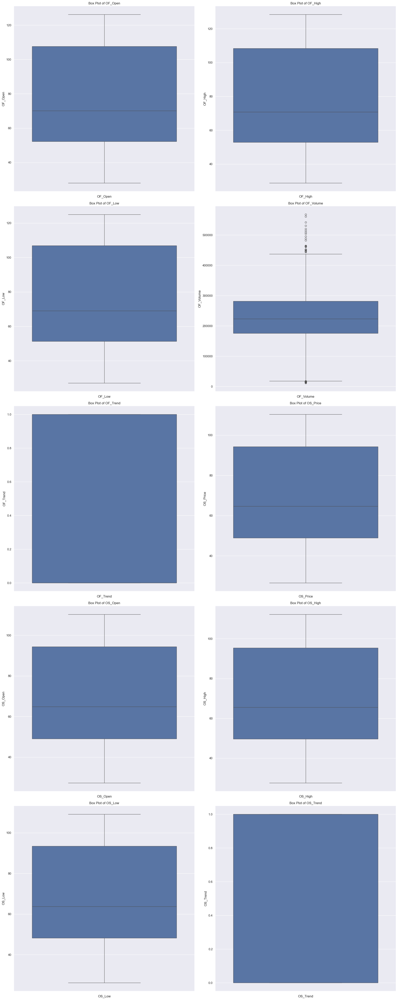

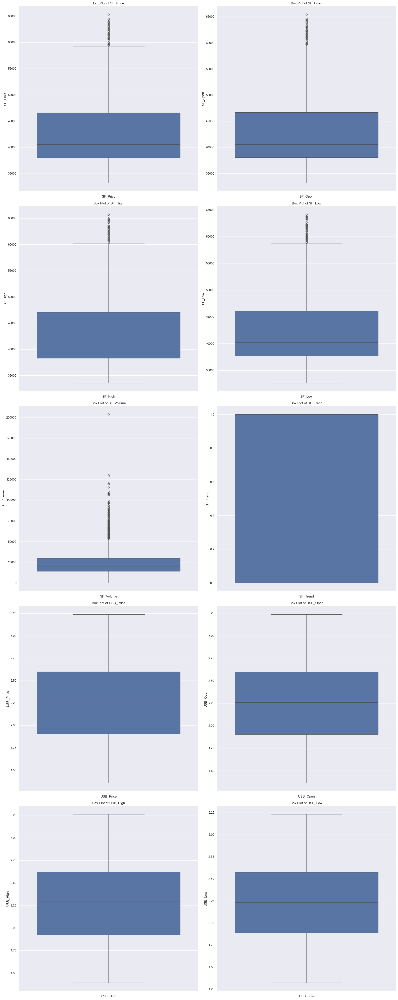

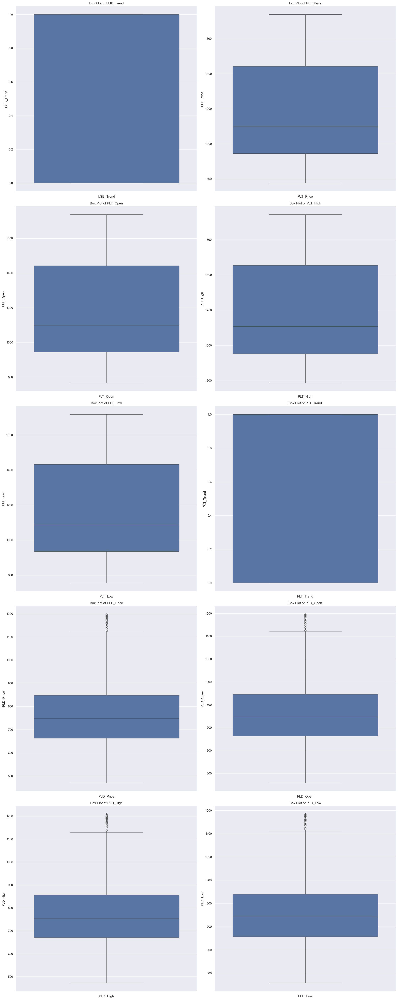

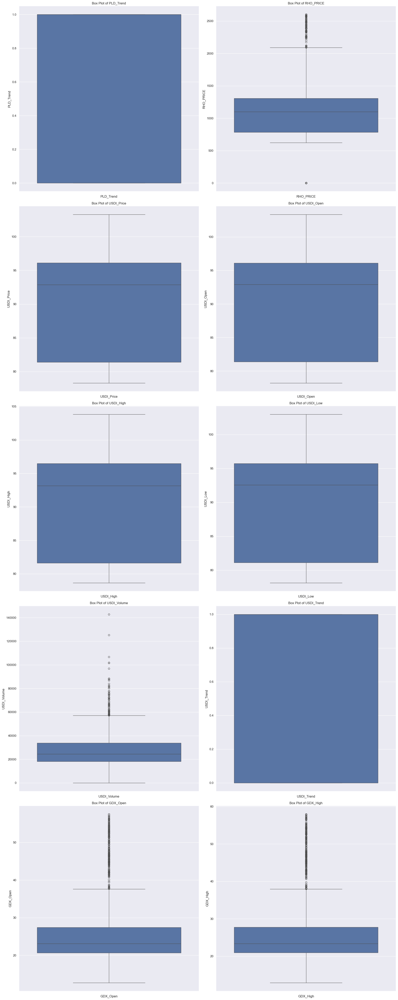

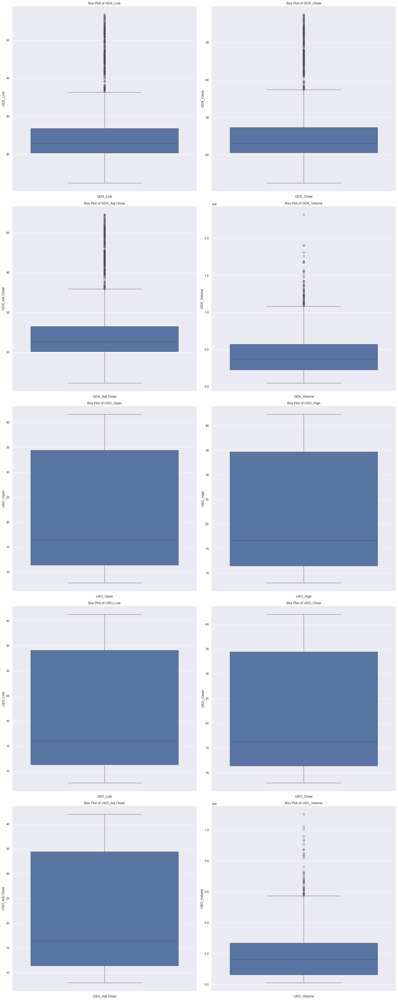

In [36]:
# Get the numeric columns (excluding non-numeric columns like 'Date')
numeric_columns = df.select_dtypes(include='number').columns

# Calculate the number of subplots required per figure
subplots_per_figure = 10

# Calculate the total number of figures required
num_figures = -(-len(numeric_columns) // subplots_per_figure) # Ceiling division

# Loop to plot box plots for each numeric column in multiple figures
for figure_num in range(num_figures):
    start_index = figure_num * subplots_per_figure
    end_index = (figure_num + 1) * subplots_per_figure

    # Create a new figure for each set of subplots
    plt.figure(figsize=(20, 50), facecolor='white')

    for i, column in enumerate(numeric_columns[start_index:end_index]):
        plt.subplot(5, 2, i + 1)
        sns.boxplot(df[column])
        plt.title(f"Box Plot of {column}")
        plt.xlabel(column)

    # Display the Box Plots
    plt.tight_layout()
    plt.show()

### 5.2.3 Distplot on Target Variable

<Figure size 1200x600 with 0 Axes>

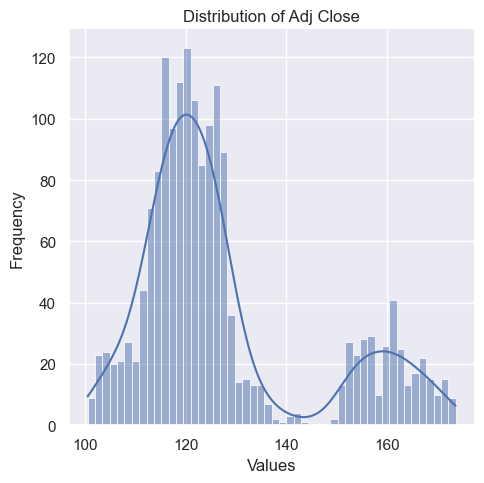

In [37]:
# Plot the displot for the 'Adj Close' column
plt.figure(figsize=(12, 6))
sns.displot(df['Adj Close'], bins=50, kde=True)  # Use displot to plot distribution with kde (Kernel Density Estimation)
plt.title("Distribution of Adj Close")
plt.xlabel("Values")
plt.ylabel("Frequency")

# Display the Displot
plt.tight_layout()
plt.show()

### 5.2.4 Lagplot on Target Variable

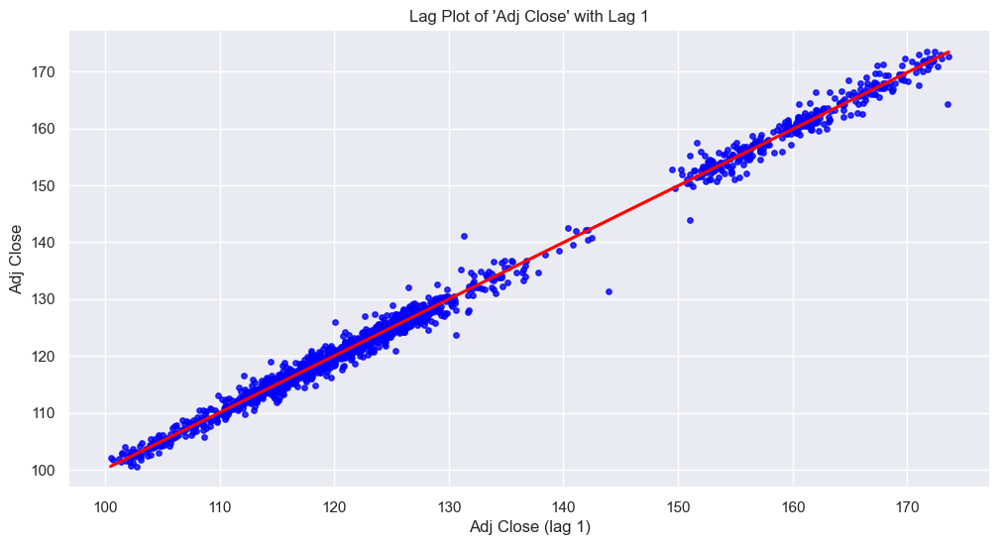

In [38]:
# Calculate the lagged 'Adj Close' values
adj_close_lag1 = df['Adj Close'].shift(1)

# Create the scatter plot with trendline
plt.figure(figsize=(12, 6))
sns.regplot(x=adj_close_lag1, y='Adj Close', data=df, color='blue', scatter_kws={'s': 15}, line_kws={'color': 'red'})
plt.title("Lag Plot of 'Adj Close' with Lag 1")
plt.xlabel("Adj Close (lag 1)")
plt.ylabel("Adj Close")
plt.grid(True)

# Display the plot
plt.show()

## 5.3 Time Series Plots to Visualize Gold Price Trends Over Time

### 5.3.1 Time Series Plots for each Variable

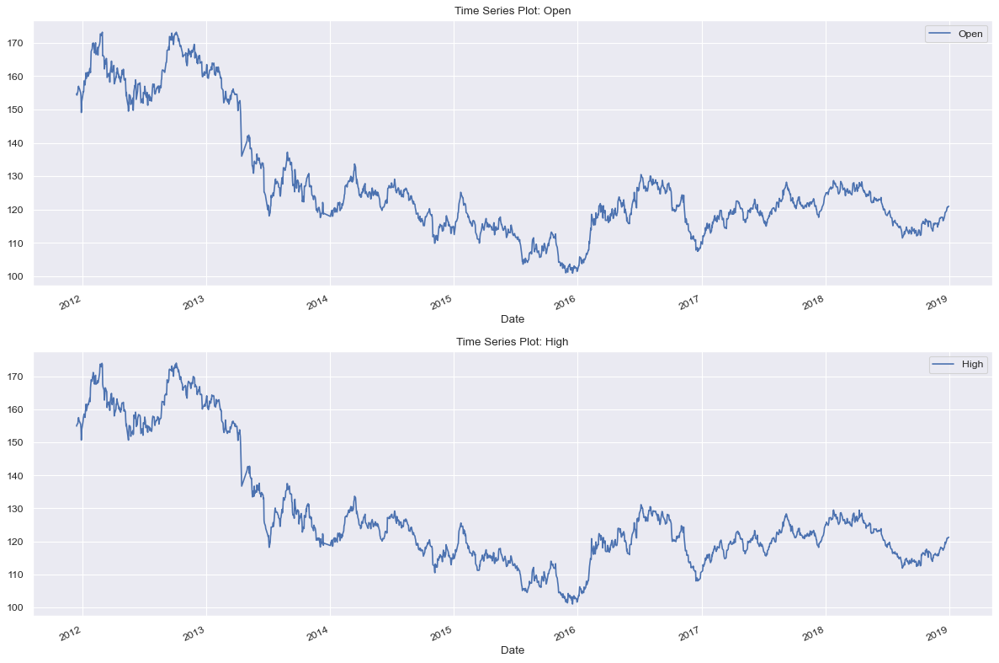

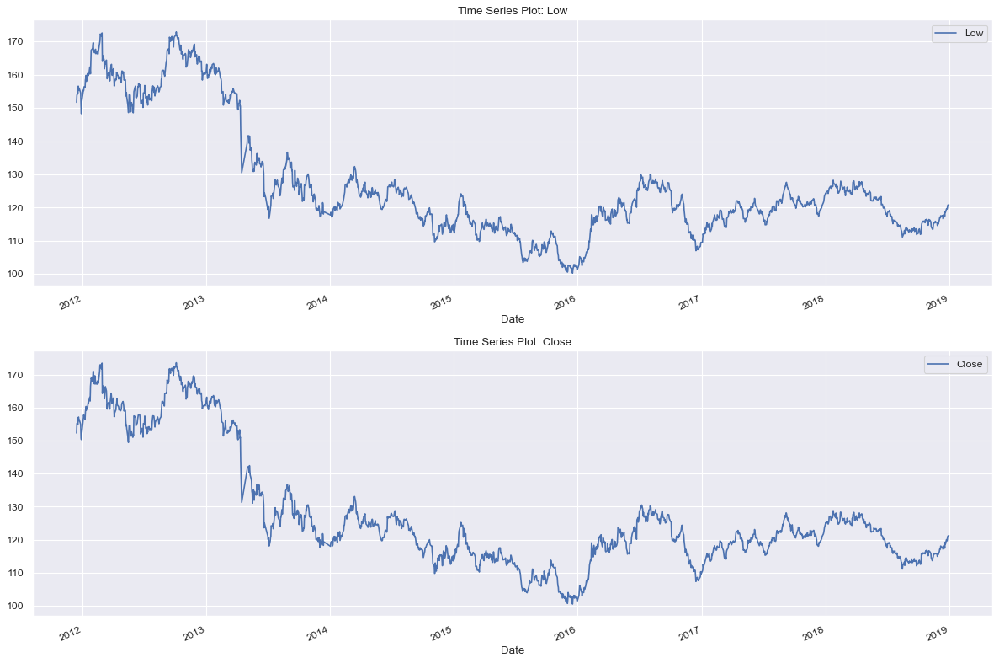

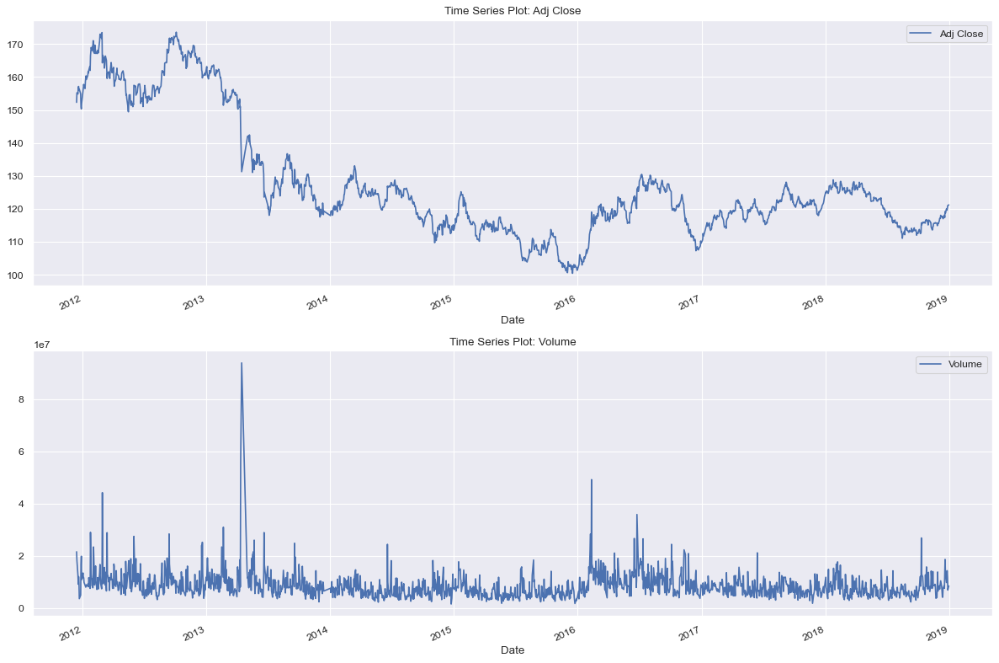

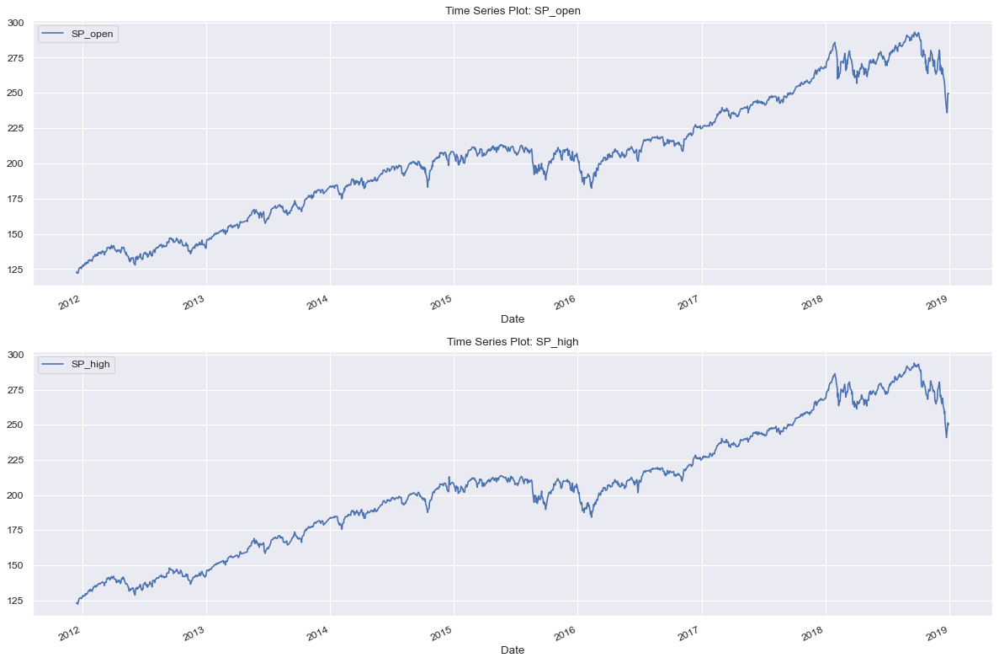

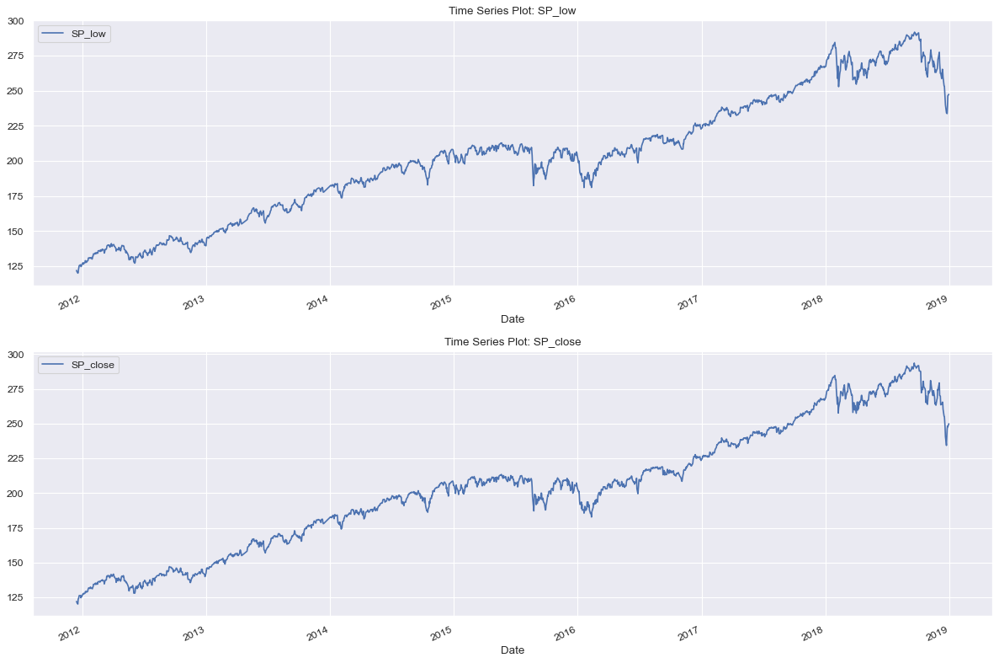

...

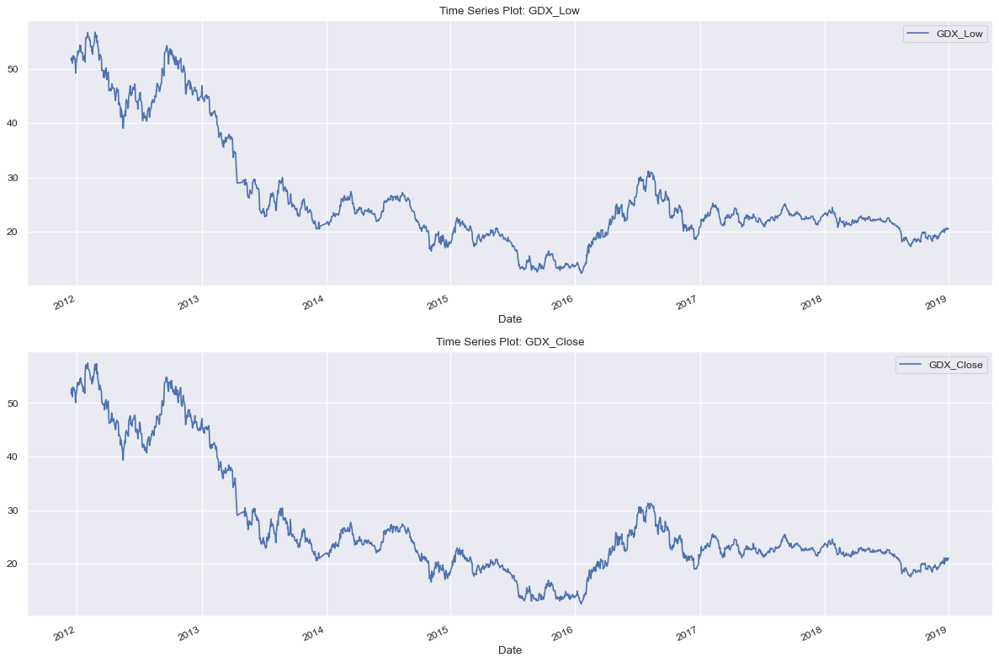

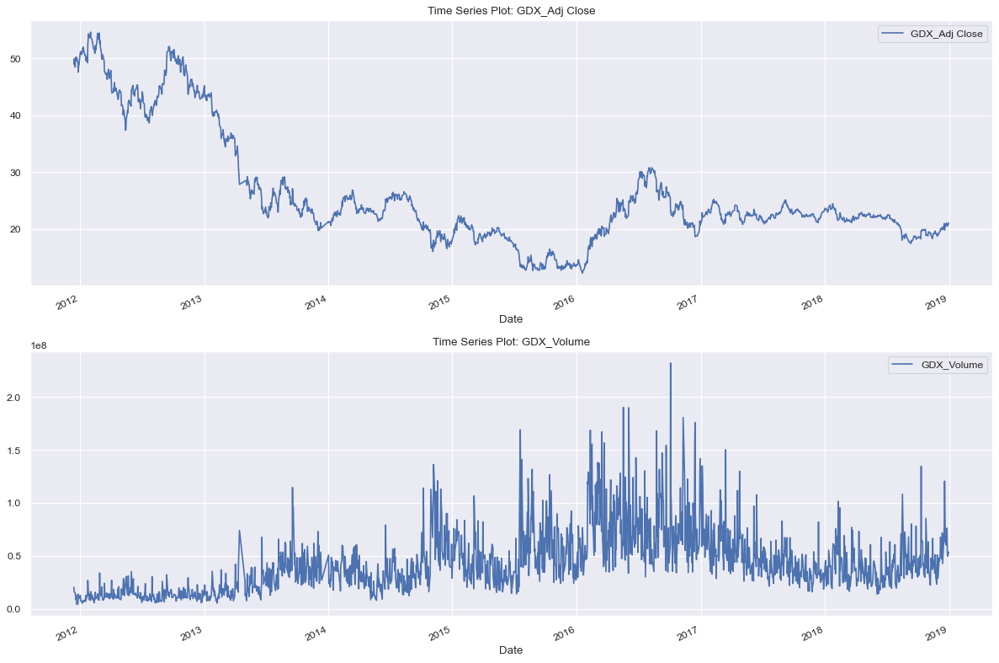

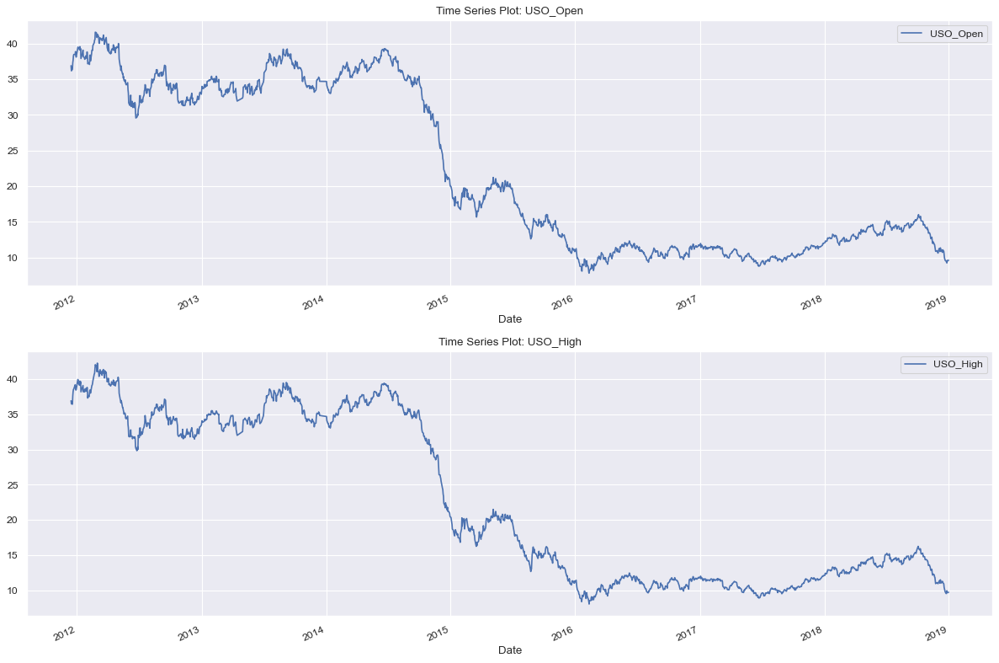

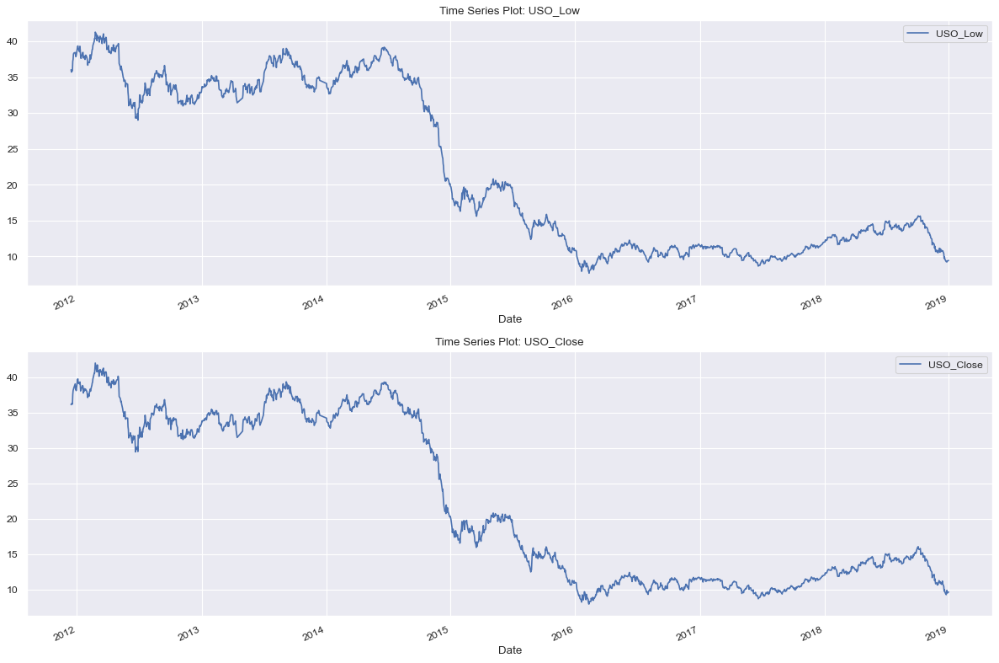

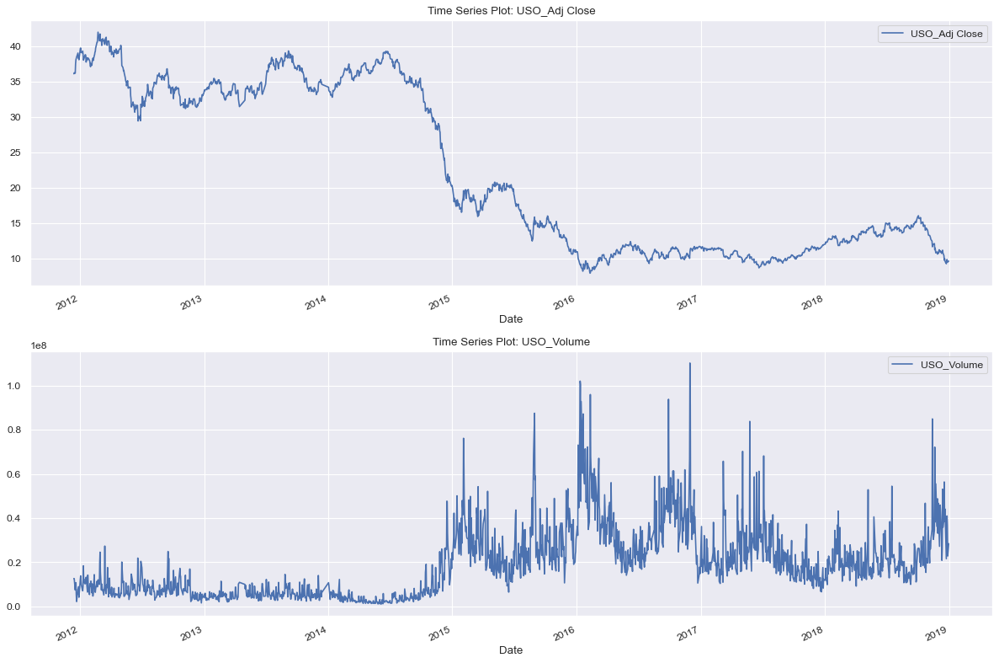

In [39]:
# Define the number of columns per plot
columns_per_plot = 2

# Calculate the number of plots required based on the number of columns
num_plots = -(-len(df.columns) // columns_per_plot)  # Ceiling division

# Plot time series for each column in multiple plots
for plot_number in range(num_plots):
    start_col = plot_number * columns_per_plot
    end_col = (plot_number + 1) * columns_per_plot

    # Create a new figure for each plot
    fig, axes = plt.subplots(nrows=columns_per_plot, ncols=1, figsize=(15, columns_per_plot * 5), dpi=80, facecolor="w", edgecolor="k")
    
    # Select the columns for this plot
    plot_columns = df.columns[start_col:end_col]
    
    for i, column in enumerate(plot_columns):
        t_data = df[column]
        ax = t_data.plot(ax=axes[i], title=f"Time Series Plot: {column}", rot=25)
        ax.legend([column])

    # Adjust the layout to prevent overlapping of subplots
    plt.tight_layout()

    # Display the Time Series Plots
    plt.show()

### 5.3.2 Time Series Plots to Analyze Price Fluctuations and Volatility of Gold Prices

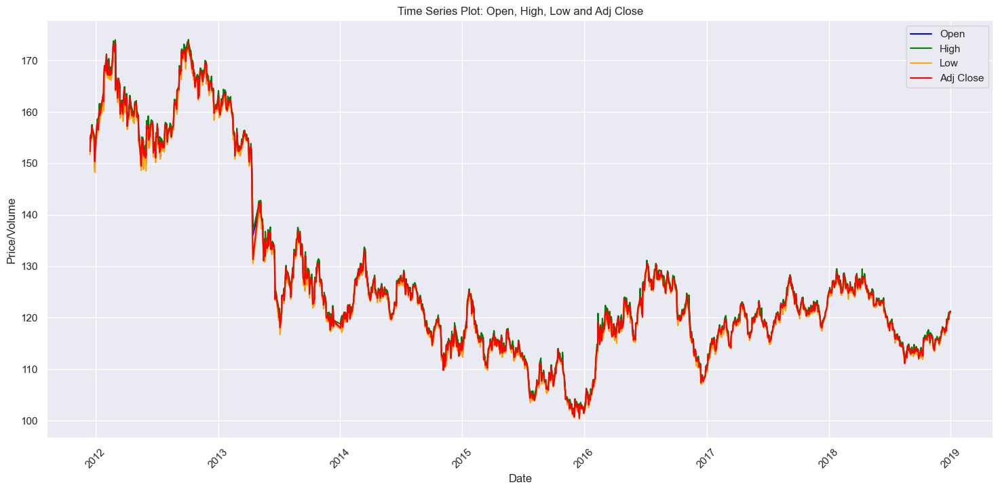

In [40]:
# Plot the time series for 'Open', 'High', 'Low', 'Volume', and 'Adj Close' variables
plt.figure(figsize=(18, 8))
plt.plot(df['Open'], label='Open', color='blue')
plt.plot(df['High'], label='High', color='green')
plt.plot(df['Low'], label='Low', color='orange')
plt.plot(df['Adj Close'], label='Adj Close', color='red')

plt.title("Time Series Plot: Open, High, Low and Adj Close")
plt.xlabel("Date")
plt.ylabel("Price/Volume")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)

# Display the Time Series Plot
plt.show()

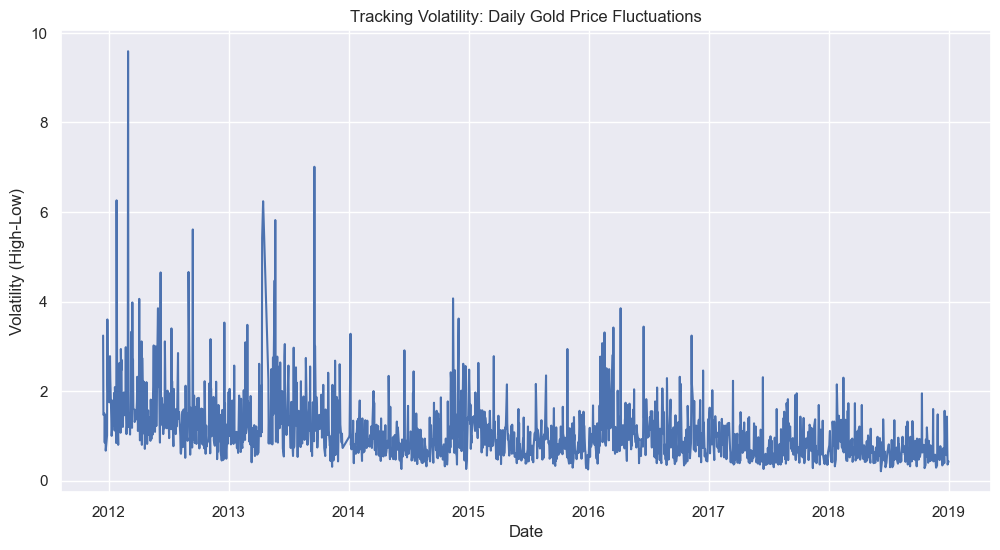

In [41]:
# Daily Change for Gold
daily_change = abs(df['High'] - df['Low'])

# Visualize the Volatility of Daily Gold Prices
plt.figure(figsize=(12,6))
plt.plot(daily_change)
plt.title("Tracking Volatility: Daily Gold Price Fluctuations")
plt.xlabel("Date")
plt.ylabel("Volatility (High-Low)")
plt.show()

## 5.4 Seasonal Decomposition of Time Series (STL)

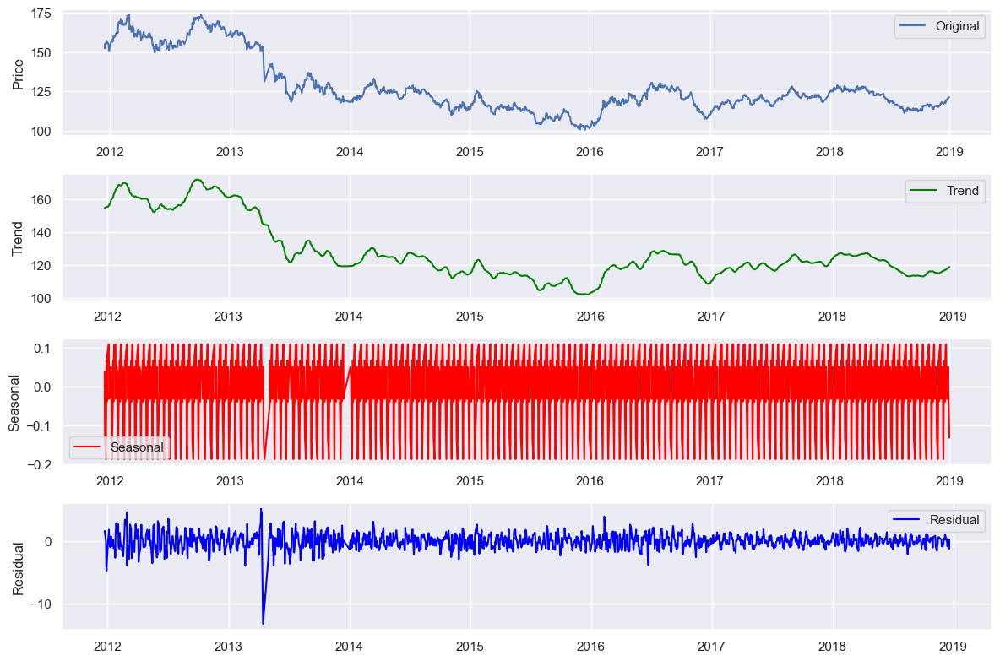

In [42]:
# Perform seasonal decomposition
decomposition = seasonal_decompose(df['Adj Close'], model='additive', period=12)

# Plot the components
plt.figure(figsize=(12, 8))

# Original time series
plt.subplot(4, 1, 1)
plt.plot(df['Adj Close'], label='Original')
plt.legend()
plt.ylabel('Price')

# Trend component
plt.subplot(4, 1, 2)
plt.plot(decomposition.trend, label='Trend', color='green')
plt.legend()
plt.ylabel('Trend')

# Seasonal component
plt.subplot(4, 1, 3)
plt.plot(decomposition.seasonal, label='Seasonal', color='red')
plt.legend()
plt.ylabel('Seasonal')

# Residual component
plt.subplot(4, 1, 4)
plt.plot(decomposition.resid, label='Residual', color='blue')
plt.legend()
plt.ylabel('Residual')

plt.tight_layout()
plt.show()

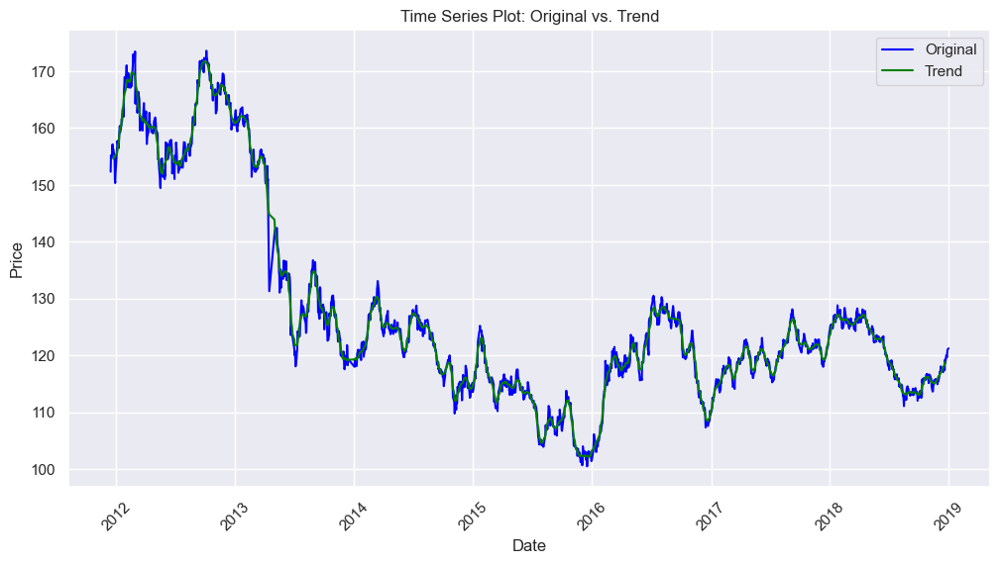

In [43]:
# Perform seasonal decomposition
decomposition = seasonal_decompose(df['Adj Close'], model='additive', period = 12)

# Plot the original time series and the trend component together
plt.figure(figsize=(12, 6))

# Original time series
plt.plot(df['Adj Close'], label='Original', color='blue')

# Trend component
plt.plot(decomposition.trend, label='Trend', color='green')

plt.title("Time Series Plot: Original vs. Trend")
plt.xlabel("Date")
plt.ylabel("Price")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

## 5.5 Bar Plot of the Yearly Mean 'Adj Close' Prices

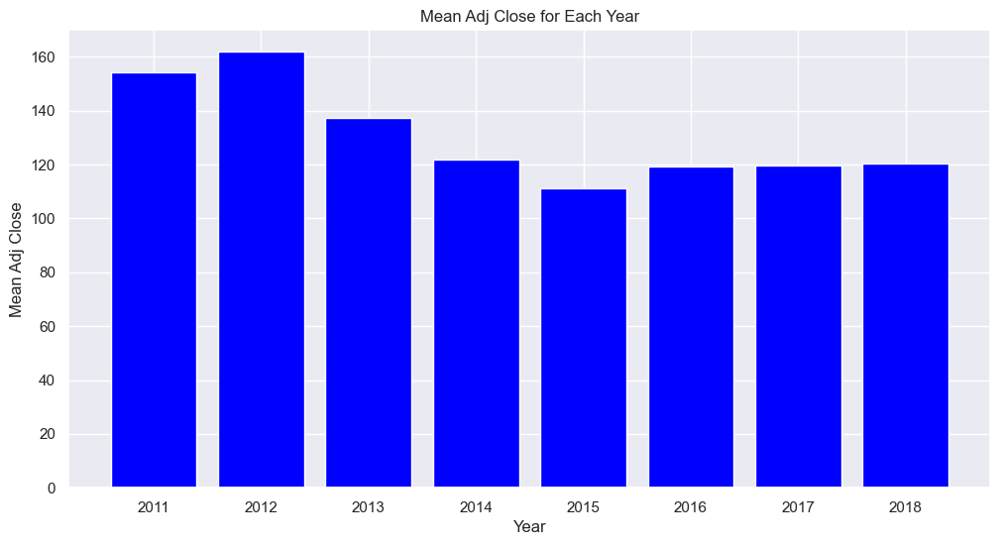

In [44]:
# Group the DataFrame by year and calculate the mean for each year
yearly_mean_adj_close = df.resample('Y')['Adj Close'].mean()


plt.figure(figsize=(12, 6))
plt.bar(yearly_mean_adj_close.index.year, yearly_mean_adj_close, color='blue')
plt.xlabel('Year')
plt.ylabel('Mean Adj Close')
plt.title('Mean Adj Close for Each Year')
plt.grid(True)

# Display the bar plot
plt.show()

# 6.0 Data Splitting

In [45]:
# Perform time series cross-validation using TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=10)

# Iterate over the splits and get the train-test indices
for train_index, test_index in tscv.split(scaled_df):
        X_train, X_test = scaled_df[:len(train_index)], scaled_df[len(train_index): (len(train_index)+len(test_index))]
        y_train, y_test = target_adj_close[:len(train_index)].values.ravel(), target_adj_close[len(train_index): (len(train_index)+len(test_index))].values.ravel()

In [46]:
X_train.shape

(1562, 30)

In [47]:
X_test.shape

(156, 30)

In [48]:
y_train.shape

(1562,)

In [49]:
y_test.shape

(156,)

# 7.0 Model Building, Training and Testing

In [50]:
# Set the time_steps to weekly
time_steps = 5

# Function to create dataset with sequences
def create_dataset(X, y, time_steps):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        v = X[i:(i + time_steps)].values if hasattr(X, 'iloc') else X[i:(i + time_steps)]
        Xs.append(v)
        target = y.iloc[i + time_steps] if hasattr(y, 'iloc') else y[i + time_steps]
        ys.append(target)
    return np.array(Xs), np.array(ys)

In [51]:
# Function to get the time of the models from a CSV file
def get_model_performance(model_name):
    with open('training_performance.csv', mode='r') as f:
        reader = csv.reader(f)
        for row in reader:
            if row and row[0] == model_name:
                return row[1]  # Return the formatted time string directly
    return None

In [52]:
# Function to check if there is existing data stored in local .csv file for the model
def check_model_performance_exists(model_name, file_name='training_performance.csv'):
    try:
        with open(file_name, mode='r') as csvfile:
            reader = csv.reader(csvfile)
            for row in reader:
                if row and row[0] == model_name:
                    return True
    except FileNotFoundError:
        # If the file does not exist, no data exists for any model
        return False
    return False

In [53]:
# Function to store the time of the hyperparameter tuned models stored in local .csv file
def store_performance(model_name, elapsed_time, file_name='training_performance.csv'):
    
    # Check if the model's performance data already exists
    if not check_model_performance_exists(model_name, file_name):
        
        # If it doesn't exist, append the new data
        with open(file_name, 'a', newline='') as f:
            writer = csv.writer(f)
            writer.writerow([model_name, elapsed_time])
    else:
        print(f"Performance data for {model_name} already exists.\n")

In [54]:
# Function to handle the hyperparameter tuning process
def train_model(model, X_train, y_train, X_test, y_test):  
    
    # Start timing monitoring
    start_time = time.time()
    
    # Train the model
    history = model.fit(
        X_train, y_train,
        batch_size=32,
        epochs=100,
        validation_data=(X_test, y_test),
        shuffle=False
    )
    
    # End timing monitoring
    end_time = time.time()
    training_time = end_time - start_time
    
    # Predict
    y_pred_test = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    
    # Return the model's history, training time, and predictions
    return history, training_time, y_pred_train, y_pred_test

In [55]:
def tune_hyperparameters(X_train, y_train, X_test, y_test, build_model_function, project_name='project', checkpoint_name='model_checkpoint'):
    
    # Start timing monitoring
    start_time = time.time()

    fixed_input_shape = (X_train.shape[1], X_train.shape[2])
    partial_model_builder = partial(build_model_function, input_shape=fixed_input_shape)

    # Initialize the Bayesian Optimization Tuner
    tuner = BayesianOptimization(
        partial_model_builder,
        objective='val_loss',
        max_trials=10,
        executions_per_trial=1,
        directory='hyperparameter_tuning',
        project_name=project_name
    )

    # Search for the Best Hyperparameters
    tuner.search(X_train, y_train, 
                 epochs=100, 
                 validation_data=(X_test, y_test), 
                 batch_size=32)

    # End timing monitoring
    end_time = time.time()
    training_time = end_time - start_time

    # Retrieve the Best Model and Hyperparameter
    best_model = tuner.get_best_models(num_models=1)[0]
    best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

    # Save Checkpoint
    checkpoint = tf.train.Checkpoint(best_model)
    save_path = checkpoint.save(f"/tmp/training_checkpoints_{checkpoint_name}")
    checkpoint.restore(save_path)

    # Use the Best Model for Prediction and Evaluation
    test_pred = best_model.predict(X_test)
    train_pred = best_model.predict(X_train)

    # Return the best model, best hyperparameters, training time, and predictions
    return best_model, best_hyperparameters, tuner, training_time, test_pred, train_pred

In [56]:
def summarize_model_performance(model, tuner, X_train, y_train, X_test, y_test, model_save_path):
    
    # Evaluate the model on the training and testing set
    train_loss = model.evaluate(X_train, y_train, verbose=0)
    test_loss = model.evaluate(X_test, y_test, verbose=0)

    # Display the training and testing set loss
    print(colored(f"Loss on training set:", attrs=["bold", "dark"]), train_loss)
    print(colored(f"Loss on test set:", attrs=["bold", "dark"]), test_loss, "\n")

    # Displaying the Best Hyperparameters
    best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]
    print(colored("Best Hyperparameter Values:", attrs=["bold", "dark"]), best_hyperparameters.values, "\n")

    # Display Tuner's Results Summary
    tuner.results_summary()

    # Save the best model
    model.save(f"saved_models/{model_save_path}")

    # Load and summarize the model
    loaded_model = tf.keras.models.load_model(f"saved_models/{model_save_path}")
    print(colored("\nBest Model Summary:", attrs=["bold", "dark"]))
    loaded_model.summary()

In [57]:
def evaluate_and_plot_results(model_name, history, training_time, y_train, y_test, train_pred, test_pred, title_suffix='', is_tuned=False):

    # Check if the model is tuned and handle the training time accordingly
    if is_tuned:
        # Get the formatted time from the CSV file for a specific model
        formatted_time = get_model_performance(model_name)

        # Check if the formatted_time exists; if not, calculate and store it
        if not formatted_time:
            # Convert seconds to minutes and seconds
            minutes, seconds = divmod(training_time, 60)
            formatted_time = "{} minutes and {:.2f} seconds".format(int(minutes), seconds)

            # Store the performance data in CSV if not already present
            store_performance(model_name, formatted_time)

    else:
        # Convert seconds to minutes and seconds for non-tuned models
        minutes, seconds = divmod(training_time, 60)
        formatted_time = "{} minutes and {:.2f} seconds".format(int(minutes), seconds)

    # Calculate metrics for the training set
    train_r2 = r2_score(y_train, train_pred)
    train_mae = mean_absolute_error(y_train, train_pred)
    train_rmse = np.sqrt(mean_squared_error(y_train, train_pred))
    train_mape = mean_absolute_percentage_error(y_train, train_pred) * 100

    # Calculate and print metrics
    elapsed_times.append(formatted_time)
    r2_scores.append(r2_score(y_test, test_pred))
    maes.append(mean_absolute_error(y_test, test_pred))
    rmses.append(np.sqrt(mean_squared_error(y_test, test_pred)))
    mapes.append(mean_absolute_percentage_error(y_test, test_pred) * 100)
    
    print(colored(f"Time Measurement and Monitoring for {model_name} {title_suffix}", attrs=["bold", "dark"]))
    print("Training time:", elapsed_times[-1])
    
    # Print training metrics
    print(colored(f"\nTraining Evaluation Metrics for {model_name} {title_suffix}", attrs = ["bold", "dark"]))
    print("Training R2 Score:", train_r2)
    print("Training Mean Absolute Error (MAE):", train_mae)
    print("Training Root Mean Squared Error (RMSE):", train_rmse)
    print("Training Mean Absolute Percentage Error (MAPE):", train_mape, "%")

    # Print metrics
    print(colored(f"\nTesting Evaluation Metrics for {model_name} {title_suffix}", attrs = ["bold", "dark"]))
    print("R2 Score:", r2_scores[-1])
    print("Mean Absolute Error (MAE):", maes[-1])
    print("Root Mean Squared Error (RMSE):", rmses[-1])
    print("Mean Absolute Percentage Error (MAPE):", mapes[-1], "%")

    # Plot actual vs predicted for all splits combined
    plt.figure(figsize=(24, 12))
    plt.style.use('seaborn-v0_8')
    plt.plot(y_test, label='Actual', color='blue')
    plt.plot(test_pred, label='Predicted', color='red')
    plt.title(f'{model_name} {title_suffix} Gold Price Prediction', fontsize=20)
    plt.xlabel('Date')
    plt.ylabel('Gold Price')
    plt.legend()
    plt.show()
    
    # If history is provided, it means the model is not tuned and we should plot the training/validation loss
    if history is not None:
        plt.figure(figsize=(24, 12))
        plt.plot(history.history['loss'], label='Training Loss', color='blue')
        plt.plot(history.history['val_loss'], label='Validation Loss', color='red')
        plt.title(f'{model_name} Training and Validation Loss', fontsize=20)
        plt.xlabel('Number of Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()

In [58]:
# Lists to store metrics for each fold
r2_scores, maes, rmses, mapes = [], [], [], []

# Lists to store time for each fold
elapsed_times = []

# Lists to collect overall predicted and actual values for the final graph
all_y_test = []
all_y_pred = []

In [59]:
# Set the seeds for consistent results
np.random.seed(42)
tf.random.set_seed(42)

## 7.1 Benchmark Model: Long Short-Term Memory (LSTM)

### 7.1.1 Benchmark Model: LSTM without Hyperparameter Tuning



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 50)             16200     
                                                                 
 dropout (Dropout)           (None, 5, 50)             0         
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dropout_1 (Dropout)         (None, 50)                0         
                                                                 
 dense (Dense)               (None, 25)                1275      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 37701 (147.27 KB)
Trainable params: 3770

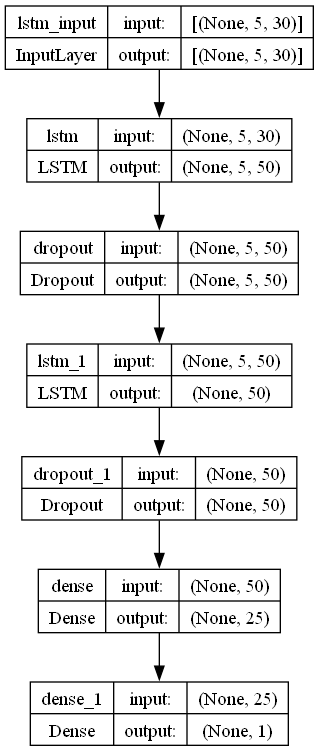

In [60]:
# Reshape X_train, X_test, y_train and y_test for LSTM
X_train_lstm, y_train_lstm = create_dataset(X_train, y_train, time_steps)
X_test_lstm, y_test_lstm = create_dataset(X_test, y_test, time_steps)

# Build LSTM Model with fixed seed for kernel initializers
def build_lstm_model(input_shape):
    model = Sequential()
    
    # 1st LSTM layer with fixed seed for kernel initializer
    model.add(LSTM(50, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # 2nd LSTM layer with fixed seed for kernel initializer
    model.add(LSTM(50, return_sequences=False, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # Dense layers with fixed seed for kernel initializer
    model.add(Dense(25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    return model

# Build and compile the LSTM model
lstm_model = build_lstm_model((X_train_lstm.shape[1], X_train_lstm.shape[2]))
lstm_model.compile(optimizer='adam', loss='mean_squared_error')

# LSTM model summary
lstm_model.summary()

# LSTM plot model
plot_model(lstm_model, to_file='LSTM_model.png', show_shapes=True, show_layer_names=True)

In [61]:
# Call the train_model function to train the LSTM model
lstm_history, lstm_training_time, lstm_train_pred, lstm_test_pred = train_model(
    model=lstm_model,
    X_train=X_train_lstm,
    y_train=y_train_lstm,
    X_test=X_test_lstm,
    y_test=y_test_lstm
)

Epoch 1/100

49/49 [==============================] - 3s 14ms/step - loss: 15959.4141 - val_loss: 11307.6025
Epoch 2/100
49/49 [==============================] - 0s 4ms/step - loss: 12694.3086 - val_loss: 8355.5059
Epoch 3/100
49/49 [==============================] - 0s 4ms/step - loss: 9299.8623 - val_loss: 5293.6948
Epoch 4/100
49/49 [==============================] - 0s 4ms/step - loss: 5945.4336 - val_loss: 2668.5037
Epoch 5/100
49/49 [==============================] - 0s 4ms/step - loss: 3244.1270 - val_loss: 967.1152
Epoch 6/100
49/49 [==============================] - 0s 4ms/step - loss: 1616.3793 - val_loss: 206.1733
Epoch 7/100
49/49 [==============================] - 0s 4ms/step - loss: 833.5219 - val_loss: 15.8385
Epoch 8/100
49/49 [==============================] - 0s 4ms/step - loss: 554.1816 - val_loss: 24.9520
Epoch 9/100
49/49 [==============================] - 0s 4ms/step - loss: 476.8199 - val_loss: 59.7567
Epoch 10/100
49/49 [==============================] - 0s 4ms/

Epoch 79/100
49/49 [==============================] - 0s 4ms/step - loss: 97.6797 - val_loss: 5.1876
Epoch 80/100
49/49 [==============================] - 0s 4ms/step - loss: 90.9613 - val_loss: 5.1692
Epoch 81/100
49/49 [==============================] - 0s 4ms/step - loss: 91.7184 - val_loss: 2.4172
Epoch 82/100
49/49 [==============================] - 0s 4ms/step - loss: 98.9463 - val_loss: 2.9816
Epoch 83/100
49/49 [==============================] - 0s 4ms/step - loss: 93.0827 - val_loss: 8.2793
Epoch 84/100
49/49 [==============================] - 0s 4ms/step - loss: 97.7524 - val_loss: 3.7995
Epoch 85/100
49/49 [==============================] - 0s 4ms/step - loss: 87.2261 - val_loss: 3.4176
Epoch 86/100
49/49 [==============================] - 0s 4ms/step - loss: 88.6574 - val_loss: 4.6751
Epoch 87/100
49/49 [==============================] - 0s 4ms/step - loss: 95.4847 - val_loss: 4.1434
Epoch 88/100
49/49 [==============================] - 0s 4ms/step - loss: 85.1764 - val_los

Time Measurement and Monitoring for LSTM 
Training time: 0 minutes and 21.64 seconds

Training Evaluation Metrics for LSTM 
Training R2 Score: 0.9337131185550407
Training Mean Absolute Error (MAE): 3.7175499703061026
Training Root Mean Squared Error (RMSE): 4.6309158749258295
Training Mean Absolute Percentage Error (MAPE): 2.94527145058625 %

Testing Evaluation Metrics for LSTM 
R2 Score: 0.24966009329703176
Mean Absolute Error (MAE): 2.3255280519227277
Root Mean Squared Error (RMSE): 2.707152330044029
Mean Absolute Percentage Error (MAPE): 2.0085921652027214 %


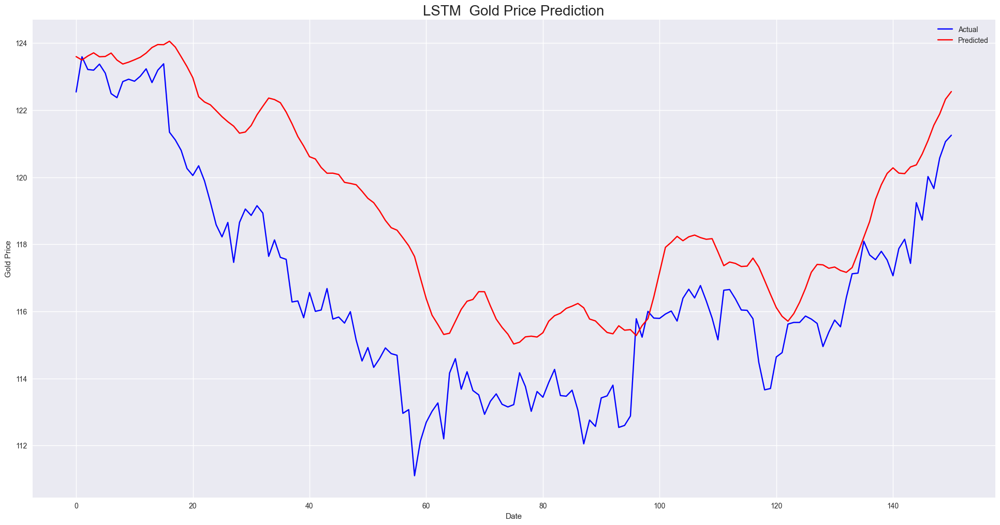

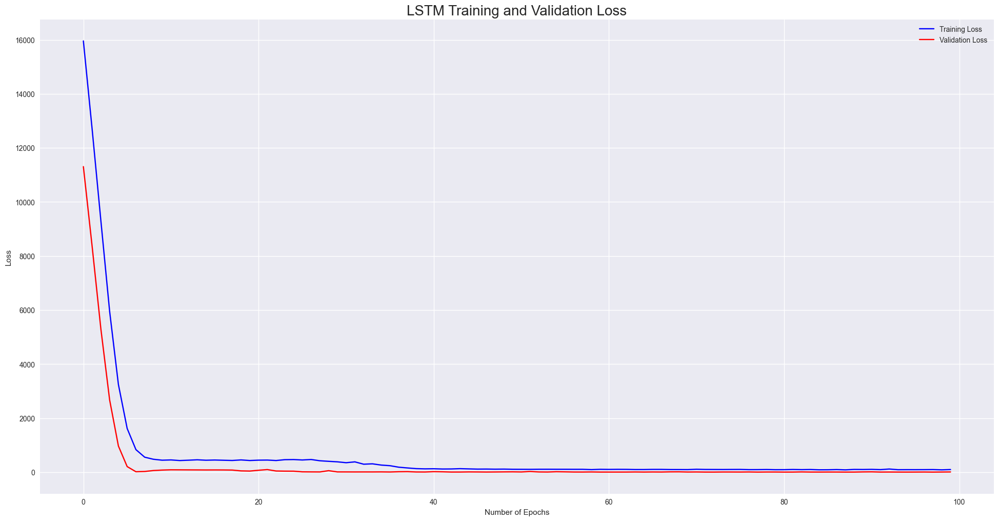

In [62]:
# Call the evaluate_and_plot_results function to evaluate the LSTM model and plot the results
evaluate_and_plot_results(
    model_name="LSTM",
    history=lstm_history,
    training_time=lstm_training_time,
    y_train=y_train_lstm,
    y_test=y_test_lstm,
    train_pred=lstm_train_pred,
    test_pred=lstm_test_pred,
    title_suffix=""
)

### 7.1.2 LSTM with Hyperparameter Tuning using Bayesian Optimization Tuner

In [63]:
# Build LSTM Model with hyperparameter-tuned units
def build_lstm_hyperpara_model(hp, input_shape):
    lstm_units = hp.Int('lstm_units', min_value=1, max_value=64, step=1)
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)
    
    model = Sequential()
    
    # 1st LSTM layer with hyperparameter-tuned units
    model.add(LSTM(units=lstm_units, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=dropout_rate))
    
    # 2nd LSTM layer with hyperparameter-tuned units
    model.add(LSTM(units=lstm_units, return_sequences=False, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=dropout_rate))
    
    # Dense layers
    model.add(Dense(units=25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(units=1, kernel_initializer='glorot_uniform'))

    # Compiling the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

In [64]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_model, best_lstm_hyperparameters, lstm_tuner, lstm_training_time, lstm_test_pred, lstm_train_pred = tune_hyperparameters(
    X_train=X_train_lstm, 
    y_train=y_train_lstm, 
    X_test=X_test_lstm, 
    y_test=y_test_lstm, 
    build_model_function=build_lstm_hyperpara_model,
    project_name='output_lstm',
    checkpoint_name='lstm'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm\tuner0.json
INFO:tensorflow:Oracle triggered exit
49/49 [==============================] - 0s 2ms/step


In [65]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_model, 
    tuner=lstm_tuner, 
    X_train=X_train_lstm, 
    y_train=y_train_lstm, 
    X_test=X_test_lstm, 
    y_test=y_test_lstm, 
    model_save_path="best_lstm_model.keras"
)

Loss on training set: 1.941210389137268
Loss on test set: 0.6218909025192261 

Best Hyperparameter Values: {'lstm_units': 64, 'dropout_rate': 0.0} 

Results summary
Results in hyperparameter_tuning\output_lstm
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 06 summary
Hyperparameters:
lstm_units: 64
dropout_rate: 0.0
Score: 0.6218909025192261

Trial 02 summary
Hyperparameters:
lstm_units: 44
dropout_rate: 0.0
Score: 0.6653434038162231

Trial 09 summary
Hyperparameters:
lstm_units: 30
dropout_rate: 0.0
Score: 0.6655688881874084

Trial 00 summary
Hyperparameters:
lstm_units: 17
dropout_rate: 0.0
Score: 0.7445391416549683

Trial 05 summary
Hyperparameters:
lstm_units: 46
dropout_rate: 0.2
Score: 1.330558180809021

Trial 08 summary
Hyperparameters:
lstm_units: 64
dropout_rate: 0.4
Score: 1.410652756690979

Trial 07 summary
Hyperparameters:
lstm_units: 1
dropout_rate: 0.0
Score: 1.4846352338790894

Trial 04 summary
Hyperparameters:
lstm_units: 38
dropout_rate: 0.2



Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 64)             24320     
                                                                 
 dropout (Dropout)           (None, 5, 64)             0         
                                                                 
 lstm_1 (LSTM)               (None, 64)                33024     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense (Dense)               (None, 25)                1625      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 58995 (230.45 KB)
Tra

Time Measurement and Monitoring for LSTM with Hyperparameter Tuning
Training time: 3 minutes and 22.92 seconds

Training Evaluation Metrics for LSTM with Hyperparameter Tuning
Training R2 Score: 0.99399979030318
Training Mean Absolute Error (MAE): 0.9775161154369632
Training Root Mean Squared Error (RMSE): 1.3932732922136801
Training Mean Absolute Percentage Error (MAPE): 0.7572056863349325 %

Testing Evaluation Metrics for LSTM with Hyperparameter Tuning
R2 Score: 0.9363282452878773
Mean Absolute Error (MAE): 0.6071716127962025
Root Mean Squared Error (RMSE): 0.7886005594294134
Mean Absolute Percentage Error (MAPE): 0.5230346029811156 %


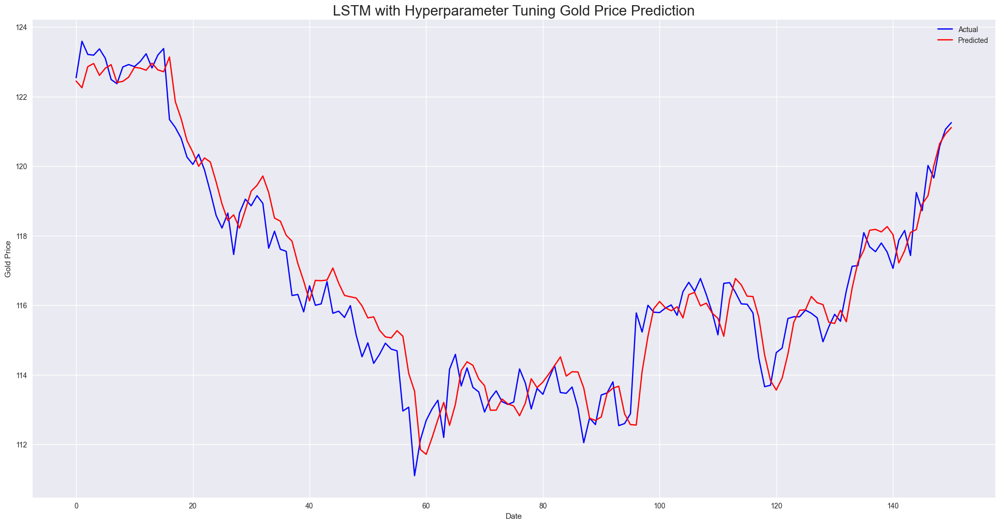

In [66]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM",
    history=None, 
    training_time=lstm_training_time,
    y_train=y_train_lstm,
    y_test=y_test_lstm,
    train_pred=lstm_train_pred,
    test_pred=lstm_test_pred,
    title_suffix="with Hyperparameter Tuning",
    is_tuned=True
)

## 7.2 Solution Model: LSTM-CNN

### 7.2.1 Solution Model: LSTM-CNN without Hyperparameter Tuning

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 5, 50)             16200     
                                                                 
 dropout_2 (Dropout)         (None, 5, 50)             0         
                                                                 
 lstm_3 (LSTM)               (None, 5, 50)             20200     
                                                                 
 dropout_3 (Dropout)         (None, 5, 50)             0         
                                                                 
 conv1d (Conv1D)             (None, 4, 50)             5050      
                                                                 
 max_pooling1d (MaxPooling1  (None, 2, 50)             0         
 D)                                                              
                                                      

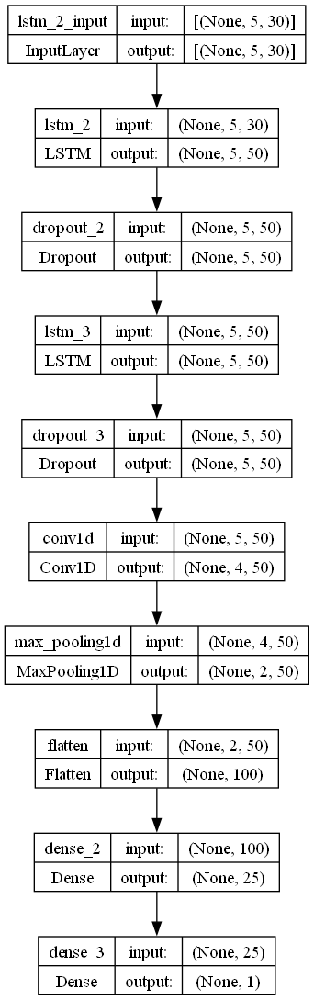

In [67]:
# Reshape X_train, X_test, y_train and y_test for LSTM-CNN
X_train_lstm_cnn, y_train_lstm_cnn = create_dataset(X_train, y_train, time_steps)
X_test_lstm_cnn, y_test_lstm_cnn = create_dataset(X_test, y_test, time_steps)

# Build LSTM-CNN Model with fixed seed for kernel initializers
def build_lstm_cnn_model(input_shape):
    model = Sequential()
    
    # 1st LSTM layer 
    model.add(LSTM(50, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # 2nd LSTM layer 
    model.add(LSTM(50, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # CNN layers
    model.add(Conv1D(filters=50, kernel_size=2, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    
    # Dense layers
    model.add(Dense(25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    return model

# Build and compile the LSTM-CNN model
lstm_cnn_model = build_lstm_cnn_model((X_train_lstm_cnn.shape[1], X_train_lstm_cnn.shape[2]))
lstm_cnn_model.compile(optimizer='adam', loss='mean_squared_error')

# LSTM-CNN model summary
lstm_cnn_model.summary()

# LSTM-CNN plot model
plot_model(lstm_cnn_model, to_file='LSTM_CNN_model.png', show_shapes=True, show_layer_names=True)

In [68]:
# Call the train_model function to train the LSTM-CNN model
lstm_cnn_history, lstm_cnn_training_time, lstm_cnn_train_pred, lstm_cnn_test_pred = train_model(
    model=lstm_cnn_model,
    X_train=X_train_lstm_cnn,
    y_train=y_train_lstm_cnn,
    X_test=X_test_lstm_cnn,
    y_test=y_test_lstm_cnn
)

Epoch 1/100
49/49 [==============================] - 3s 13ms/step - loss: 14013.6084 - val_loss: 3095.3823
Epoch 2/100
49/49 [==============================] - 0s 4ms/step - loss: 1362.1903 - val_loss: 59.3564
Epoch 3/100
49/49 [==============================] - 0s 4ms/step - loss: 492.4256 - val_loss: 51.4997
Epoch 4/100
49/49 [==============================] - 0s 4ms/step - loss: 462.1892 - val_loss: 57.4250
Epoch 5/100
49/49 [==============================] - 0s 5ms/step - loss: 447.1822 - val_loss: 41.2219
Epoch 6/100
49/49 [==============================] - 0s 4ms/step - loss: 402.7447 - val_loss: 23.5905
Epoch 7/100
49/49 [==============================] - 0s 4ms/step - loss: 332.4199 - val_loss: 8.6177
Epoch 8/100
49/49 [==============================] - 0s 4ms/step - loss: 261.3899 - val_loss: 4.8511
Epoch 9/100
49/49 [==============================] - 0s 5ms/step - loss: 253.4762 - val_loss: 25.4290
Epoch 10/100
49/49 [==============================] - 0s 5ms/step - loss: 324.

Time Measurement and Monitoring for LSTM-CNN 
Training time: 0 minutes and 25.52 seconds

Training Evaluation Metrics for LSTM-CNN 
Training R2 Score: 0.9287282469567802
Training Mean Absolute Error (MAE): 3.763482495775128
Training Root Mean Squared Error (RMSE): 4.801885702215109
Training Mean Absolute Percentage Error (MAPE): 2.880766993720674 %

Testing Evaluation Metrics for LSTM-CNN 
R2 Score: 0.5797517943149005
Mean Absolute Error (MAE): 1.7068720433567883
Root Mean Squared Error (RMSE): 2.0259867718573035
Mean Absolute Percentage Error (MAPE): 1.4684231517221322 %


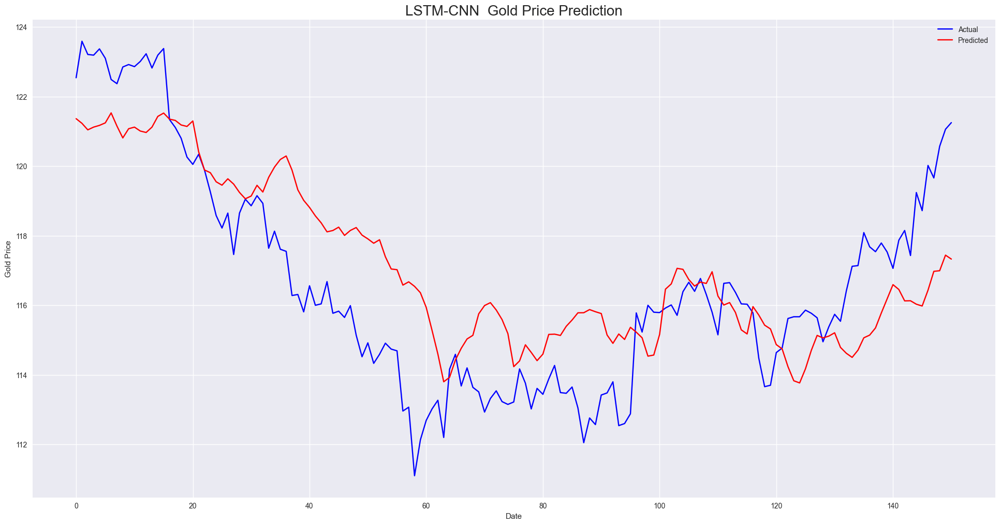

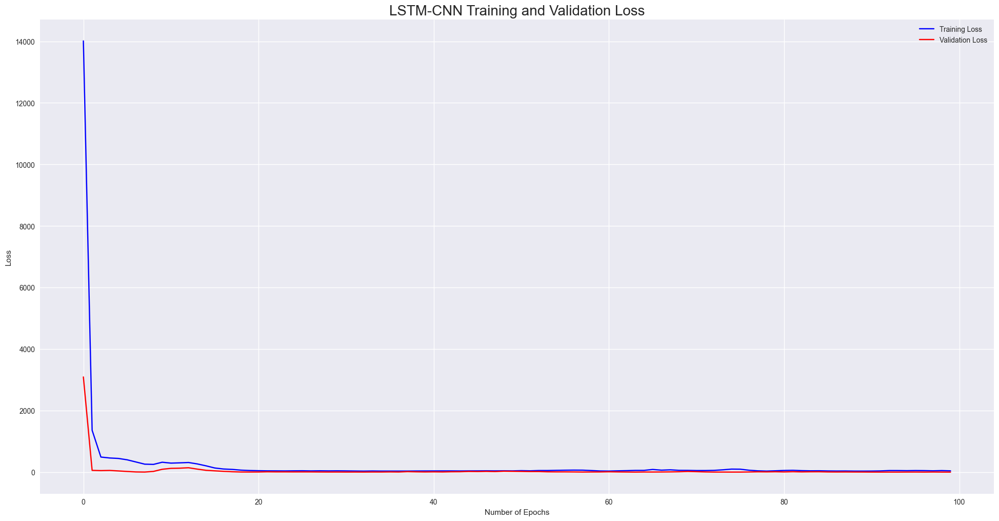

In [69]:
# Call the evaluate_and_plot_results function to evaluate the LSTM-CNN model and plot the results
evaluate_and_plot_results(
    model_name="LSTM-CNN",
    history=lstm_cnn_history,
    training_time=lstm_cnn_training_time,
    y_train=y_train_lstm_cnn,
    y_test=y_test_lstm_cnn,
    train_pred=lstm_cnn_train_pred,
    test_pred=lstm_cnn_test_pred,
    title_suffix=""
)

### 7.2.2 LSTM-CNN with Hyperparameter Tuning using Bayesian Optimization Tuner

In [70]:
# Modify the LSTM-CNN model builder
def build_lstm_cnn_hyperpara_model(hp, input_shape):
    # LSTM layers hyperparameters
    lstm_units = hp.Int('lstm_units', min_value=32, max_value=128, step=32)
    lstm_dropout_rate = hp.Float('lstm_dropout_rate', min_value=0.0, max_value=0.5, step=0.1)
    
    # CNN layers hyperparameters
    cnn_filters = hp.Int('cnn_filters', min_value=32, max_value=128, step=32)
    kernel_size = hp.Int('kernel_size', min_value=1, max_value=3, step=1)
    dense_units = hp.Int('dense_units', min_value=16, max_value=128, step=16)

    # Adjust kernel size if input is too small
    if input_shape[0] < kernel_size:
        kernel_size = input_shape[0]

    model = Sequential()
    
    # 1st LSTM layer with kernel initializer
    model.add(LSTM(units=lstm_units, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # 2nd LSTM layer with kernel initializer
    model.add(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # CNN layers
    model.add(Conv1D(filters=cnn_filters, kernel_size=kernel_size, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    
    # Dense layers
    model.add(Dense(dense_units, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))

    # Compile the model
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

In [71]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_cnn_model, best_lstm_cnn_hyperparameters, lstm_cnn_tuner, lstm_cnn_training_time, lstm_cnn_test_pred, lstm_cnn_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_cnn, 
    y_train=y_train_lstm_cnn, 
    X_test=X_test_lstm_cnn, 
    y_test=y_test_lstm_cnn, 
    build_model_function=build_lstm_cnn_hyperpara_model,
    project_name='output_lstm_cnn',
    checkpoint_name='lstm_cnn'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 2ms/step


In [72]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_cnn_model, 
    tuner=lstm_cnn_tuner, 
    X_train=X_train_lstm_cnn, 
    y_train=y_train_lstm_cnn, 
    X_test=X_test_lstm_cnn, 
    y_test=y_test_lstm_cnn, 
    model_save_path="best_lstm_cnn_model.keras"
)

Loss on training set: 3.7020599842071533
Loss on test set: 1.1050763130187988 

Best Hyperparameter Values: {'lstm_units': 64, 'lstm_dropout_rate': 0.0, 'cnn_filters': 96, 'kernel_size': 2, 'dense_units': 16} 

Results summary
Results in hyperparameter_tuning\output_lstm_cnn
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 04 summary
Hyperparameters:
lstm_units: 64
lstm_dropout_rate: 0.0
cnn_filters: 96
kernel_size: 2
dense_units: 16
Score: 1.1050763130187988

Trial 02 summary
Hyperparameters:
lstm_units: 128
lstm_dropout_rate: 0.1
cnn_filters: 128
kernel_size: 3
dense_units: 16
Score: 1.5256271362304688

Trial 03 summary
Hyperparameters:
lstm_units: 64
lstm_dropout_rate: 0.2
cnn_filters: 96
kernel_size: 2
dense_units: 16
Score: 1.615779995918274

Trial 01 summary
Hyperparameters:
lstm_units: 64
lstm_dropout_rate: 0.2
cnn_filters: 32
kernel_size: 2
dense_units: 32
Score: 1.691581130027771

Trial 00 summary
Hyperparameters:
lstm_units: 64
lstm_dropout_rate: 0.2



Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 64)             24320     
                                                                 
 dropout (Dropout)           (None, 5, 64)             0         
                                                                 
 lstm_1 (LSTM)               (None, 5, 64)             33024     
                                                                 
 dropout_1 (Dropout)         (None, 5, 64)             0         
                                                                 
 conv1d (Conv1D)             (None, 4, 96)             12384     
                                                                 
 max_pooling1d (MaxPooling1  (None, 2, 96)             0         
 D)                                                              
                                   

Time Measurement and Monitoring for LSTM-CNN with Hyperparameter Tuning
Training time: 5 minutes and 11.14 seconds

Training Evaluation Metrics for LSTM-CNN with Hyperparameter Tuning
Training R2 Score: 0.9885570704229075
Training Mean Absolute Error (MAE): 1.4359864132022844
Training Root Mean Squared Error (RMSE): 1.9240737319425758
Training Mean Absolute Percentage Error (MAPE): 1.094809143177853 %

Testing Evaluation Metrics for LSTM-CNN with Hyperparameter Tuning
R2 Score: 0.8868577215955789
Mean Absolute Error (MAE): 0.8437743014085789
Root Mean Squared Error (RMSE): 1.0512260914868046
Mean Absolute Percentage Error (MAPE): 0.7251188174697567 %


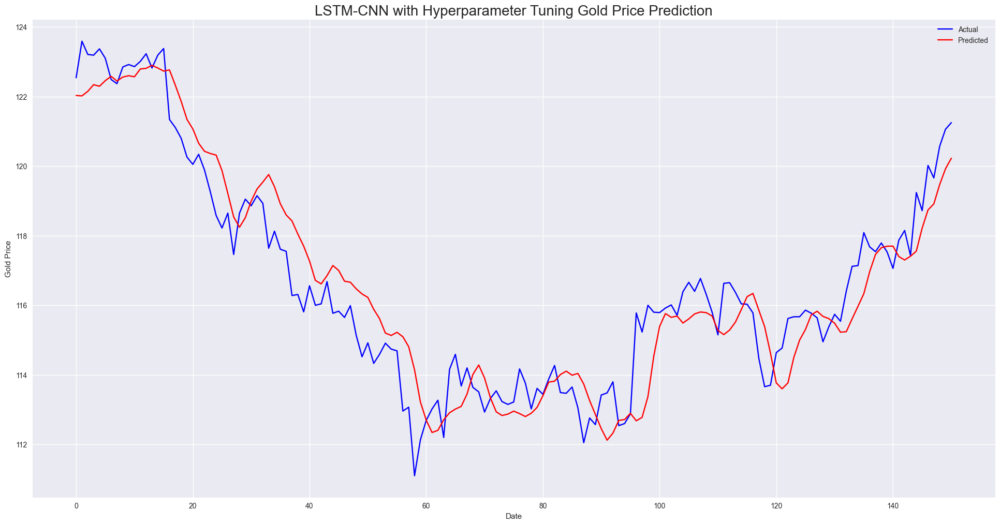

In [73]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-CNN",
    history=None, 
    training_time=lstm_cnn_training_time,
    y_train=y_train_lstm_cnn,
    y_test=y_test_lstm_cnn,
    train_pred=lstm_cnn_train_pred,
    test_pred=lstm_cnn_test_pred,
    title_suffix="with Hyperparameter Tuning",
    is_tuned=True
)

## 7.3 Solution Model: BiLSTM-CNN

### 7.3.1 Solution Model: BiLSTM-CNN without Hyperparameter Tuning

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 5, 100)            32400     
 al)                                                             
                                                                 
 dropout_2 (Dropout)         (None, 5, 100)            0         
                                                                 
 bidirectional_1 (Bidirecti  (None, 5, 100)            60400     
 onal)                                                           
                                                                 
 dropout_3 (Dropout)         (None, 5, 100)            0         
                                                                 
 conv1d_1 (Conv1D)           (None, 4, 100)            20100     
                                                                 
 max_pooling1d_1 (MaxPoolin  (None, 2, 100)           

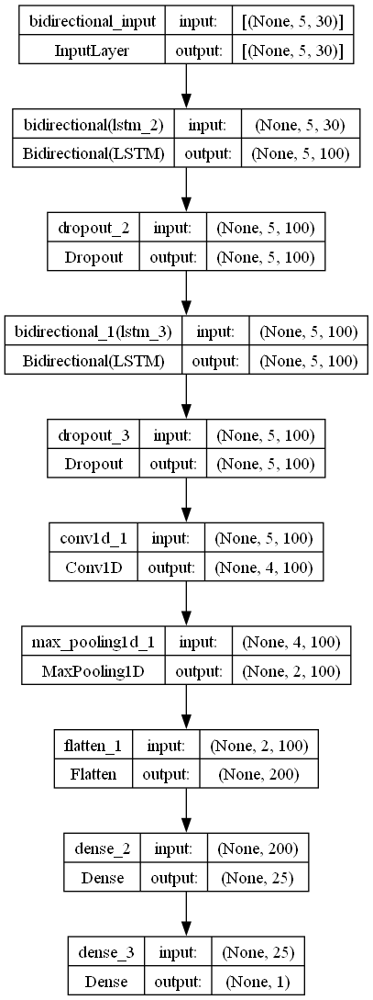

In [74]:
# Reshape X_train, X_test, y_train and y_test for BiLSTM-CNN
X_train_bilstm_cnn, y_train_bilstm_cnn = create_dataset(X_train, y_train, time_steps)
X_test_bilstm_cnn, y_test_bilstm_cnn = create_dataset(X_test, y_test, time_steps)

# Build BiLSTM-CNN Model with fixed seed for kernel initializers
def build_bilstm_cnn_model(input_shape):
    model = Sequential()
    
    # 1st BiLSTM layer with fixed seed for kernel initializer
    model.add(Bidirectional(LSTM(50, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'), input_shape=input_shape))
    model.add(Dropout(0.2))
    
    # 2nd BiLSTM layer with fixed seed for kernel initializer
    model.add(Bidirectional(LSTM(50, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform')))
    model.add(Dropout(0.2))
    
    # CNN layers
    model.add(Conv1D(filters=100, kernel_size=2, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    
    # Dense layers with fixed seed for kernel initializer
    model.add(Dense(25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    return model

# Build and compile the BiLSTM-CNN model
bilstm_cnn_model = build_bilstm_cnn_model((X_train_bilstm_cnn.shape[1], X_train_bilstm_cnn.shape[2]))
bilstm_cnn_model.compile(optimizer='adam', loss='mean_squared_error')

# BiLSTM-CNN model summary
bilstm_cnn_model.summary()

# BiLSTM-CNN plot model
plot_model(bilstm_cnn_model, to_file='BiLSTM_CNN_model.png', show_shapes=True, show_layer_names=True)

In [75]:
# Call the train_model function to train the BiLSTM-CNN model
bilstm_cnn_history, bilstm_cnn_training_time, bilstm_cnn_train_pred, bilstm_cnn_test_pred = train_model(
    model=bilstm_cnn_model,
    X_train=X_train_bilstm_cnn,
    y_train=y_train_bilstm_cnn,
    X_test=X_test_bilstm_cnn,
    y_test=y_test_bilstm_cnn
)

Epoch 1/100
49/49 [==============================] - 4s 21ms/step - loss: 10873.6074 - val_loss: 452.0456
Epoch 2/100
49/49 [==============================] - 0s 6ms/step - loss: 383.3832 - val_loss: 23.7678
Epoch 3/100
49/49 [==============================] - 0s 5ms/step - loss: 530.4431 - val_loss: 9.2183
Epoch 4/100
49/49 [==============================] - 0s 6ms/step - loss: 579.6948 - val_loss: 10.8791
Epoch 5/100
49/49 [==============================] - 0s 6ms/step - loss: 600.1177 - val_loss: 18.1259
Epoch 6/100
49/49 [==============================] - 0s 6ms/step - loss: 619.3554 - val_loss: 20.3705
Epoch 7/100
49/49 [==============================] - 0s 6ms/step - loss: 620.2318 - val_loss: 25.0844
Epoch 8/100
49/49 [==============================] - 0s 6ms/step - loss: 623.8207 - val_loss: 27.3326
Epoch 9/100
49/49 [==============================] - 0s 6ms/step - loss: 631.4802 - val_loss: 30.2236
Epoch 10/100
49/49 [==============================] - 0s 6ms/step - loss: 630.5

Time Measurement and Monitoring for BiLSTM-CNN 
Training time: 0 minutes and 31.88 seconds

Training Evaluation Metrics for BiLSTM-CNN 
Training R2 Score: 0.8536703247899202
Training Mean Absolute Error (MAE): 5.314979746332717
Training Root Mean Squared Error (RMSE): 6.880488958358932
Training Mean Absolute Percentage Error (MAPE): 4.005542207745238 %

Testing Evaluation Metrics for BiLSTM-CNN 
R2 Score: 0.49904199733895005
Mean Absolute Error (MAE): 1.7314003230546362
Root Mean Squared Error (RMSE): 2.211995967318723
Mean Absolute Percentage Error (MAPE): 1.4673711229118467 %


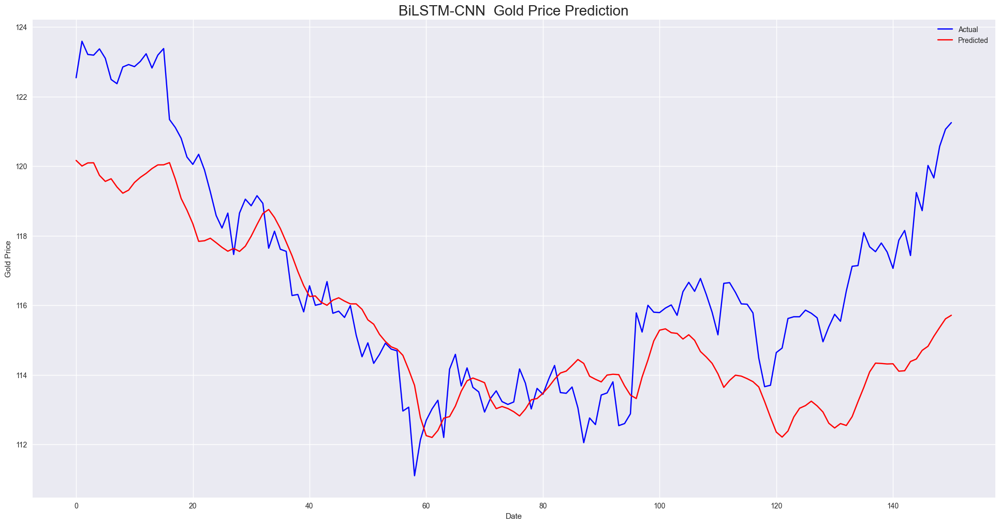

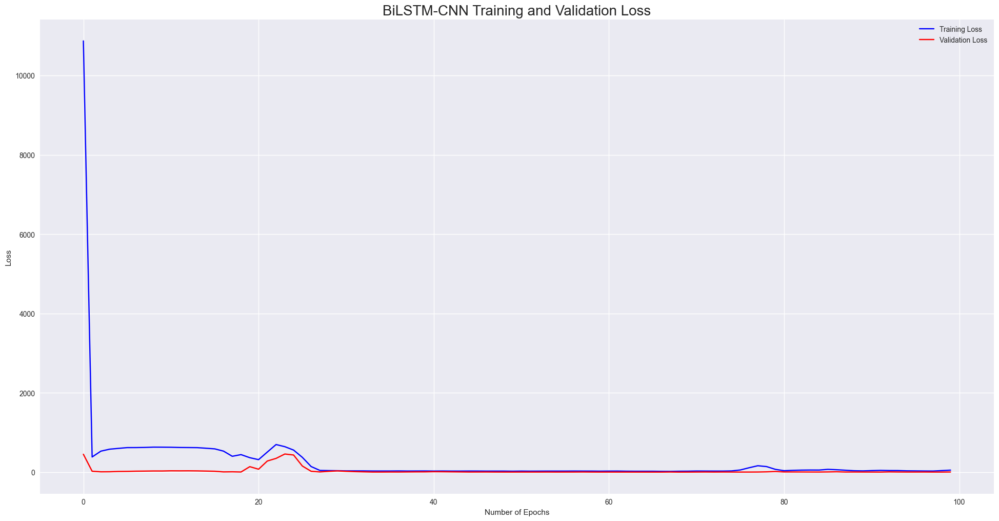

In [76]:
# Call the evaluate_and_plot_results function to evaluate the BiLSTM-CNN model and plot the results
evaluate_and_plot_results(
    model_name="BiLSTM-CNN",
    history=bilstm_cnn_history,
    training_time=bilstm_cnn_training_time,
    y_train=y_train_bilstm_cnn,
    y_test=y_test_bilstm_cnn,
    train_pred=bilstm_cnn_train_pred,
    test_pred=bilstm_cnn_test_pred,
    title_suffix=""
)

### 7.3.2 BiLSTM-CNN with Hyperparameter Tuning using Bayesian Optimization Tuner

In [77]:
# Build BiLSTM-CNN Model with hyperparameter tuning
def build_bilstm_cnn_hyperpara_model(hp, input_shape):
    # LSTM layers hyperparameters
    lstm_units = hp.Int('lstm_units', min_value=32, max_value=256, step=32)
    lstm_dropout_rate = hp.Float('lstm_dropout_rate', min_value=0.0, max_value=0.5, step=0.05)
    
    # CNN layers hyperparameters
    cnn_filters = hp.Int('cnn_filters', min_value=32, max_value=256, step=32)
    kernel_size = hp.Int('kernel_size', min_value=3, max_value=7, step=1)
    
    # Dense layers hyperparameters
    dense_units = hp.Int('dense_units', min_value=10, max_value=256, step=10)

    model = Sequential()
    
    # 1st BiLSTM layer with hyperparameter-tuned units
    model.add(Bidirectional(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform'), input_shape=input_shape))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # 2nd BiLSTM layer with hyperparameter-tuned units
    model.add(Bidirectional(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform')))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # CNN layers with hyperparameter-tuned filters
    model.add(Conv1D(filters=cnn_filters, kernel_size=3, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    
    # Dense layers with hyperparameter-tuned units
    model.add(Dense(units=dense_units, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    # Compiling the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

In [78]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_bilstm_cnn_model, best_bilstm_cnn_hyperparameters, bilstm_cnn_tuner, bilstm_cnn_training_time, bilstm_cnn_test_pred, bilstm_cnn_train_pred = tune_hyperparameters(
    X_train=X_train_bilstm_cnn, 
    y_train=y_train_bilstm_cnn, 
    X_test=X_test_bilstm_cnn, 
    y_test=y_test_bilstm_cnn, 
    build_model_function=build_bilstm_cnn_hyperpara_model,
    project_name='output_bilstm_cnn',
    checkpoint_name='bilstm_cnn'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 7ms/step


In [79]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_bilstm_cnn_model, 
    tuner=bilstm_cnn_tuner, 
    X_train=X_train_bilstm_cnn, 
    y_train=y_train_bilstm_cnn, 
    X_test=X_test_bilstm_cnn, 
    y_test=y_test_bilstm_cnn, 
    model_save_path="best_bilstm_cnn_model.keras"
)

Loss on training set: 3.10219669342041
Loss on test set: 0.5993348360061646 

Best Hyperparameter Values: {'lstm_units': 256, 'lstm_dropout_rate': 0.0, 'cnn_filters': 256, 'kernel_size': 6, 'dense_units': 210} 

Results summary
Results in hyperparameter_tuning\output_bilstm_cnn
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 01 summary
Hyperparameters:
lstm_units: 256
lstm_dropout_rate: 0.0
cnn_filters: 256
kernel_size: 6
dense_units: 210
Score: 0.5993348360061646

Trial 09 summary
Hyperparameters:
lstm_units: 160
lstm_dropout_rate: 0.1
cnn_filters: 128
kernel_size: 3
dense_units: 180
Score: 0.6566435098648071

Trial 08 summary
Hyperparameters:
lstm_units: 160
lstm_dropout_rate: 0.30000000000000004
cnn_filters: 64
kernel_size: 5
dense_units: 150
Score: 0.6844844222068787

Trial 03 summary
Hyperparameters:
lstm_units: 128
lstm_dropout_rate: 0.25
cnn_filters: 256
kernel_size: 6
dense_units: 90
Score: 0.7389827370643616

Trial 06 summary
Hyperparameters:
lstm_uni


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 5, 512)            587776    
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 5, 512)            0         
                                                                 
 bidirectional_1 (Bidirecti  (None, 5, 512)            1574912   
 onal)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 5, 512)            0         
                                                                 
 conv1d (Conv1D)             (None, 3, 256)            393472    
                                                                 
 max_pooling1d (MaxPooling1  (None,

Time Measurement and Monitoring for BiLSTM-CNN with Hyperparameter Tuning
Training time: 9 minutes and 8.21 seconds

Training Evaluation Metrics for BiLSTM-CNN with Hyperparameter Tuning
Training R2 Score: 0.99041122412237
Training Mean Absolute Error (MAE): 1.3064205190172533
Training Root Mean Squared Error (RMSE): 1.7613054617046824
Training Mean Absolute Percentage Error (MAPE): 0.9860139713441197 %

Testing Evaluation Metrics for BiLSTM-CNN with Hyperparameter Tuning
R2 Score: 0.9386376197117878
Mean Absolute Error (MAE): 0.5977910176427976
Root Mean Squared Error (RMSE): 0.7741672058723124
Mean Absolute Percentage Error (MAPE): 0.513396186139814 %


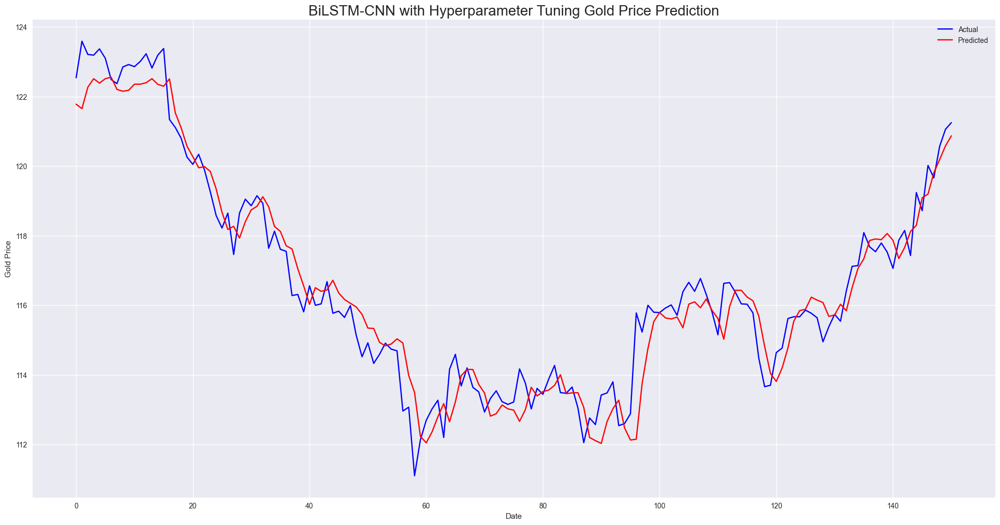

In [80]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="BiLSTM-CNN",
    history=None, 
    training_time=bilstm_cnn_training_time,
    y_train=y_train_bilstm_cnn,
    y_test=y_test_bilstm_cnn,
    train_pred=bilstm_cnn_train_pred,
    test_pred=bilstm_cnn_test_pred,
    title_suffix="with Hyperparameter Tuning",
    is_tuned=True
)

## 7.4 Solution Model: LSTM-GRU

### 7.4.1 Solution Model: LSTM-GRU without Hyperparameter Tuning

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 5, 50)             16200     
                                                                 
 dropout_2 (Dropout)         (None, 5, 50)             0         
                                                                 
 gru (GRU)                   (None, 50)                15300     
                                                                 
 dropout_3 (Dropout)         (None, 50)                0         
                                                                 
 dense_2 (Dense)             (None, 25)                1275      
                                                                 
 dense_3 (Dense)             (None, 1)                 26        
                                                                 
Total params: 32801 (128.13 KB)
Trainable params: 3280

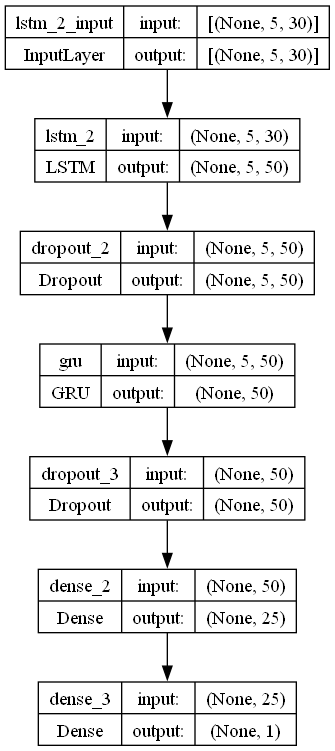

In [81]:
# Reshape X_train, X_test, y_train and y_test for LSTM-GRU
X_train_lstm_gru, y_train_lstm_gru = create_dataset(X_train, y_train, time_steps)
X_test_lstm_gru, y_test_lstm_gru = create_dataset(X_test, y_test, time_steps)

# Build LSTM-GRU Model with an additional LSTM layer and fixed seed for kernel initializers
def build_lstm_gru_model(input_shape):
    model = Sequential()
    
    # 1st LSTM layer with fixed seed for kernel initializer
    model.add(LSTM(50, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # GRU layer with fixed seed for kernel initializer
    model.add(GRU(50, return_sequences=False, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(0.2))
    
    # Dense layers with fixed seed for kernel initializer
    model.add(Dense(25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    return model

# Build and compile the LSTM-GRU model
lstm_gru_model = build_lstm_gru_model((X_train_lstm_gru.shape[1], X_train_lstm_gru.shape[2]))
lstm_gru_model.compile(optimizer='adam', loss='mean_squared_error')

# LSTM-GRU model summary
lstm_gru_model.summary()

# LSTM-GRU plot model
plot_model(lstm_gru_model, to_file='LSTM_GRU_model.png', show_shapes=True, show_layer_names=True)

In [82]:
# Call the train_model function to train the LSTM-GRU model
lstm_gru_history, lstm_gru_training_time, lstm_gru_train_pred, lstm_gru_test_pred = train_model(
    model=lstm_gru_model,
    X_train=X_train_lstm_gru,
    y_train=y_train_lstm_gru,
    X_test=X_test_lstm_gru,
    y_test=y_test_lstm_gru
)

Epoch 1/100
49/49 [==============================] - 3s 12ms/step - loss: 15331.0498 - val_loss: 10169.6260
Epoch 2/100
49/49 [==============================] - 0s 4ms/step - loss: 11126.4756 - val_loss: 6687.8936
Epoch 3/100
49/49 [==============================] - 0s 4ms/step - loss: 7316.1533 - val_loss: 3575.8022
Epoch 4/100
49/49 [==============================] - 0s 4ms/step - loss: 4106.7217 - val_loss: 1391.9659
Epoch 5/100
49/49 [==============================] - 0s 4ms/step - loss: 1960.1470 - val_loss: 322.6610
Epoch 6/100
49/49 [==============================] - 0s 4ms/step - loss: 958.3761 - val_loss: 26.5884
Epoch 7/100
49/49 [==============================] - 0s 4ms/step - loss: 581.9418 - val_loss: 21.8794
Epoch 8/100
49/49 [==============================] - 0s 4ms/step - loss: 478.0280 - val_loss: 55.7488
Epoch 9/100
49/49 [==============================] - 0s 4ms/step - loss: 456.6372 - val_loss: 77.3683
Epoch 10/100
49/49 [==============================] - 0s 4ms/ste

Time Measurement and Monitoring for LSTM-GRU 
Training time: 0 minutes and 22.06 seconds

Training Evaluation Metrics for LSTM-GRU 
Training R2 Score: 0.9734234128769936
Training Mean Absolute Error (MAE): 2.174197298400369
Training Root Mean Squared Error (RMSE): 2.93226153018935
Training Mean Absolute Percentage Error (MAPE): 1.664892276896655 %

Testing Evaluation Metrics for LSTM-GRU 
R2 Score: 0.5454906076060768
Mean Absolute Error (MAE): 1.6968736000200477
Root Mean Squared Error (RMSE): 2.1069542361167075
Mean Absolute Percentage Error (MAPE): 1.469718932560094 %


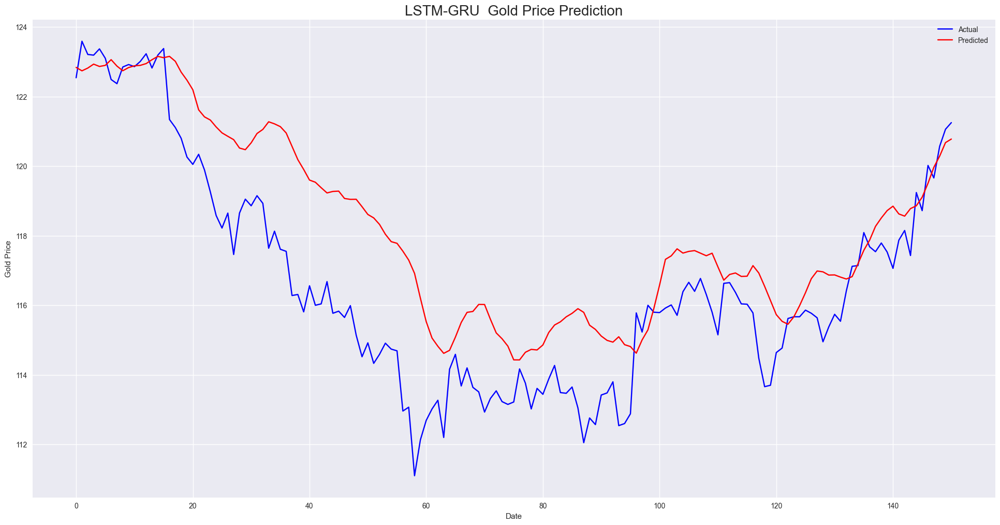

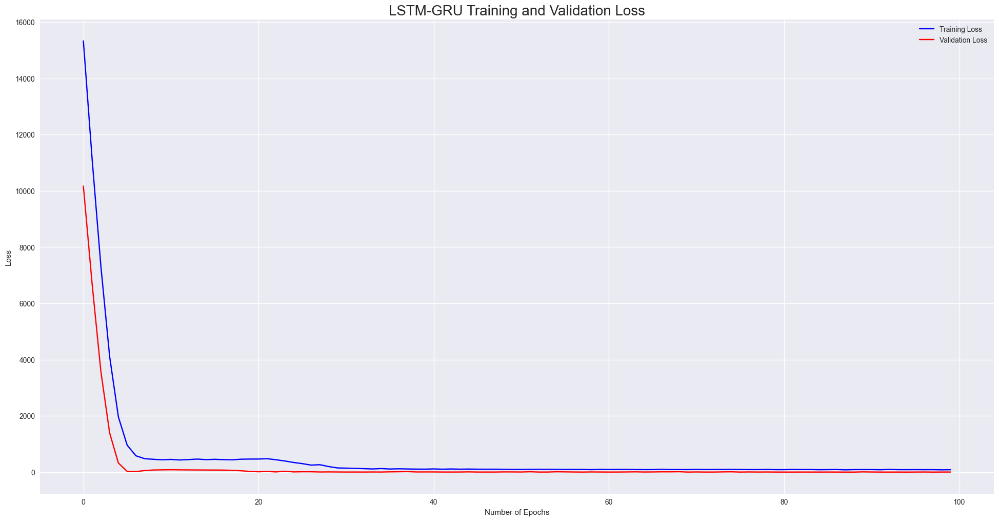

In [83]:
# Call the evaluate_and_plot_results function to evaluate the LSTM-GRU model and plot the results
evaluate_and_plot_results(
    model_name="LSTM-GRU",
    history=lstm_gru_history,
    training_time=lstm_gru_training_time,
    y_train=y_train_lstm_gru,
    y_test=y_test_lstm_gru,
    train_pred=lstm_gru_train_pred,
    test_pred=lstm_gru_test_pred,
    title_suffix=""
)

### 7.4.2 LSTM-GRU with Hyperparameter Tuning using Bayesian Optimization Tuner

In [84]:
# Build LSTM-GRU Model with hyperparameter tuning
def build_lstm_gru_hyperpara_model(hp, input_shape):
    lstm_units = hp.Int('lstm_units', min_value=1, max_value=64, step=1)
    gru_units = hp.Int('gru_units', min_value=1, max_value=64, step=1)
    dense_units = hp.Int('dense_units', min_value=1, max_value=64, step=1)
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)

    model = Sequential()
    
    # LSTM layer with hyperparameter-tuned units
    model.add(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform', input_shape=input_shape))
    model.add(Dropout(rate=dropout_rate))
    
    # GRU layer with hyperparameter-tuned units
    model.add(GRU(units=gru_units, return_sequences=False, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'))
    model.add(Dropout(rate=dropout_rate))
    
    # Dense layer with hyperparameter-tuned units
    model.add(Dense(units=dense_units, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    # Compiling the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

In [85]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_gru_model, best_lstm_gru_hyperparameters, lstm_gru_tuner, lstm_gru_training_time, lstm_gru_test_pred, lstm_gru_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_gru, 
    y_train=y_train_lstm_gru, 
    X_test=X_test_lstm_gru, 
    y_test=y_test_lstm_gru, 
    build_model_function=build_lstm_gru_hyperpara_model,
    project_name='output_lstm_gru',
    checkpoint_name='lstm_gru'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 1ms/step


In [86]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_gru_model, 
    tuner=lstm_gru_tuner, 
    X_train=X_train_lstm_gru, 
    y_train=y_train_lstm_gru, 
    X_test=X_test_lstm_gru, 
    y_test=y_test_lstm_gru, 
    model_save_path="best_lstm_gru_model.keras"
)

Loss on training set: 2.328380823135376
Loss on test set: 0.6495019197463989 

Best Hyperparameter Values: {'lstm_units': 9, 'gru_units': 8, 'dense_units': 54, 'dropout_rate': 0.0} 

Results summary
Results in hyperparameter_tuning\output_lstm_gru
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 03 summary
Hyperparameters:
lstm_units: 9
gru_units: 8
dense_units: 54
dropout_rate: 0.0
Score: 0.6495019197463989

Trial 00 summary
Hyperparameters:
lstm_units: 53
gru_units: 56
dense_units: 18
dropout_rate: 0.0
Score: 0.669053852558136

Trial 02 summary
Hyperparameters:
lstm_units: 64
gru_units: 13
dense_units: 31
dropout_rate: 0.1
Score: 1.5757774114608765

Trial 01 summary
Hyperparameters:
lstm_units: 19
gru_units: 11
dense_units: 44
dropout_rate: 0.1
Score: 1.666045904159546

Trial 04 summary
Hyperparameters:
lstm_units: 11
gru_units: 34
dense_units: 16
dropout_rate: 0.30000000000000004
Score: 1.913784146308899

Trial 05 summary
Hyperparameters:
lstm_units: 46
gru_


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 9)              1440      
                                                                 
 dropout (Dropout)           (None, 5, 9)              0         
                                                                 
 gru (GRU)                   (None, 8)                 456       
                                                                 
 dropout_1 (Dropout)         (None, 8)                 0         
                                                                 
 dense (Dense)               (None, 54)                486       
                                                                 
 dense_1 (Dense)             (None, 1)                 55        
                                                                 
Total params: 2437 (9.52 KB)
Traina

Time Measurement and Monitoring for LSTM-GRU with Hyperparameter Tuning
Training time: 3 minutes and 53.36 seconds

Training Evaluation Metrics for LSTM-GRU with Hyperparameter Tuning
Training R2 Score: 0.9928030604851339
Training Mean Absolute Error (MAE): 1.1043385338237472
Training Root Mean Squared Error (RMSE): 1.5259033423441175
Training Mean Absolute Percentage Error (MAPE): 0.8410036619236142 %

Testing Evaluation Metrics for LSTM-GRU with Hyperparameter Tuning
R2 Score: 0.9335013129472678
Mean Absolute Error (MAE): 0.6255807240499539
Root Mean Squared Error (RMSE): 0.8059167958507794
Mean Absolute Percentage Error (MAPE): 0.5388522716506614 %


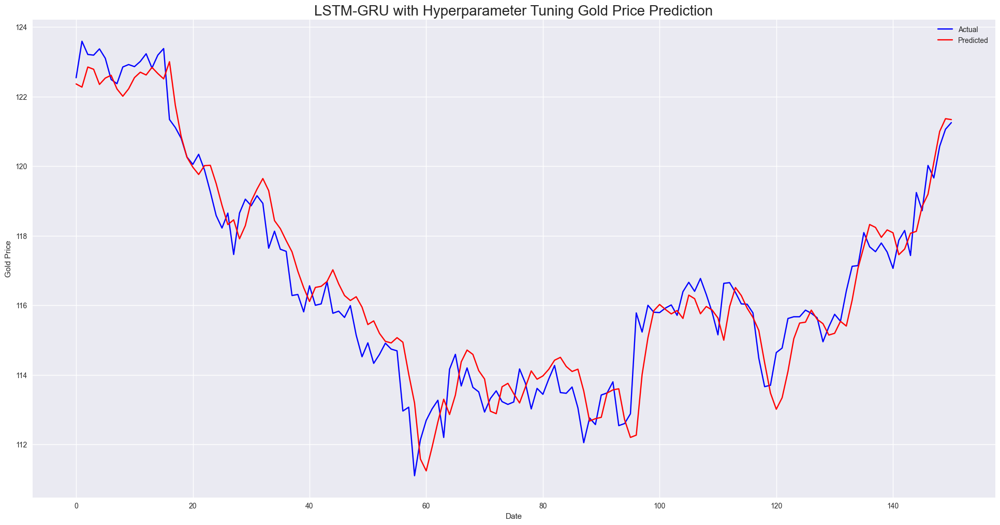

In [87]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-GRU",
    history=None, 
    training_time=lstm_gru_training_time,
    y_train=y_train_lstm_gru,
    y_test=y_test_lstm_gru,
    train_pred=lstm_gru_train_pred,
    test_pred=lstm_gru_test_pred,
    title_suffix="with Hyperparameter Tuning",
    is_tuned=True
)

# 8.0 Feature Engineering

## 8.1 Creating New Feature(s) for Enhanced Gold Price Forcasting

### 8.1.1 Creating New Feature Labeled "Daily Change"

The daily change (difference between open and close prices) tracks how much the price has moved within a single day, and higher daily changes can be an indication of higher volatility. If there's a significant difference between the opening and closing prices consistently, it suggests that there are external factors influencing the price of gold within the trading day.

In [88]:
# Daily Change for Gold
df["Daily_Change"] = abs(df["High"] - df["Low"])

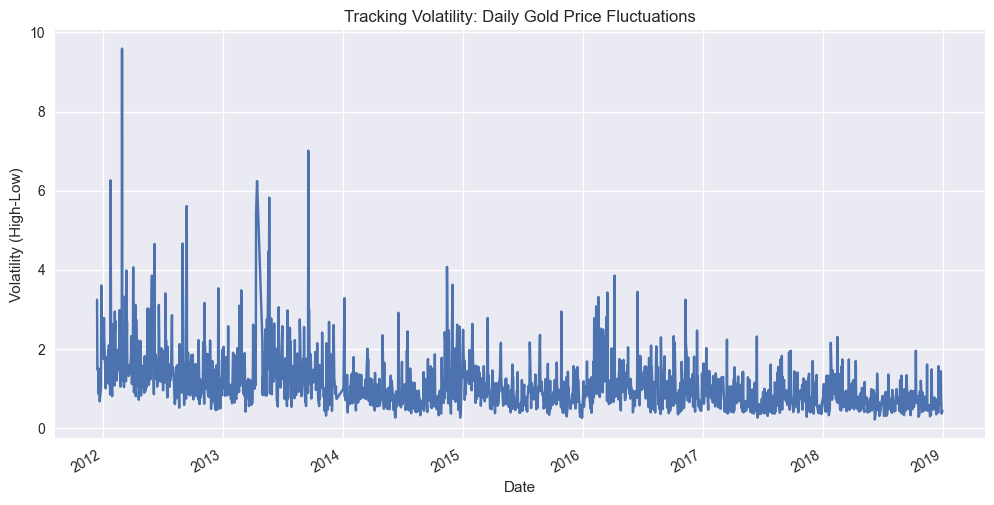

In [89]:
# Visualize the Volatility of Daily Gold Prices
plt.figure(figsize=(12,6))
df["Daily_Change"].plot()
plt.title("Tracking Volatility: Daily Gold Price Fluctuations")
plt.xlabel("Date")
plt.ylabel("Volatility (High-Low)")
plt.show()

### 8.1.2 Creating New Feature Labeled "Temporal Lag Predictors"

Temporal lag predictors represent the values from a previous time point. As an example, the lag value of 1 day would represent the previous day's value. For time series data, past values often influence future ones. These predictors can capture short-term temporal dependencies and seasonality in the data to help the model account for continuity in gold prices.

In [90]:
# Creating Temporal Lag for Gold Price (1 day)
df["Lag_1_Day"] = df["Adj Close"].shift(1)  # 1-day lag

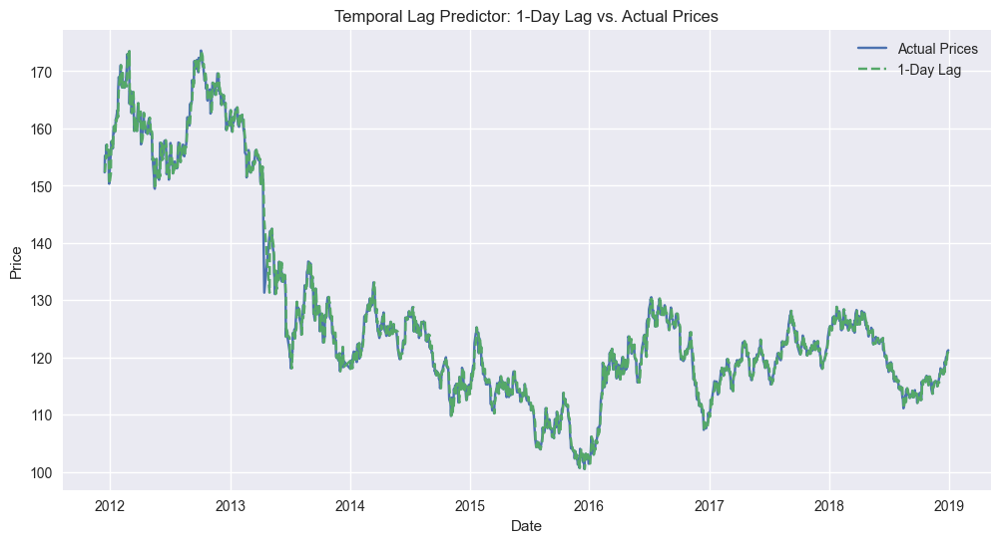

In [91]:
# Visualize the Lag Feature against Actual Prices
plt.figure(figsize=(12,6))
plt.plot(df.index, df["Adj Close"], label="Actual Prices")
plt.plot(df.index, df["Lag_1_Day"], label="1-Day Lag", linestyle="--")
plt.title("Temporal Lag Predictor: 1-Day Lag vs. Actual Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.legend()
plt.show()

### 8.1.3 Creating New Feature Labeled "Rolling Averages"

Rolling averages, also known as moving averages, smooth out fluctuations and highlight longer-term trends in time series data. This is achieved by averaging values over a specific window of time, reducing noise and highlighting trends. In the context of gold prices, a 7-day rolling average can capture weekly trends and reduce the impact of daily price fluctuations.

In [92]:
# Rolling Average for Gold (7 days)
df["Rolling_Avg_7_Day"] = df["Adj Close"].rolling(window=7).mean()

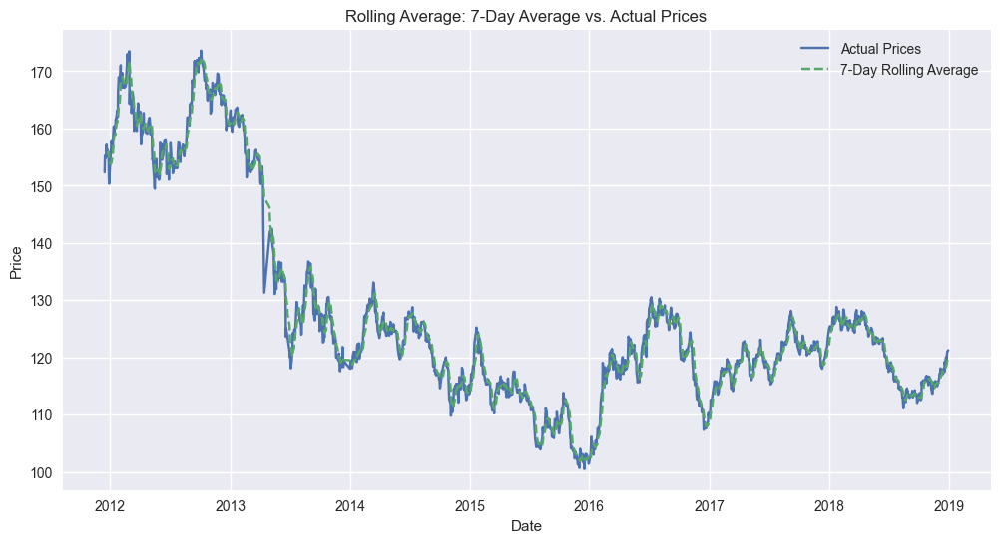

In [93]:
# Visualize the 7-Day Rolling Average against Actual Prices
plt.figure(figsize=(12,6))
plt.plot(df.index, df["Adj Close"], label="Actual Prices")
plt.plot(df.index, df["Rolling_Avg_7_Day"], label="7-Day Rolling Average", linestyle="--")
plt.title("Rolling Average: 7-Day Average vs. Actual Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.legend()
plt.show()

## 8.2 Dimension Reduction with Principal Component Analysis (PCA)

### 8.2.1 Mutual Information Scores between Variables

In [94]:
# Determine Mutual Information Scores
def compute_mi_scores (X, y):
    mi_scores = mutual_info_regression(X, y)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

# Compute mutual information scores
mi_scores = compute_mi_scores(gold_price, target_adj_close.values.ravel())

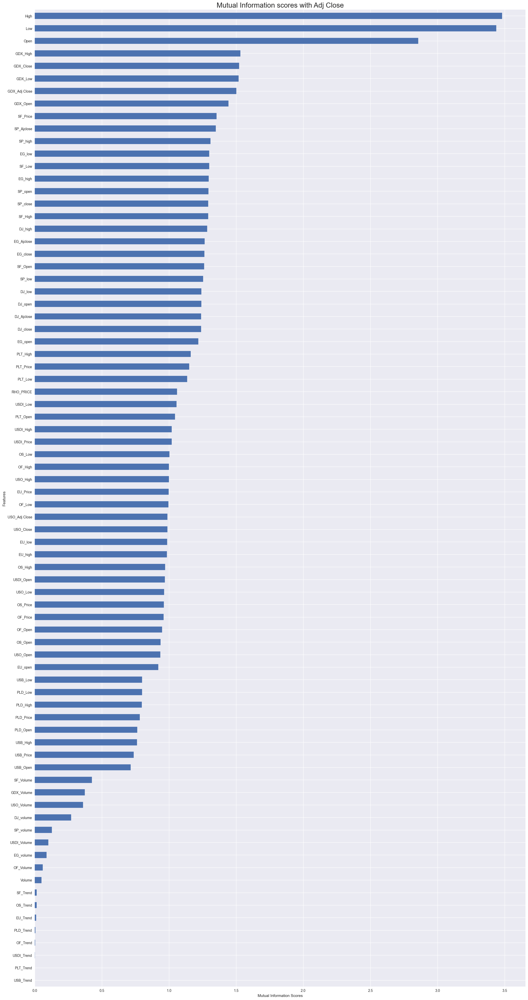

In [95]:
# Construct a Bar Plot
plt.figure(figsize=(25, 50))
mi_scores.sort_values(ascending=True).plot(kind='barh', grid=True)
plt.title("Mutual Information scores with Adj Close", fontsize=20)
plt.ylabel("Features")
plt.xlabel("Mutual Information Scores")
plt.show()

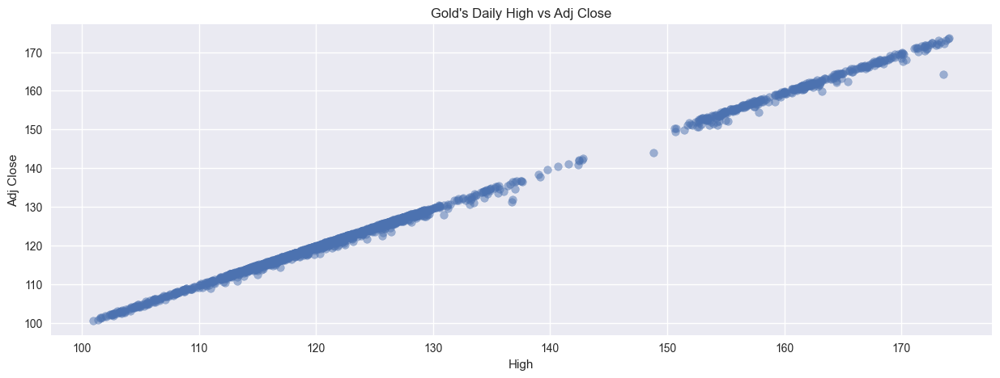

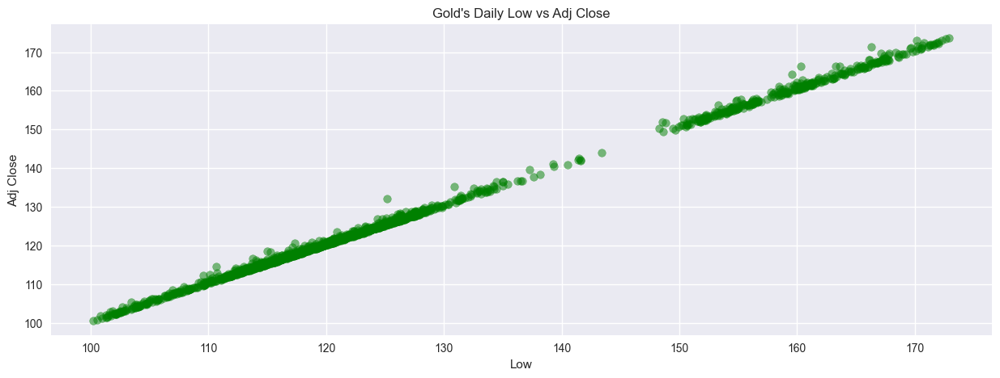

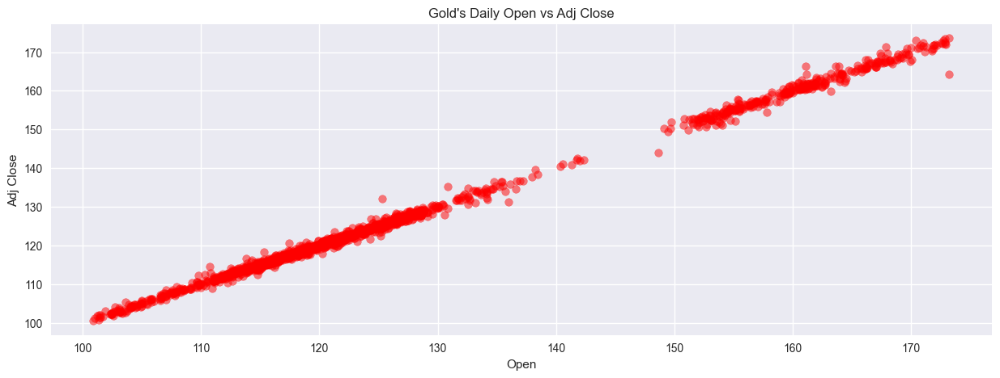

In [96]:
# Scatter plot for High vs Adj Close
plt.figure(figsize=(15, 5))
plt.scatter(df['High'], df['Adj Close'], alpha=0.5)
plt.title('Gold\'s Daily High vs Adj Close')
plt.xlabel('High')
plt.ylabel('Adj Close')
plt.grid(True)
plt.show()

# Scatter plot for Low vs Adj Close
plt.figure(figsize=(15, 5))
plt.scatter(df['Low'], df['Adj Close'], alpha=0.5, color='green')
plt.title('Gold\'s Daily Low vs Adj Close')
plt.xlabel('Low')
plt.ylabel('Adj Close')
plt.grid(True)
plt.show()

# Scatter plot for Open vs Adj Close
plt.figure(figsize=(15, 5))
plt.scatter(df['Open'], df['Adj Close'], alpha=0.5, color='red')
plt.title('Gold\'s Daily Open vs Adj Close')
plt.xlabel('Open')
plt.ylabel('Adj Close')
plt.grid(True)
plt.show()

### 8.2.2 Principal Component Analysis (PCA)

In [97]:
# Selecting and Displaying the top six features based on the mutual information scores
top_features = mi_scores.index[:6]

In [98]:
# Extracting the top features from the dummy dataset
top_features_df = gold_price[top_features]

# Scaling the top features
standardScaler = StandardScaler()
top_features_scaled = standardScaler.fit_transform(top_features_df)

In [99]:
# Apply PCA to to the scaled top features
pca = PCA(n_components=6)
principal_components = pca.fit_transform(top_features_scaled)

In [100]:
# Creating a DataFrame for the principal components
principal_components_df = pd.DataFrame(data=principal_components, 
                                       columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'],
                                       index=gold_price.index)

# Printing the tabulated principal components
principal_components_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6
Date,,,,,,
2011-12-15,4.787841,1.084599,0.062727,0.089798,0.020380,-0.008959
2011-12-16,4.897282,1.091703,-0.013287,-0.007825,-0.004371,-0.009337
2011-12-19,4.825189,0.920465,0.005723,0.050626,-0.030138,-0.008415
2011-12-20,5.093838,0.949803,-0.042894,-0.010263,0.000476,0.002432
2011-12-21,5.096977,0.962083,-0.020054,0.008794,0.007454,0.000329


In [101]:
# The loading scores for each component
loadings = pca.components_.T

# Create a DataFrame with the loading scores and the feature names as the index
loadings_df = pd.DataFrame(loadings, index=top_features, columns=[f'PC{i+1}' for i in range(6)])

# Display the loading scores for the PCA components
loadings_df

,PC1,PC2,PC3,PC4,PC5,PC6
High,0.408326,-0.401039,0.529359,-0.274509,0.192727,-0.528883
Low,0.408168,-0.413142,-0.558814,-0.298090,-0.510041,0.037945
Open,0.408236,-0.410488,0.040841,0.563978,0.321422,0.491724
GDX_High,0.408251,0.408309,0.433426,0.271772,-0.632694,0.067782
GDX_Close,0.408190,0.413960,0.021448,-0.583966,0.342671,0.450686
GDX_Low,0.408318,0.402371,-0.466389,0.320687,0.285792,-0.518978


# 9.0 Model Building, Training and Testing with Refined Hyperparameters

## 9.1 Modelling with New Features

In [102]:
# Scale the new features
df_scaled_new_features = scaler.fit_transform(df[['Daily_Change', 'Lag_1_Day', 'Rolling_Avg_7_Day']].fillna(method='bfill'))

# Create a DataFrame from the scaled features
df_scaled_new_features = pd.DataFrame(df_scaled_new_features, columns=['Daily_Change', 'Lag_1_Day', 'Rolling_Avg_7_Day'], index=df.index)

# Concatenate the scaled new features with the existing 'scaled_df'
new_scaled_df = pd.concat([scaled_df, df_scaled_new_features], axis=1)

# Display the New Normalized DataFrame
print("New Scaled DataFrame:")
new_scaled_df

New Scaled DataFrame:


C:\Users\60164\AppData\Local\Temp\ipykernel_26572\622413782.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_scaled_new_features = scaler.fit_transform(df[['Daily_Change', 'Lag_1_Day', 'Rolling_Avg_7_Day']].fillna(method='bfill'))


,Open,High,Low,EG_open,EG_high,EG_low,EG_close,EG_Ajclose,OF_Price,OF_Open,...,USDI_High,USDI_Low,GDX_Open,GDX_High,GDX_Low,GDX_Close,GDX_Adj Close,Daily_Change,Lag_1_Day,Rolling_Avg_7_Day
Date,,,,,,,,,,,,,,,,,,,,,
2011-12-15,0.744604,0.738369,0.708213,0.927031,0.937940,0.923507,0.910390,0.899367,0.785133,0.783233,...,0.079047,0.080869,0.899375,0.893381,0.882804,0.871333,0.866741,0.323027,0.708932,0.762139
2011-12-16,0.738655,0.744116,0.738341,0.914762,0.924504,0.939470,0.936364,0.925062,0.767439,0.769278,...,0.069712,0.073024,0.887996,0.894269,0.893396,0.893556,0.889119,0.134329,0.708932,0.762139
2011-12-19,0.754842,0.750821,0.744669,0.856645,0.856686,0.817746,0.803896,0.794015,0.770388,0.770500,...,0.072691,0.080668,0.887773,0.880275,0.870633,0.860000,0.855329,0.137527,0.748598,0.762139
2011-12-20,0.773381,0.772304,0.775210,0.822420,0.834933,0.841692,0.833766,0.823565,0.801810,0.777325,...,0.091360,0.077047,0.885319,0.895824,0.900834,0.900444,0.896056,0.068229,0.743674,0.762139
2011-12-21,0.775595,0.773673,0.769019,0.830815,0.851568,0.853665,0.853247,0.842836,0.811775,0.806356,...,0.071698,0.057534,0.902499,0.899822,0.901961,0.899778,0.895385,0.126865,0.772534,0.762139
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-24,0.258024,0.262042,0.266061,0.002325,0.002559,0.002262,0.001948,0.001995,0.229713,0.259753,...,0.707051,0.714142,0.178492,0.181919,0.185936,0.191556,0.208286,0.038380,0.249214,0.233722
2018-12-26,0.272551,0.273810,0.266061,0.002970,0.002559,0.002262,0.002597,0.002660,0.270388,0.232759,...,0.715392,0.720177,0.192994,0.188361,0.183232,0.181111,0.197188,0.130064,0.266995,0.238998
2018-12-27,0.271859,0.272441,0.273903,0.002325,0.001919,0.002262,0.001948,0.001995,0.246899,0.271570,...,0.709235,0.716757,0.181615,0.179476,0.187063,0.188889,0.205452,0.058636,0.262071,0.244476


In [103]:
# Checking for Missing Values
missing_values = new_scaled_df.isnull().values.any()
print("Missing Values: ", missing_values)

# Checking for Missing Values in Each Individual Column
missing_values = new_scaled_df.isnull().sum()
print("Missing Values in Each Individual Column: ")
print(missing_values)

# Handling Missing Values (Replace with the Mean of the Respective Column)
if missing_values.any():
    # Calculate the mean of each column
    column_means = new_scaled_df.mean()
    
    # Replace missing values with column means
    new_scaled_df.fillna(column_means, inplace=True)
    print(colored("Missing values replaced with column means.", color = "green", attrs = ["bold", "dark"]))
else:
    print(colored("No missing values found. Data is already clean.", color = "green", attrs = ["bold", "dark"]))

Missing Values:  False
Missing Values in Each Individual Column: 
Open                 0
High                 0
Low                  0
EG_open              0
EG_high              0
EG_low               0
EG_close             0
EG_Ajclose           0
OF_Price             0
OF_Open              0
OF_High              0
OF_Low               0
SF_Price             0
SF_Open              0
SF_High              0
SF_Low               0
SF_Volume            0
PLT_Price            0
PLT_Open             0
PLT_High             0
PLT_Low              0
USDI_Price           0
USDI_Open            0
USDI_High            0
USDI_Low             0
GDX_Open             0
GDX_High             0
GDX_Low              0
GDX_Close            0
GDX_Adj Close        0
Daily_Change         0
Lag_1_Day            0
Rolling_Avg_7_Day    0
dtype: int64
No missing values found. Data is already clean.


In [104]:
# Create the training and test sets using the indices provided by TimeSeriesSplit
for train_index, test_index in tscv.split(new_scaled_df):
        X_train_nf, X_test_nf = new_scaled_df[:len(train_index)], new_scaled_df[len(train_index): (len(train_index)+len(test_index))]
        y_train_nf, y_test_nf = target_adj_close[:len(train_index)].values.ravel(), target_adj_close[len(train_index): (len(train_index)+len(test_index))].values.ravel()

In [105]:
X_train_nf.shape

(1562, 33)

In [106]:
X_test_nf.shape

(156, 33)

In [107]:
y_train_nf.shape

(1562,)

In [108]:
y_test_nf.shape

(156,)

### 9.1.1 Benchmark Model: Long Short-Term Memory (LSTM) with New Features

In [109]:
# Reshape datasets suitable for LSTM input
X_train_lstm_nf, y_train_lstm_nf = create_dataset(X_train_nf, y_train_nf, time_steps)
X_test_lstm_nf, y_test_lstm_nf = create_dataset(X_test_nf, y_test_nf, time_steps)

# Check the shapes of the inputs and outputs
print(f"X_train_lstm_nf shape: {X_train_lstm_nf.shape}")
print(f"y_train_lstm_nf shape: {y_train_lstm_nf.shape}")
print(f"X_test_lstm_nf shape: {X_test_lstm_nf.shape}")
print(f"y_test_lstm_nf shape: {y_test_lstm_nf.shape}")

X_train_lstm_nf shape: (1557, 5, 33)
y_train_lstm_nf shape: (1557,)
X_test_lstm_nf shape: (151, 5, 33)
y_test_lstm_nf shape: (151,)


In [110]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_nf_model, best_lstm_nf_hyperparameters, lstm_nf_tuner, lstm_nf_training_time, lstm_nf_test_pred, lstm_nf_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_nf, 
    y_train=y_train_lstm_nf, 
    X_test=X_test_lstm_nf, 
    y_test=y_test_lstm_nf, 
    build_model_function=build_lstm_hyperpara_model,
    project_name='output_lstm_nf',
    checkpoint_name='lstm_nf'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_nf\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_nf\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 2ms/step


In [111]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_nf_model, 
    tuner=lstm_nf_tuner, 
    X_train=X_train_lstm_nf, 
    y_train=y_train_lstm_nf, 
    X_test=X_test_lstm_nf, 
    y_test=y_test_lstm_nf, 
    model_save_path="best_lstm_model_with_new_features.keras"
)

Loss on training set: 2.918056011199951
Loss on test set: 0.6828223466873169 

Best Hyperparameter Values: {'lstm_units': 62, 'dropout_rate': 0.0} 

Results summary
Results in hyperparameter_tuning\output_lstm_nf
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 09 summary
Hyperparameters:
lstm_units: 62
dropout_rate: 0.0
Score: 0.6828223466873169

Trial 00 summary
Hyperparameters:
lstm_units: 18
dropout_rate: 0.0
Score: 0.8683902025222778

Trial 06 summary
Hyperparameters:
lstm_units: 60
dropout_rate: 0.1
Score: 0.9144299030303955

Trial 08 summary
Hyperparameters:
lstm_units: 64
dropout_rate: 0.30000000000000004
Score: 1.17295503616333

Trial 01 summary
Hyperparameters:
lstm_units: 54
dropout_rate: 0.30000000000000004
Score: 1.313751220703125

Trial 04 summary
Hyperparameters:
lstm_units: 12
dropout_rate: 0.1
Score: 1.369018793106079

Trial 02 summary
Hyperparameters:
lstm_units: 33
dropout_rate: 0.30000000000000004
Score: 1.3890286684036255

Trial 05 summary



Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 62)             23808     
                                                                 
 dropout (Dropout)           (None, 5, 62)             0         
                                                                 
 lstm_1 (LSTM)               (None, 62)                31000     
                                                                 
 dropout_1 (Dropout)         (None, 62)                0         
                                                                 
 dense (Dense)               (None, 25)                1575      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 56409 (220.35 KB)
Tra

Time Measurement and Monitoring for LSTM with New Features and Hyperparameter Tuning
Training time: 3 minutes and 52.45 seconds

Training Evaluation Metrics for LSTM with New Features and Hyperparameter Tuning
Training R2 Score: 0.9909803964587939
Training Mean Absolute Error (MAE): 1.2253875105687644
Training Root Mean Squared Error (RMSE): 1.7082318779683634
Training Mean Absolute Percentage Error (MAPE): 0.9110139486945079 %

Testing Evaluation Metrics for LSTM with New Features and Hyperparameter Tuning
R2 Score: 0.9300898241939163
Mean Absolute Error (MAE): 0.6382348290142538
Root Mean Squared Error (RMSE): 0.8263306630759776
Mean Absolute Percentage Error (MAPE): 0.5493411399296397 %


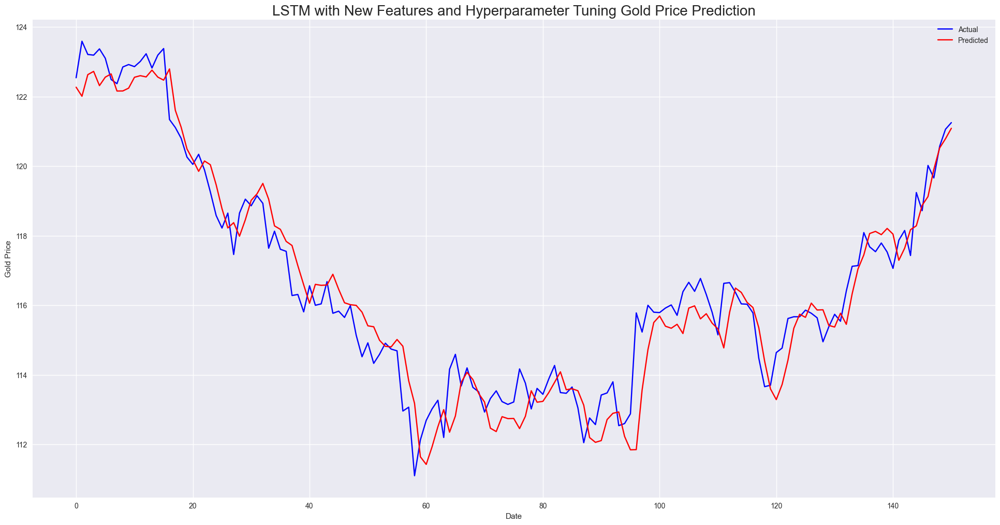

In [112]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM with New Features",
    history=None, 
    training_time=lstm_nf_training_time,
    y_train=y_train_lstm_nf,
    y_test=y_test_lstm_nf,
    train_pred=lstm_nf_train_pred,
    test_pred=lstm_nf_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.1.2 Solution Model: LSTM-CNN with New Features

In [113]:
# Reshape datasets suitable for LSTM-CNN input
X_train_lstm_cnn_nf, y_train_lstm_cnn_nf = create_dataset(X_train_nf, y_train_nf, time_steps)
X_test_lstm_cnn_nf, y_test_lstm_cnn_nf = create_dataset(X_test_nf, y_test_nf, time_steps)

# Check the shapes of the inputs and outputs
print(f"X_train_lstm_cnn shape: {X_train_lstm_cnn_nf.shape}")
print(f"y_train_lstm_cnn shape: {y_train_lstm_cnn_nf.shape}")
print(f"X_test_lstm_cnn shape: {X_test_lstm_cnn_nf.shape}")
print(f"y_test_lstm_cnn shape: {y_test_lstm_cnn_nf.shape}")

X_train_lstm_cnn shape: (1557, 5, 33)
y_train_lstm_cnn shape: (1557,)
X_test_lstm_cnn shape: (151, 5, 33)
y_test_lstm_cnn shape: (151,)


In [114]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_cnn_nf_model, best_lstm_cnn_nf_hyperparameters, lstm_cnn_nf_tuner, lstm_cnn_nf_training_time, lstm_cnn_nf_test_pred, lstm_cnn_nf_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_cnn_nf, 
    y_train=y_train_lstm_cnn_nf, 
    X_test=X_test_lstm_cnn_nf, 
    y_test=y_test_lstm_cnn_nf, 
    build_model_function=build_lstm_cnn_hyperpara_model,
    project_name='output_lstm_cnn_nf',
    checkpoint_name='lstm_cnn_nf'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn_nf\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn_nf\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 2ms/step


In [115]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_cnn_nf_model, 
    tuner=lstm_cnn_nf_tuner, 
    X_train=X_train_lstm_cnn_nf, 
    y_train=y_train_lstm_cnn_nf, 
    X_test=X_test_lstm_cnn_nf, 
    y_test=y_test_lstm_cnn_nf, 
    model_save_path="best_lstm_cnn_model_with_new_features.keras"
)

Loss on training set: 3.2824902534484863
Loss on test set: 1.0940197706222534 

Best Hyperparameter Values: {'lstm_units': 96, 'lstm_dropout_rate': 0.0, 'cnn_filters': 32, 'kernel_size': 2, 'dense_units': 48} 

Results summary
Results in hyperparameter_tuning\output_lstm_cnn_nf
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 09 summary
Hyperparameters:
lstm_units: 96
lstm_dropout_rate: 0.0
cnn_filters: 32
kernel_size: 2
dense_units: 48
Score: 1.0940197706222534

Trial 02 summary
Hyperparameters:
lstm_units: 96
lstm_dropout_rate: 0.2
cnn_filters: 64
kernel_size: 2
dense_units: 16
Score: 1.1728200912475586

Trial 00 summary
Hyperparameters:
lstm_units: 32
lstm_dropout_rate: 0.0
cnn_filters: 32
kernel_size: 1
dense_units: 112
Score: 1.4572080373764038

Trial 06 summary
Hyperparameters:
lstm_units: 96
lstm_dropout_rate: 0.2
cnn_filters: 128
kernel_size: 3
dense_units: 112
Score: 1.742004632949829

Trial 04 summary
Hyperparameters:
lstm_units: 128
lstm_dropout_rate


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 96)             49920     
                                                                 
 dropout (Dropout)           (None, 5, 96)             0         
                                                                 
 lstm_1 (LSTM)               (None, 5, 96)             74112     
                                                                 
 dropout_1 (Dropout)         (None, 5, 96)             0         
                                                                 
 conv1d (Conv1D)             (None, 4, 32)             6176      
                                                                 
 max_pooling1d (MaxPooling1  (None, 2, 32)             0         
 D)                                                              
                                   

Time Measurement and Monitoring for LSTM-CNN with New Features and Hyperparameter Tuning
Training time: 5 minutes and 5.70 seconds

Training Evaluation Metrics for LSTM-CNN with New Features and Hyperparameter Tuning
Training R2 Score: 0.9898539436804463
Training Mean Absolute Error (MAE): 1.3684927904247952
Training Root Mean Squared Error (RMSE): 1.8117644436855889
Training Mean Absolute Percentage Error (MAPE): 1.0485652243762609 %

Testing Evaluation Metrics for LSTM-CNN with New Features and Hyperparameter Tuning
R2 Score: 0.8879897239504283
Mean Absolute Error (MAE): 0.835315573177515
Root Mean Squared Error (RMSE): 1.0459540485700665
Mean Absolute Percentage Error (MAPE): 0.7185960083552999 %


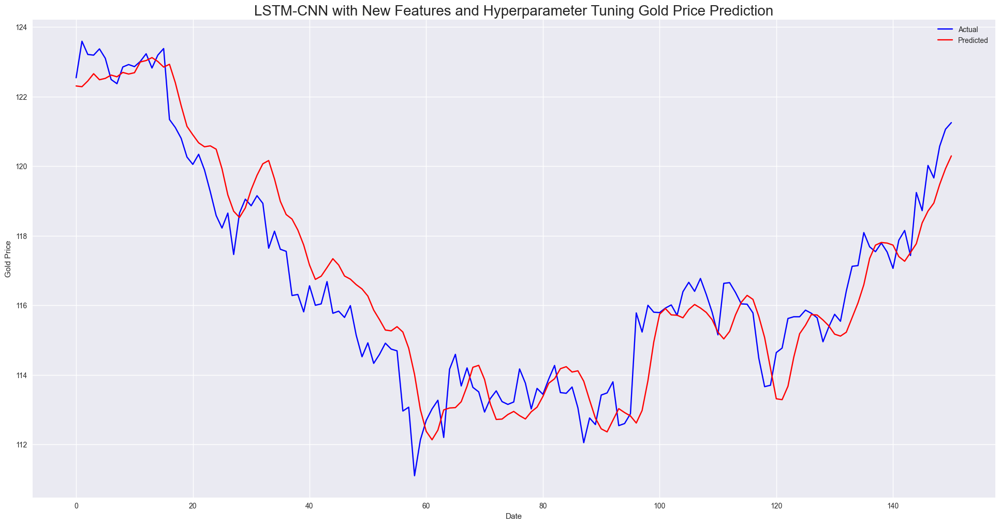

In [116]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-CNN with New Features",
    history=None, 
    training_time=lstm_cnn_nf_training_time,
    y_train=y_train_lstm_cnn_nf,
    y_test=y_test_lstm_cnn_nf,
    train_pred=lstm_cnn_nf_train_pred,
    test_pred=lstm_cnn_nf_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.1.3 Solution Model: BiLSTM-CNN with New Features

In [117]:
# Reshape datasets suitable for BiLSTM-CNN input
X_train_bilstm_cnn_nf, y_train_bilstm_cnn_nf = create_dataset(X_train_nf, y_train_nf, time_steps)
X_test_bilstm_cnn_nf, y_test_bilstm_cnn_nf = create_dataset(X_test_nf, y_test_nf, time_steps)

# Check the shapes of the inputs and outputs
print(f"X_train_bilstm_cnn shape: {X_train_bilstm_cnn_nf.shape}")
print(f"y_train_bilstm_cnn shape: {y_train_bilstm_cnn_nf.shape}")
print(f"X_test_bilstm_cnn shape: {X_test_bilstm_cnn_nf.shape}")
print(f"y_test_bilstm_cnn shape: {y_test_bilstm_cnn_nf.shape}")

X_train_bilstm_cnn shape: (1557, 5, 33)
y_train_bilstm_cnn shape: (1557,)
X_test_bilstm_cnn shape: (151, 5, 33)
y_test_bilstm_cnn shape: (151,)


In [118]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_bilstm_cnn_nf_model, best_bilstm_cnn_nf_hyperparameters, bilstm_cnn_nf_tuner, bilstm_cnn_nf_training_time, bilstm_cnn_nf_test_pred, bilstm_cnn_nf_train_pred = tune_hyperparameters(
    X_train=X_train_bilstm_cnn_nf, 
    y_train=y_train_bilstm_cnn_nf, 
    X_test=X_test_bilstm_cnn_nf, 
    y_test=y_test_bilstm_cnn_nf, 
    build_model_function=build_bilstm_cnn_hyperpara_model,
    project_name='output_bilstm_cnn_nf',
    checkpoint_name='bilstm_cnn_nf'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn_nf\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn_nf\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 3ms/step


In [119]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_bilstm_cnn_nf_model, 
    tuner=bilstm_cnn_nf_tuner, 
    X_train=X_train_bilstm_cnn_nf, 
    y_train=y_train_bilstm_cnn_nf, 
    X_test=X_test_bilstm_cnn_nf, 
    y_test=y_test_bilstm_cnn_nf, 
    model_save_path="best_bilstm_cnn_model_with_new_features.keras"
)

Loss on training set: 2.302975654602051
Loss on test set: 0.6166566014289856 

Best Hyperparameter Values: {'lstm_units': 96, 'lstm_dropout_rate': 0.05, 'cnn_filters': 224, 'kernel_size': 6, 'dense_units': 150} 

Results summary
Results in hyperparameter_tuning\output_bilstm_cnn_nf
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 03 summary
Hyperparameters:
lstm_units: 96
lstm_dropout_rate: 0.05
cnn_filters: 224
kernel_size: 6
dense_units: 150
Score: 0.6166566014289856

Trial 09 summary
Hyperparameters:
lstm_units: 192
lstm_dropout_rate: 0.2
cnn_filters: 32
kernel_size: 6
dense_units: 230
Score: 0.7255412340164185

Trial 05 summary
Hyperparameters:
lstm_units: 224
lstm_dropout_rate: 0.45
cnn_filters: 256
kernel_size: 5
dense_units: 150
Score: 0.8785926699638367

Trial 08 summary
Hyperparameters:
lstm_units: 192
lstm_dropout_rate: 0.25
cnn_filters: 32
kernel_size: 5
dense_units: 50
Score: 0.896083414554596

Trial 00 summary
Hyperparameters:
lstm_units: 224
lstm_


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 5, 192)            99840     
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 5, 192)            0         
                                                                 
 bidirectional_1 (Bidirecti  (None, 5, 192)            221952    
 onal)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 5, 192)            0         
                                                                 
 conv1d (Conv1D)             (None, 3, 224)            129248    
                                                                 
 max_pooling1d (MaxPooling1  (None,

Time Measurement and Monitoring for BiLSTM-CNN with New Features and Hyperparameter Tuning
Training time: 10 minutes and 24.04 seconds

Training Evaluation Metrics for BiLSTM-CNN with New Features and Hyperparameter Tuning
Training R2 Score: 0.9928815879188277
Training Mean Absolute Error (MAE): 1.1089048464915252
Training Root Mean Squared Error (RMSE): 1.5175557712044405
Training Mean Absolute Percentage Error (MAPE): 0.8578340749697756 %

Testing Evaluation Metrics for BiLSTM-CNN with New Features and Hyperparameter Tuning
R2 Score: 0.9368641434185422
Mean Absolute Error (MAE): 0.6097365267099546
Root Mean Squared Error (RMSE): 0.7852748888803117
Mean Absolute Percentage Error (MAPE): 0.5243774392462361 %


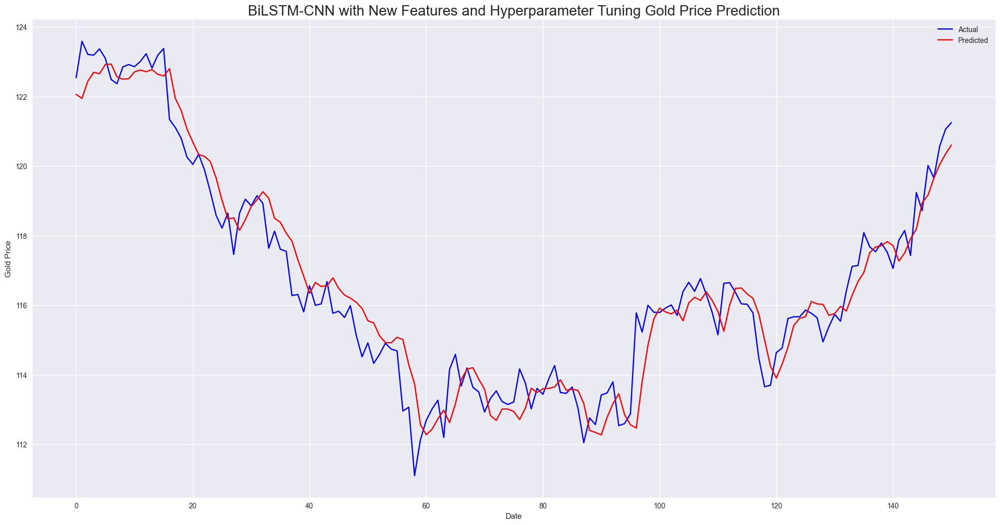

In [120]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="BiLSTM-CNN with New Features",
    history=None, 
    training_time=bilstm_cnn_nf_training_time,
    y_train=y_train_bilstm_cnn_nf,
    y_test=y_test_bilstm_cnn_nf,
    train_pred=bilstm_cnn_nf_train_pred,
    test_pred=bilstm_cnn_nf_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.1.4 Solution Model: LSTM-GRU with New Features

In [121]:
# Reshape datasets suitable for LSTM-GRU input
X_train_lstm_gru_nf, y_train_lstm_gru_nf = create_dataset(X_train_nf, y_train_nf, time_steps)
X_test_lstm_gru_nf, y_test_lstm_gru_nf = create_dataset(X_test_nf, y_test_nf, time_steps)

# Check the shapes of the inputs and outputs
print(f"X_train_lstm_gru shape: {X_train_lstm_gru_nf.shape}")
print(f"y_train_lstm_gru shape: {y_train_lstm_gru_nf.shape}")
print(f"X_test_lstm_gru shape: {X_test_lstm_gru_nf.shape}")
print(f"y_test_lstm_gru shape: {y_test_lstm_gru_nf.shape}")

X_train_lstm_gru shape: (1557, 5, 33)
y_train_lstm_gru shape: (1557,)
X_test_lstm_gru shape: (151, 5, 33)
y_test_lstm_gru shape: (151,)


In [122]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_gru_nf_model, best_lstm_gru_nf_hyperparameters, lstm_gru_nf_tuner, lstm_gru_nf_training_time, lstm_gru_nf_test_pred, lstm_gru_nf_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_gru_nf, 
    y_train=y_train_lstm_gru_nf, 
    X_test=X_test_lstm_gru_nf, 
    y_test=y_test_lstm_gru_nf, 
    build_model_function=build_lstm_gru_hyperpara_model,
    project_name='output_lstm_gru_nf',
    checkpoint_name='lstm_gru_nf'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru_nf\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru_nf\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 2ms/step


In [123]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_gru_nf_model, 
    tuner=lstm_gru_nf_tuner, 
    X_train=X_train_lstm_gru_nf, 
    y_train=y_train_lstm_gru_nf, 
    X_test=X_test_lstm_gru_nf, 
    y_test=y_test_lstm_gru_nf, 
    model_save_path="best_lstm_gru_model_with_new_features.keras"
)

Loss on training set: 2.163109540939331
Loss on test set: 0.6168034076690674 

Best Hyperparameter Values: {'lstm_units': 53, 'gru_units': 58, 'dense_units': 31, 'dropout_rate': 0.0} 

Results summary
Results in hyperparameter_tuning\output_lstm_gru_nf
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 09 summary
Hyperparameters:
lstm_units: 53
gru_units: 58
dense_units: 31
dropout_rate: 0.0
Score: 0.6168034076690674

Trial 08 summary
Hyperparameters:
lstm_units: 20
gru_units: 13
dense_units: 62
dropout_rate: 0.0
Score: 0.6642787456512451

Trial 07 summary
Hyperparameters:
lstm_units: 38
gru_units: 59
dense_units: 59
dropout_rate: 0.1
Score: 0.8098757863044739

Trial 05 summary
Hyperparameters:
lstm_units: 9
gru_units: 16
dense_units: 52
dropout_rate: 0.0
Score: 0.8260921239852905

Trial 00 summary
Hyperparameters:
lstm_units: 11
gru_units: 19
dense_units: 3
dropout_rate: 0.0
Score: 1.147691249847412

Trial 03 summary
Hyperparameters:
lstm_units: 26
gru_units: 63


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 5, 53)             18444     
                                                                 
 dropout (Dropout)           (None, 5, 53)             0         
                                                                 
 gru (GRU)                   (None, 58)                19662     
                                                                 
 dropout_1 (Dropout)         (None, 58)                0         
                                                                 
 dense (Dense)               (None, 31)                1829      
                                                                 
 dense_1 (Dense)             (None, 1)                 32        
                                                                 
Total params: 39967 (156.12 KB)
Tra

Time Measurement and Monitoring for LSTM-GRU with New Features and Hyperparameter Tuning
Training time: 4 minutes and 25.09 seconds

Training Evaluation Metrics for LSTM-GRU with New Features and Hyperparameter Tuning
Training R2 Score: 0.9933139089538742
Training Mean Absolute Error (MAE): 1.0901899251512197
Training Root Mean Squared Error (RMSE): 1.4707513002731127
Training Mean Absolute Percentage Error (MAPE): 0.8453463808461905 %

Testing Evaluation Metrics for LSTM-GRU with New Features and Hyperparameter Tuning
R2 Score: 0.9368491169521864
Mean Absolute Error (MAE): 0.599245473325616
Root Mean Squared Error (RMSE): 0.7853683318564549
Mean Absolute Percentage Error (MAPE): 0.5152890082350899 %


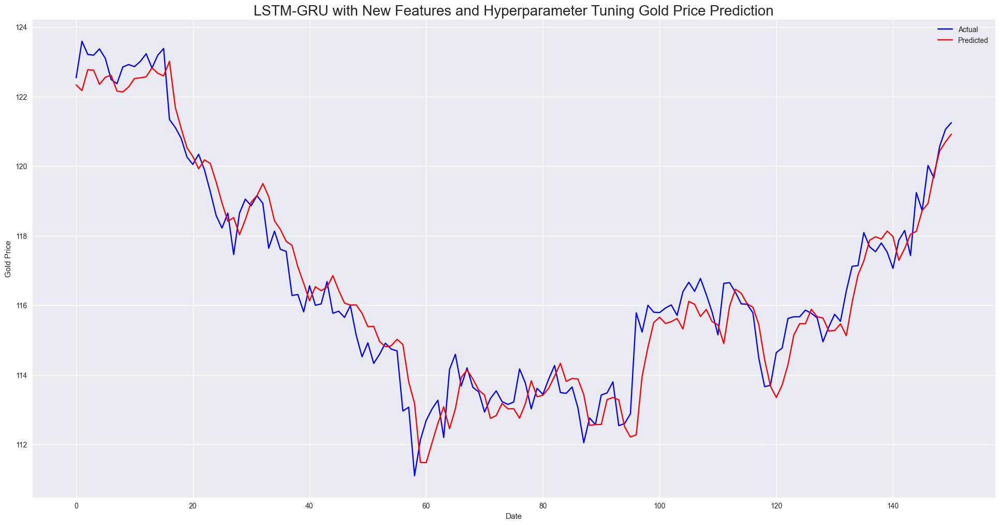

In [124]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-GRU with New Features",
    history=None, 
    training_time=lstm_gru_nf_training_time,
    y_train=y_train_lstm_gru_nf,
    y_test=y_test_lstm_gru_nf,
    train_pred=lstm_gru_nf_train_pred,
    test_pred=lstm_gru_nf_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

## 9.2 Modelling with PCA

The introduction of PCA-transformed data alters the feature space by reducing dimensionality and changing the nature of input variables. These principal components encapsulate variance in a manner different from the original features, and this transformation necessitates a reassessment of the model's hyperparameters. Moreover, the reduction to a single timestep impacts the assumptions of temporal dependencies within the LSTM-CNN and BiLSTM-CNN architectures, particularly the convolutional layers expecting sequences longer than one. Retuning ensures that the models are optimized for the new data structure, can capture the essence of the transformed features effectively, and are adjusted for potential shifts in data distribution and complexity. This step is crucial for maintaining the models' predictive accuracy and generalization capabilities in the face of significant changes to the input data format and content.

In [125]:
# Create the training and test sets using the indices provided by TimeSeriesSplit
for train_index, test_index in tscv.split(principal_components_df):
        X_train_pca, X_test_pca = principal_components_df[:len(train_index)], principal_components_df[len(train_index): (len(train_index)+len(test_index))]
        y_train_pca, y_test_pca = target_adj_close[:len(train_index)].values.ravel(), target_adj_close[len(train_index): (len(train_index)+len(test_index))].values.ravel()

In [126]:
X_train_pca.shape

(1562, 6)

In [127]:
X_test_pca.shape

(156, 6)

In [128]:
y_train_pca.shape

(1562,)

In [129]:
y_test_pca.shape

(156,)

### 9.2.1 Benchmark Model: Long Short-Term Memory (LSTM) with PCA

In [130]:
# Reshape data for LSTM input
X_train_lstm_pca = X_train_pca.values.reshape((X_train_pca.shape[0], 1, X_train_pca.shape[1]))
X_test_lstm_pca = X_test_pca.values.reshape((X_test_pca.shape[0], 1, X_test_pca.shape[1]))

# Check the shape of the training and testing data
print(f"X_train_lstm_pca shape: {X_train_lstm_pca.shape}")
print(f"X_test_lstm_pca shape: {X_test_lstm_pca.shape}")

X_train_lstm_pca shape: (1562, 1, 6)
X_test_lstm_pca shape: (156, 1, 6)


In [131]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_pca_model, best_lstm_pca_hyperparameters, lstm_pca_tuner, lstm_pca_training_time, lstm_pca_test_pred, lstm_pca_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_pca, 
    y_test=y_test_pca, 
    build_model_function=build_lstm_hyperpara_model,
    project_name='output_lstm_pca',
    checkpoint_name='lstm_pca'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_pca\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_pca\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 983us/step


In [132]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_pca_model, 
    tuner=lstm_pca_tuner, 
    X_train=X_train_lstm_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_pca, 
    y_test=y_test_pca, 
    model_save_path="best_lstm_model_with_pca.keras"
)

Loss on training set: 0.11934315413236618
Loss on test set: 0.03374689444899559 

Best Hyperparameter Values: {'lstm_units': 50, 'dropout_rate': 0.0} 

Results summary
Results in hyperparameter_tuning\output_lstm_pca
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 09 summary
Hyperparameters:
lstm_units: 50
dropout_rate: 0.0
Score: 0.03374689444899559

Trial 00 summary
Hyperparameters:
lstm_units: 34
dropout_rate: 0.2
Score: 0.05393853038549423

Trial 04 summary
Hyperparameters:
lstm_units: 54
dropout_rate: 0.1
Score: 0.0642458125948906

Trial 01 summary
Hyperparameters:
lstm_units: 57
dropout_rate: 0.4
Score: 0.06571832299232483

Trial 08 summary
Hyperparameters:
lstm_units: 63
dropout_rate: 0.0
Score: 0.07332752645015717

Trial 03 summary
Hyperparameters:
lstm_units: 23
dropout_rate: 0.1
Score: 0.11473231762647629

Trial 07 summary
Hyperparameters:
lstm_units: 40
dropout_rate: 0.1
Score: 0.14265283942222595

Trial 06 summary
Hyperparameters:
lstm_units: 54
dr


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 50)             11400     
                                                                 
 dropout (Dropout)           (None, 1, 50)             0         
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dropout_1 (Dropout)         (None, 50)                0         
                                                                 
 dense (Dense)               (None, 25)                1275      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 32901 (128.52 KB)
Tra

Time Measurement and Monitoring for LSTM with PCA and Hyperparameter Tuning
Training time: 3 minutes and 4.95 seconds

Training Evaluation Metrics for LSTM with PCA and Hyperparameter Tuning
Training R2 Score: 0.9996325971982715
Training Mean Absolute Error (MAE): 0.2510650159651085
Training Root Mean Squared Error (RMSE): 0.34546081609060275
Training Mean Absolute Percentage Error (MAPE): 0.19273534743049614 %

Testing Evaluation Metrics for LSTM with PCA and Hyperparameter Tuning
R2 Score: 0.9967828195933081
Mean Absolute Error (MAE): 0.14526020570412657
Root Mean Squared Error (RMSE): 0.18370327499828942
Mean Absolute Percentage Error (MAPE): 0.1251205382773876 %


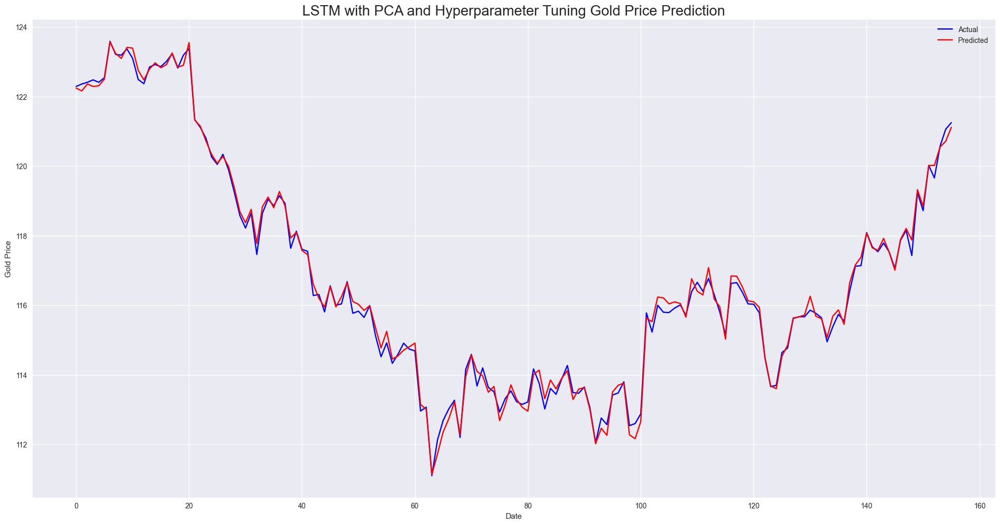

In [133]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM with PCA",
    history=None, 
    training_time=lstm_pca_training_time,
    y_train=y_train_pca,
    y_test=y_test_pca,
    train_pred=lstm_pca_train_pred,
    test_pred=lstm_pca_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.2.2 Solution Model: LSTM-CNN with PCA

In [134]:
# Reshape data for LSTM-CNN input
X_train_lstm_cnn_pca = X_train_pca.values.reshape(X_train_pca.shape[0], 1, X_train_pca.shape[1])
X_test_lstm_cnn_pca = X_test_pca.values.reshape(X_test_pca.shape[0], 1, X_test_pca.shape[1])

# Check the shape of the training and testing data
print(f"X_train_lstm_cnn_pca shape: {X_train_lstm_cnn_pca.shape}")
print(f"X_test_lstm_cnn_pca shape: {X_test_lstm_cnn_pca.shape}")

X_train_lstm_cnn_pca shape: (1562, 1, 6)
X_test_lstm_cnn_pca shape: (156, 1, 6)


In [135]:
# Modify the LSTM-CNN model builder
def build_lstm_cnn_pca_hyperpara_model(hp, input_shape):
    # LSTM layers hyperparameters
    lstm_units = hp.Int('lstm_units', min_value=32, max_value=256, step=32)
    lstm_dropout_rate = hp.Float('lstm_dropout_rate', min_value=0.0, max_value=0.5, step=0.05)
    
    # CNN layers hyperparameters
    cnn_filters = hp.Int('cnn_filters', min_value=32, max_value=256, step=32)
    cnn_dropout_rate = hp.Float('cnn_dropout_rate', min_value=0.0, max_value=0.5, step=0.05)
    
    model = Sequential()
    
    # 1st LSTM layer
    model.add(LSTM(units=lstm_units, return_sequences=True, input_shape=input_shape, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # 2nd LSTM layer
    model.add(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform'))
    model.add(Dropout(rate=lstm_dropout_rate))
    
    # CNN layers
    model.add(Conv1D(filters=cnn_filters, kernel_size=1, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Flatten())
    
    # Dense layers
    model.add(Dense(25, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))

    # Compile the model
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

In [136]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_cnn_pca_model, best_lstm_cnn_pca_hyperparameters, lstm_cnn_pca_tuner, lstm_cnn_pca_training_time, lstm_cnn_pca_test_pred, lstm_cnn_pca_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_cnn_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_cnn_pca, 
    y_test=y_test_pca, 
    build_model_function=build_lstm_cnn_pca_hyperpara_model,
    project_name='output_lstm_cnn_pca',
    checkpoint_name='lstm_cnn_pca'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn_pca\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_cnn_pca\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 1ms/step


In [137]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_cnn_pca_model, 
    tuner=lstm_cnn_pca_tuner, 
    X_train=X_train_lstm_cnn_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_cnn_pca, 
    y_test=y_test_pca, 
    model_save_path="best_lstm_cnn_model_with_pca.keras"
)

Loss on training set: 0.2069791853427887
Loss on test set: 0.023005684837698936 

Best Hyperparameter Values: {'lstm_units': 64, 'lstm_dropout_rate': 0.0, 'cnn_filters': 256, 'cnn_dropout_rate': 0.25} 

Results summary
Results in hyperparameter_tuning\output_lstm_cnn_pca
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 04 summary
Hyperparameters:
lstm_units: 64
lstm_dropout_rate: 0.0
cnn_filters: 256
cnn_dropout_rate: 0.25
Score: 0.023005684837698936

Trial 00 summary
Hyperparameters:
lstm_units: 128
lstm_dropout_rate: 0.0
cnn_filters: 256
cnn_dropout_rate: 0.45
Score: 0.025876998901367188

Trial 08 summary
Hyperparameters:
lstm_units: 160
lstm_dropout_rate: 0.45
cnn_filters: 96
cnn_dropout_rate: 0.45
Score: 0.027548914775252342

Trial 01 summary
Hyperparameters:
lstm_units: 128
lstm_dropout_rate: 0.0
cnn_filters: 128
cnn_dropout_rate: 0.0
Score: 0.027584634721279144

Trial 02 summary
Hyperparameters:
lstm_units: 256
lstm_dropout_rate: 0.05
cnn_filters: 64
cnn_


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 64)             18176     
                                                                 
 dropout (Dropout)           (None, 1, 64)             0         
                                                                 
 lstm_1 (LSTM)               (None, 1, 64)             33024     
                                                                 
 dropout_1 (Dropout)         (None, 1, 64)             0         
                                                                 
 conv1d (Conv1D)             (None, 1, 256)            16640     
                                                                 
 flatten (Flatten)           (None, 256)               0         
                                                                 
 dense (Dense)               (None,

Time Measurement and Monitoring for LSTM-CNN with PCA and Hyperparameter Tuning
Training time: 4 minutes and 34.75 seconds

Training Evaluation Metrics for LSTM-CNN with PCA and Hyperparameter Tuning
Training R2 Score: 0.9993628062539207
Training Mean Absolute Error (MAE): 0.29320447446932996
Training Root Mean Squared Error (RMSE): 0.45494962882899237
Training Mean Absolute Percentage Error (MAPE): 0.21482587632986483 %

Testing Evaluation Metrics for LSTM-CNN with PCA and Hyperparameter Tuning
R2 Score: 0.9978068068969682
Mean Absolute Error (MAE): 0.12499419973833106
Root Mean Squared Error (RMSE): 0.15167626545952612
Mean Absolute Percentage Error (MAPE): 0.10751201967784912 %


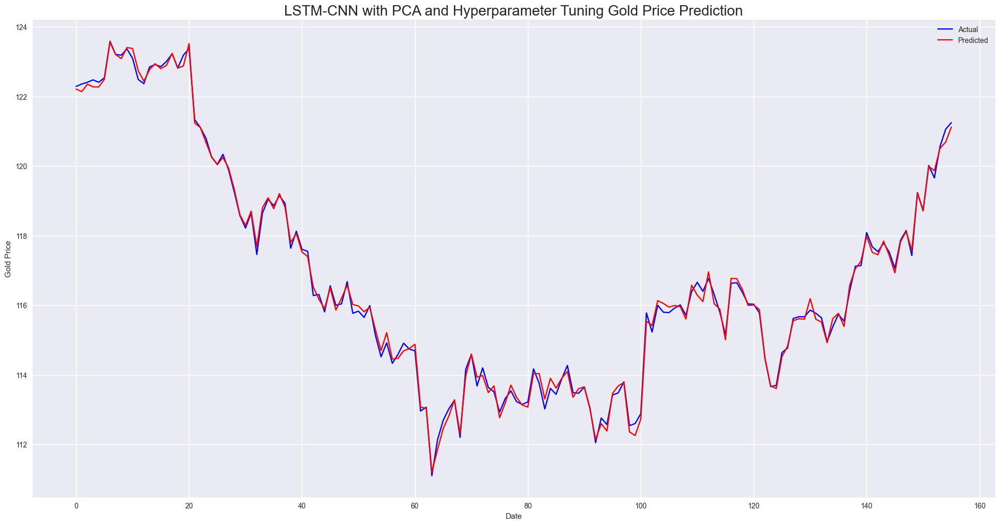

In [138]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-CNN with PCA",
    history=None, 
    training_time=lstm_cnn_pca_training_time,
    y_train=y_train_pca,
    y_test=y_test_pca,
    train_pred=lstm_cnn_pca_train_pred,
    test_pred=lstm_cnn_pca_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.2.3 Solution Model: BiLSTM-CNN with PCA

In [139]:
# Reshape data for BiLSTM-CNN input
X_train_bilstm_cnn_pca = X_train_pca.values.reshape(X_train_pca.shape[0], 1, X_train_pca.shape[1])
X_test_bilstm_cnn_pca = X_test_pca.values.reshape(X_test_pca.shape[0], 1, X_test_pca.shape[1])

# Check the shape of the training and testing data
X_train_bilstm_cnn_pca.shape, X_test_bilstm_cnn_pca.shape
print(f"X_train_bilstm_cnn_pca shape: {X_train_bilstm_cnn_pca.shape}")
print(f"X_test_bilstm_cnn_pca shape: {X_test_bilstm_cnn_pca.shape}")

X_train_bilstm_cnn_pca shape: (1562, 1, 6)
X_test_bilstm_cnn_pca shape: (156, 1, 6)


In [140]:
# Build BiLSTM-CNN Model with hyperparameter tuning
def build_bilstm_cnn_pca_hyperpara_model(hp, input_shape):
    lstm_units = hp.Int('lstm_units', min_value=1, max_value=64, step=1)
    cnn_filters = hp.Int('cnn_filters', min_value=1, max_value=64, step=1)
    dense_units = hp.Int('dense_units', min_value=1, max_value=64, step=1)
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)

    model = Sequential()
    
    # 1st BiLSTM layer with hyperparameter-tuned units
    model.add(Bidirectional(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform'), input_shape=input_shape))
    model.add(Dropout(rate=dropout_rate))
    
    # 2nd BiLSTM layer with hyperparameter-tuned units
    model.add(Bidirectional(LSTM(units=lstm_units, return_sequences=True, kernel_initializer='glorot_uniform', recurrent_initializer='glorot_uniform')))
    model.add(Dropout(rate=dropout_rate))
    
    # CNN layers with hyperparameter-tuned filters
    model.add(Conv1D(filters=cnn_filters, kernel_size=1, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Flatten())
    
    # Dense layers with hyperparameter-tuned units
    model.add(Dense(units=dense_units, activation='relu', kernel_initializer='glorot_uniform'))
    model.add(Dense(1, kernel_initializer='glorot_uniform'))
    
    # Compiling the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

In [141]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_bilstm_cnn_pca_model, best_bilstm_cnn_pca_hyperparameters, bilstm_cnn_pca_tuner, bilstm_cnn_pca_training_time, bilstm_cnn_pca_test_pred, bilstm_cnn_pca_train_pred = tune_hyperparameters(
    X_train=X_train_bilstm_cnn_pca, 
    y_train=y_train_pca, 
    X_test=X_test_bilstm_cnn_pca, 
    y_test=y_test_pca, 
    build_model_function=build_bilstm_cnn_pca_hyperpara_model,
    project_name='output_bilstm_cnn_pca',
    checkpoint_name='bilstm_cnn_pca'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn_pca\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_bilstm_cnn_pca\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 1ms/step


In [142]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_bilstm_cnn_pca_model, 
    tuner=bilstm_cnn_pca_tuner, 
    X_train=X_train_bilstm_cnn_pca, 
    y_train=y_train_pca, 
    X_test=X_test_bilstm_cnn_pca, 
    y_test=y_test_pca, 
    model_save_path="best_bilstm_cnn_model_with_pca.keras"
)

Loss on training set: 2.5349459648132324
Loss on test set: 0.026603857055306435 

Best Hyperparameter Values: {'lstm_units': 31, 'cnn_filters': 4, 'dense_units': 34, 'dropout_rate': 0.30000000000000004} 

Results summary
Results in hyperparameter_tuning\output_bilstm_cnn_pca
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 07 summary
Hyperparameters:
lstm_units: 31
cnn_filters: 4
dense_units: 34
dropout_rate: 0.30000000000000004
Score: 0.026603857055306435

Trial 04 summary
Hyperparameters:
lstm_units: 50
cnn_filters: 8
dense_units: 20
dropout_rate: 0.0
Score: 0.027310295030474663

Trial 03 summary
Hyperparameters:
lstm_units: 44
cnn_filters: 5
dense_units: 3
dropout_rate: 0.4
Score: 0.042223792523145676

Trial 02 summary
Hyperparameters:
lstm_units: 59
cnn_filters: 50
dense_units: 50
dropout_rate: 0.30000000000000004
Score: 0.05156761407852173

Trial 08 summary
Hyperparameters:
lstm_units: 60
cnn_filters: 40
dense_units: 29
dropout_rate: 0.4
Score: 0.059621885


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 1, 62)             9424      
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 1, 62)             0         
                                                                 
 bidirectional_1 (Bidirecti  (None, 1, 62)             23312     
 onal)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 1, 62)             0         
                                                                 
 conv1d (Conv1D)             (None, 1, 4)              252       
                                                                 
 flatten (Flatten)           (None,

Time Measurement and Monitoring for BiLSTM-CNN with PCA and Hyperparameter Tuning
Training time: 3 minutes and 48.87 seconds

Training Evaluation Metrics for BiLSTM-CNN with PCA and Hyperparameter Tuning
Training R2 Score: 0.9921960648544932
Training Mean Absolute Error (MAE): 0.8865300219173257
Training Root Mean Squared Error (RMSE): 1.5921514932431988
Training Mean Absolute Percentage Error (MAPE): 0.6297936956598358 %

Testing Evaluation Metrics for BiLSTM-CNN with PCA and Hyperparameter Tuning
R2 Score: 0.9974637826601456
Mean Absolute Error (MAE): 0.13083523568647365
Root Mean Squared Error (RMSE): 0.16310693431907808
Mean Absolute Percentage Error (MAPE): 0.11217941496509364 %


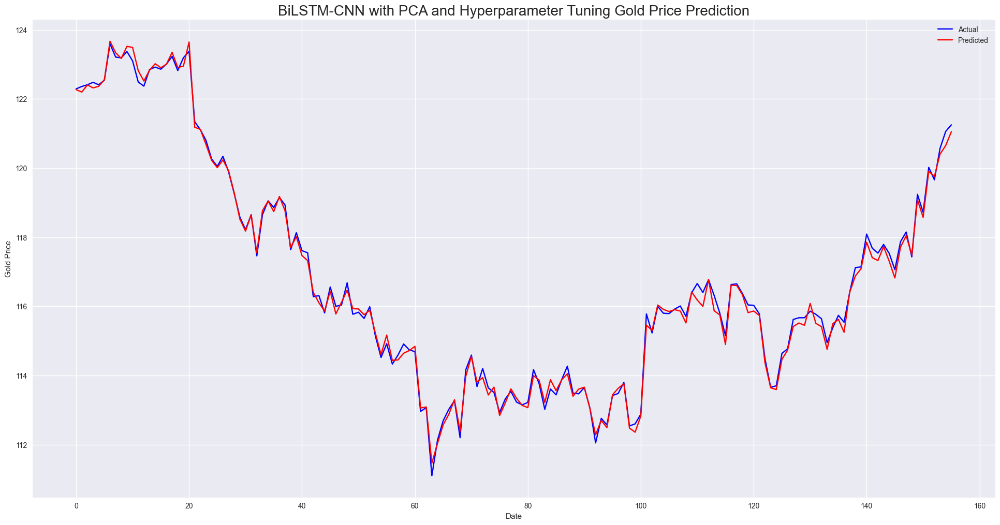

In [143]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="BiLSTM-CNN with PCA",
    history=None, 
    training_time=bilstm_cnn_pca_training_time,
    y_train=y_train_pca,
    y_test=y_test_pca,
    train_pred=bilstm_cnn_pca_train_pred,
    test_pred=bilstm_cnn_pca_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

### 9.2.4 Solution Model: LSTM-GRU with PCA

In [144]:
# Reshape data for LSTM-GRU input
X_train_lstm_gru_pca = X_train_pca.values.reshape((X_train_pca.shape[0], 1, X_train_pca.shape[1]))
X_test_lstm_gru_pca = X_test_pca.values.reshape((X_test_pca.shape[0], 1, X_test_pca.shape[1]))

# Check the new shape of the training and testing data
print(f"X_train_lstm_gru_pca shape: {X_train_lstm_gru_pca.shape}")
print(f"X_test_lstm_gru_pca shape: {X_test_lstm_gru_pca.shape}")

X_train_lstm_gru_pca shape: (1562, 1, 6)
X_test_lstm_gru_pca shape: (156, 1, 6)


In [145]:
# Call the tune_hyperparameters function to find the best hyperparameters for the model
best_lstm_gru_pca_model, best_lstm_gru_pca_hyperparameters, lstm_gru_pca_tuner, lstm_gru_pca_training_time, lstm_gru_pca_test_pred, lstm_gru_pca_train_pred = tune_hyperparameters(
    X_train=X_train_lstm_gru_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_gru_pca, 
    y_test=y_test_pca, 
    build_model_function=build_lstm_gru_hyperpara_model,
    project_name='output_lstm_gru_pca',
    checkpoint_name='lstm_gru_pca'
)

INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru_pca\tuner0.json


INFO:tensorflow:Reloading Tuner from hyperparameter_tuning\output_lstm_gru_pca\tuner0.json


INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


49/49 [==============================] - 0s 955us/step


In [146]:
# Call the summarized model performance function to display the best model
summarize_model_performance(
    model=best_lstm_gru_pca_model, 
    tuner=lstm_gru_pca_tuner, 
    X_train=X_train_lstm_gru_pca, 
    y_train=y_train_pca, 
    X_test=X_test_lstm_gru_pca, 
    y_test=y_test_pca, 
    model_save_path="best_lstm_gru_model_with_pca.keras"
)

Loss on training set: 3.6328539848327637
Loss on test set: 0.03440296649932861 

Best Hyperparameter Values: {'lstm_units': 32, 'gru_units': 43, 'dense_units': 9, 'dropout_rate': 0.1} 

Results summary
Results in hyperparameter_tuning\output_lstm_gru_pca
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 08 summary
Hyperparameters:
lstm_units: 32
gru_units: 43
dense_units: 9
dropout_rate: 0.1
Score: 0.03440296649932861

Trial 04 summary
Hyperparameters:
lstm_units: 30
gru_units: 52
dense_units: 7
dropout_rate: 0.2
Score: 0.03623749688267708

Trial 07 summary
Hyperparameters:
lstm_units: 10
gru_units: 36
dense_units: 37
dropout_rate: 0.1
Score: 0.04129962995648384

Trial 02 summary
Hyperparameters:
lstm_units: 20
gru_units: 42
dense_units: 38
dropout_rate: 0.1
Score: 0.057032134383916855

Trial 05 summary
Hyperparameters:
lstm_units: 15
gru_units: 64
dense_units: 38
dropout_rate: 0.2
Score: 0.06552308797836304

Trial 00 summary
Hyperparameters:
lstm_units: 37
gru_


Best Model Summary:
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 32)             4992      
                                                                 
 dropout (Dropout)           (None, 1, 32)             0         
                                                                 
 gru (GRU)                   (None, 43)                9933      
                                                                 
 dropout_1 (Dropout)         (None, 43)                0         
                                                                 
 dense (Dense)               (None, 9)                 396       
                                                                 
 dense_1 (Dense)             (None, 1)                 10        
                                                                 
Total params: 15331 (59.89 KB)
Trai

Time Measurement and Monitoring for LSTM-GRU with PCA and Hyperparameter Tuning
Training time: 2 minutes and 47.18 seconds

Training Evaluation Metrics for LSTM-GRU with PCA and Hyperparameter Tuning
Training R2 Score: 0.9888161112448156
Training Mean Absolute Error (MAE): 0.9541461425334227
Training Root Mean Squared Error (RMSE): 1.9060047648348082
Training Mean Absolute Percentage Error (MAPE): 0.6480857286468267 %

Testing Evaluation Metrics for LSTM-GRU with PCA and Hyperparameter Tuning
R2 Score: 0.9967202738819751
Mean Absolute Error (MAE): 0.14762971518179085
Root Mean Squared Error (RMSE): 0.18548038148381651
Mean Absolute Percentage Error (MAPE): 0.1270101225582964 %


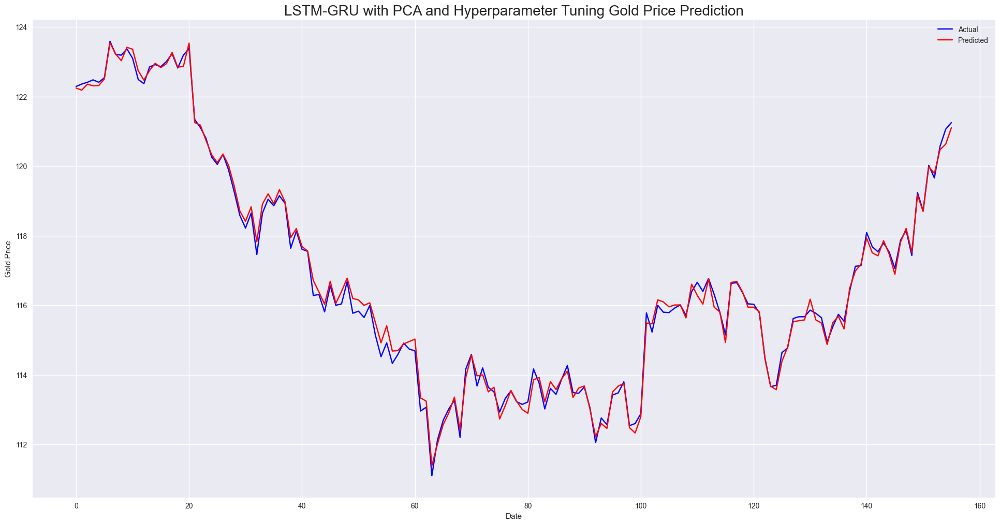

In [147]:
# Evaluate and plot results for the model
evaluate_and_plot_results(
    model_name="LSTM-GRU with PCA",
    history=None, 
    training_time=lstm_gru_pca_training_time,
    y_train=y_train_pca,
    y_test=y_test_pca,
    train_pred=lstm_gru_pca_train_pred,
    test_pred=lstm_gru_pca_test_pred,
    title_suffix="and Hyperparameter Tuning",
    is_tuned=True
)

# 10.0 Model Evaluation

In [148]:
# Define a function to create a summary DataFrame
def create_evaluation_summary(model_names, r2_scores, maes, rmses, mapes, elapsed_times):
    results = {
        'Model': model_names,
        'R2 Score': r2_scores,
        'MAE': maes,
        'RMSE': rmses,
        'MAPE (%)': mapes,
        'Elapsed Times': elapsed_times,
    }
    summary_df = pd.DataFrame(results)
    return summary_df

# List of model names as they correspond to your runs
model_names = [
    'LSTM without tuning', 'LSTM with tuning', 
    'LSTM-CNN without tuning', 'LSTM-CNN with tuning', 
    'BiLSTM-CNN without tuning', 'BiLSTM-CNN with tuning', 
    'LSTM-GRU without tuning', 'LSTM-GRU with tuning', 
    'LSTM with tuning & New Features', 'LSTM-CNN with tuning & New Features', 'BiLSTM-CNN with tuning & New Features', 'LSTM-GRU with tuning & New Features',
    'LSTM with tuning & PCA', 'LSTM-CNN with tuning & PCA', 'BiLSTM-CNN with tuning & PCA', 'LSTM-GRU with tuning & PCA'
]

# Create the summary DataFrame
evaluation_summary = create_evaluation_summary(model_names, r2_scores, maes, rmses, mapes, elapsed_times)

# Display the summary table
evaluation_summary

,Model,R2 Score,MAE,RMSE,MAPE (%),Elapsed Times
0,LSTM without tuning,0.249660,2.325528,2.707152,2.008592,0 minutes and 21.64 seconds
1,LSTM with tuning,0.936328,0.607172,0.788601,0.523035,3 minutes and 22.92 seconds
2,LSTM-CNN without tuning,0.579752,1.706872,2.025987,1.468423,0 minutes and 25.52 seconds
3,LSTM-CNN with tuning,0.886858,0.843774,1.051226,0.725119,5 minutes and 11.14 seconds
4,BiLSTM-CNN without tuning,0.499042,1.731400,2.211996,1.467371,0 minutes and 31.88 seconds
5,BiLSTM-CNN with tuning,0.938638,0.597791,0.774167,0.513396,9 minutes and 8.21 seconds
6,LSTM-GRU without tuning,0.545491,1.696874,2.106954,1.469719,0 minutes and 22.06 seconds
7,LSTM-GRU with tuning,0.933501,0.625581,0.805917,0.538852,3 minutes and 53.36 seconds
8,LSTM with tuning & New Features,0.930090,0.638235,0.826331,0.549341,3 minutes and 52.45 seconds
9,LSTM-CNN with tuning & New Features,0.887990,0.835316,1.045954,0.718596,5 minutes and 5.70 seconds


In [149]:
# To save the summary as a CSV file
evaluation_summary.to_csv('model_evaluation_summary.csv', index=False)

# To save the summary as an Excel file
evaluation_summary.to_excel('model_evaluation_summary.xlsx', index=False)

In [150]:
# Define the conversion function
def time_to_seconds(time_string):
    if pd.isna(time_string):
        return None
    parts = time_string.split(' ')
    minutes = int(parts[0])
    seconds = float(parts[3])
    return minutes * 60 + seconds

# Apply the function to the 'Elapsed Times' column
evaluation_summary['Elapsed Time (seconds)'] = evaluation_summary['Elapsed Times'].apply(time_to_seconds)

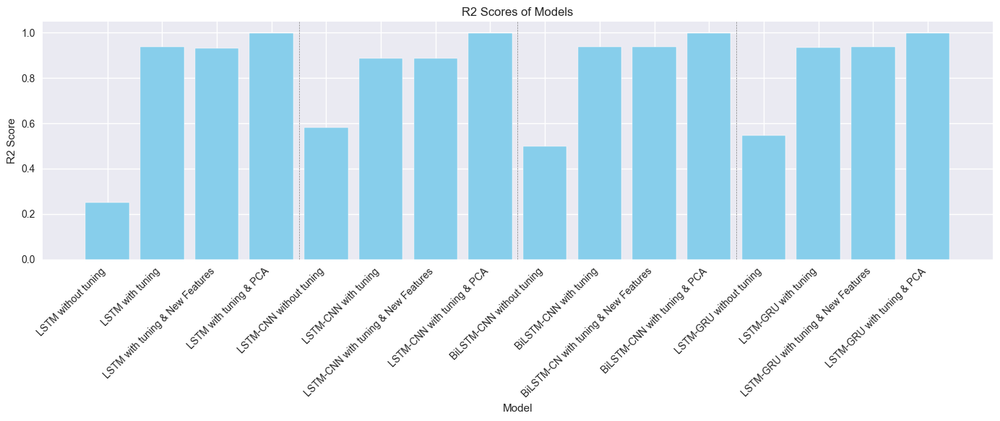

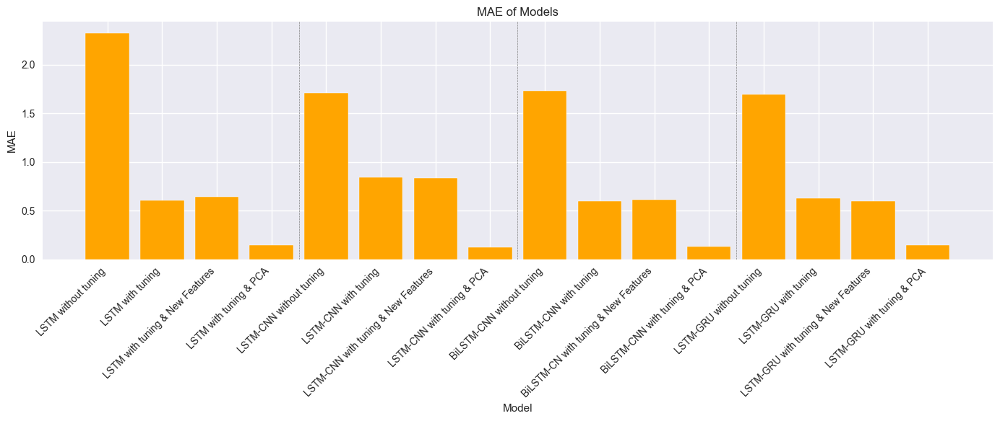

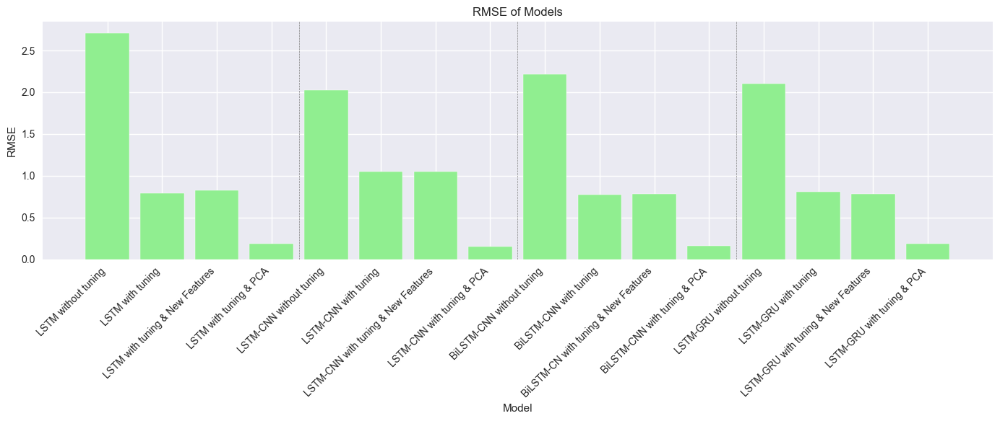

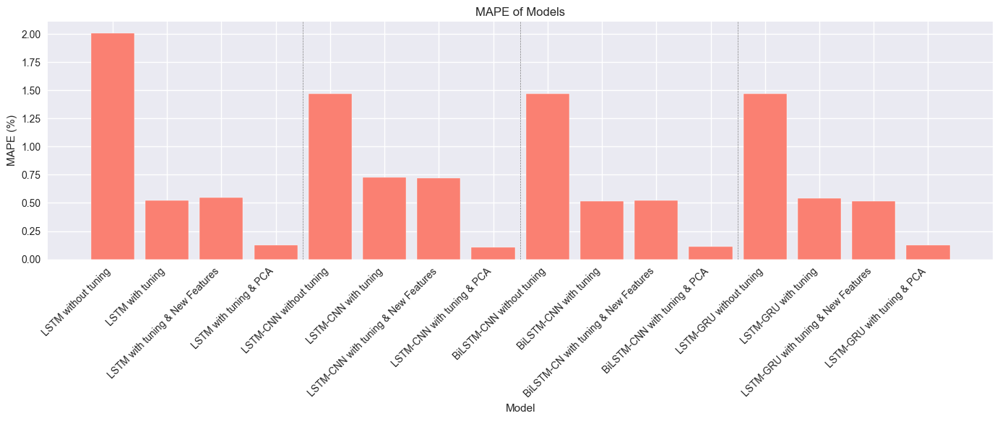

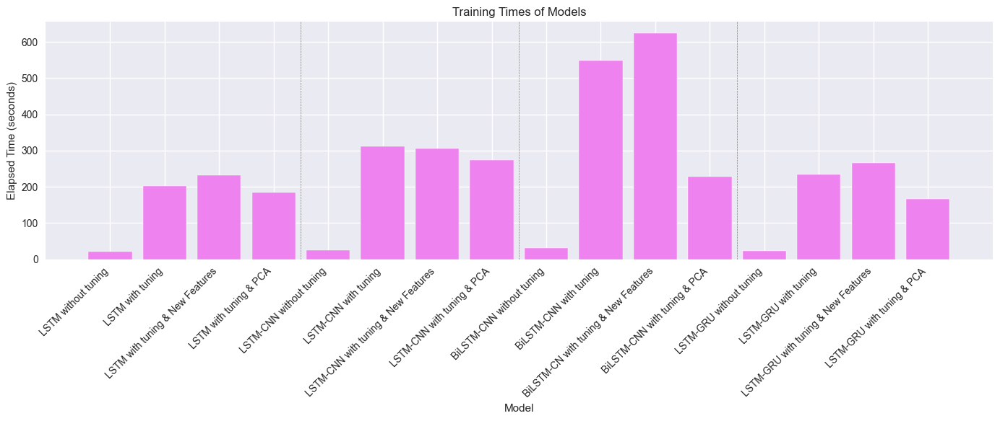

In [151]:
# Define the custom order for the models
model_order = [
    'LSTM without tuning', 'LSTM with tuning', 'LSTM with tuning & New Features', 'LSTM with tuning & PCA',
    'LSTM-CNN without tuning', 'LSTM-CNN with tuning', 'LSTM-CNN with tuning & New Features', 'LSTM-CNN with tuning & PCA',
    'BiLSTM-CNN without tuning', 'BiLSTM-CNN with tuning', 'BiLSTM-CN with tuning & New Features', 'BiLSTM-CNN with tuning & PCA',
    'LSTM-GRU without tuning', 'LSTM-GRU with tuning', 'LSTM-GRU with tuning & New Features', 'LSTM-GRU with tuning & PCA'
]

# Sort the DataFrame according to the custom order
evaluation_summary['Model_Order'] = evaluation_summary['Model'].apply(lambda x: model_order.index(x))
evaluation_summary_sorted = evaluation_summary.sort_values('Model_Order')

def create_bar_plot(y_values, title, y_label, color, model_groups):
    plt.figure(figsize=(14, 6))
    bars = plt.bar(evaluation_summary_sorted['Model'], evaluation_summary_sorted[y_values], color=color)
    plt.title(title)
    plt.xlabel('Model')
    plt.xticks(rotation=45, ha="right")
    plt.ylabel(y_label)
    
    # Draw vertical lines to separate model groups
    group_positions = np.cumsum([len(group) for group in model_groups]) - 0.5
    for pos in group_positions[:-1]:  # Exclude the last position to avoid a line at the end
        plt.axvline(x=pos, color='gray', linestyle='--', linewidth=0.5)

    plt.tight_layout()
    plt.show()

# Define groups of models (4 groups based on the order provided)
model_groups = [
    ['LSTM without tuning', 'LSTM with tuning', 'LSTM with tuning & New Features', 'LSTM with tuning & PCA'],
    ['LSTM-CNN without tuning', 'LSTM-CNN with tuning', 'LSTM-CNN with tuning & New Features', 'LSTM-CNN with tuning & PCA'],
    ['BiLSTM-CNN without tuning', 'BiLSTM-CNN with tuning', 'BiLSTM-CN with tuning & New Features', 'BiLSTM-CNN with tuning & PCA'],
    ['LSTM-GRU without tuning', 'LSTM-GRU with tuning', 'LSTM-GRU with tuning & New Features', 'LSTM-GRU with tuning & PCA']
]

# Plot R2 Scores
create_bar_plot('R2 Score', 'R2 Scores of Models', 'R2 Score', 'skyblue', model_groups)

# Plot Mean Absolute Error (MAE)
create_bar_plot('MAE', 'MAE of Models', 'MAE', 'orange', model_groups)

# Plot Root Mean Squared Error (RMSE)
create_bar_plot('RMSE', 'RMSE of Models', 'RMSE', 'lightgreen', model_groups)

# Plot Mean Absolute Percentage Error (MAPE)
create_bar_plot('MAPE (%)', 'MAPE of Models', 'MAPE (%)', 'salmon', model_groups)

# Plot Elapsed Time
create_bar_plot('Elapsed Time (seconds)', 'Training Times of Models', 'Elapsed Time (seconds)', 'violet', model_groups)

# 11.0 Forecasting Results

## 11.1 Comparison of Model Forecasts

5/5 [==============================] - 0s 2ms/step


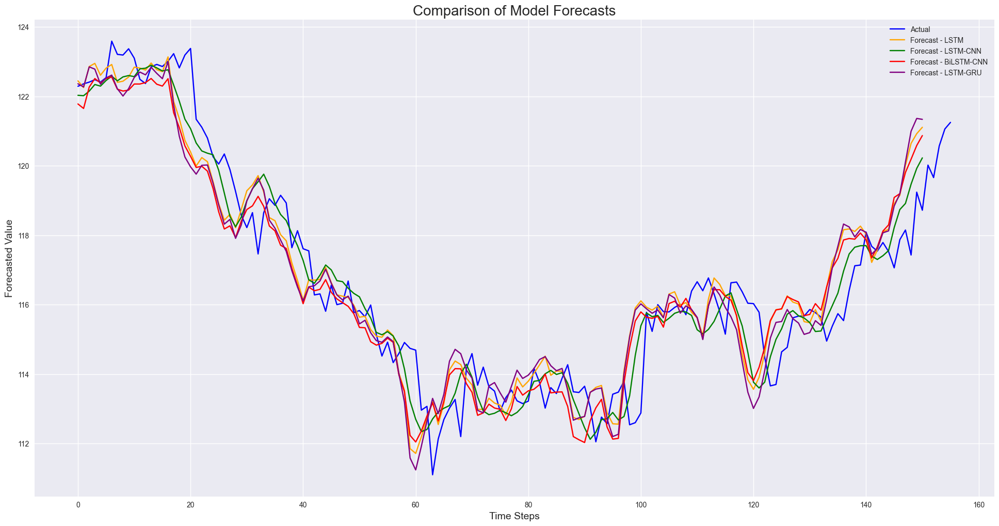

In [152]:
# Test data for each model
test_data = {
    'LSTM': X_test_lstm,
    'LSTM-CNN': X_test_lstm_cnn,
    'BiLSTM-CNN': X_test_bilstm_cnn,
    'LSTM-GRU': X_test_lstm_gru
}

# Load trained models
model_filenames = {
    'LSTM': "best_lstm_model.keras",
    'LSTM-CNN': "best_lstm_cnn_model.keras",
    'BiLSTM-CNN': "best_bilstm_cnn_model.keras",
    'LSTM-GRU': "best_lstm_gru_model.keras"
}

# Colors for each model
model_colors = {
    'LSTM': 'orange',
    'LSTM-CNN': 'green',
    'BiLSTM-CNN': 'red',
    'LSTM-GRU': 'purple'
}

models = {}
for name, filename in model_filenames.items():
    models[name] = tf.keras.models.load_model(f"saved_models/{filename}")

# Generate forecasts for each model
forecasted_results = {}
for name, model in models.items():
    X_test = test_data[name]
    forecasted_results[name] = model.predict(X_test).flatten()

# Plot the actual and forecasted results
plt.figure(figsize=(24, 12))
plt.plot(y_test, label='Actual', color='blue')

for name, forecast in forecasted_results.items():
    plt.plot(forecast, label=f'Forecast - {name}', color=model_colors[name])

plt.title('Comparison of Model Forecasts', fontsize=20)
plt.xlabel('Time Steps', fontsize=14)
plt.ylabel('Forecasted Value', fontsize=14)
plt.legend()
plt.show()

## 11.2 Comparison of New Features Model Forecasts

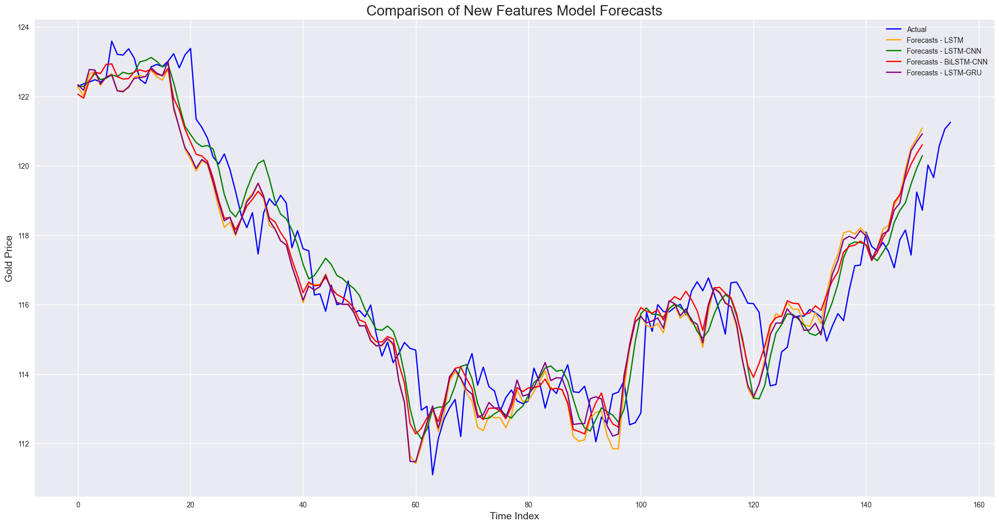

In [153]:
# Plot actual vs predicted for all new feature models
plt.figure(figsize=(24, 12))

# Plot actual values
plt.plot(y_test_nf, label='Actual', color='blue')

# Plot predicted values for each model
plt.plot(lstm_nf_test_pred.flatten(), label='Forecasts - LSTM', color='orange')
plt.plot(lstm_cnn_nf_test_pred.flatten(), label='Forecasts - LSTM-CNN', color='green')
plt.plot(bilstm_cnn_nf_test_pred.flatten(), label='Forecasts - BiLSTM-CNN', color='red')
plt.plot(lstm_gru_nf_test_pred.flatten(), label='Forecasts - LSTM-GRU', color='purple')

# Title and labels
plt.title('Comparison of New Features Model Forecasts', fontsize=20)
plt.xlabel('Time Index', fontsize=14) 
plt.ylabel('Gold Price', fontsize=14)

# Show legend
plt.legend()

# Display plot
plt.show()

## 11.3 Comparison of PCA Model Forecasts

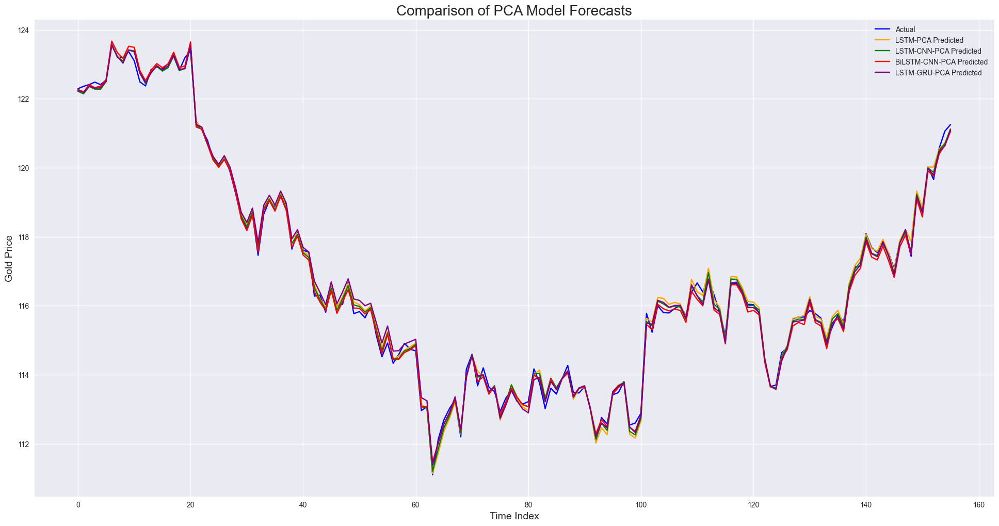

In [154]:
# Plot actual vs predicted for all PCA models
plt.figure(figsize=(24, 12))

# Plot actual values
plt.plot(y_test_pca, label='Actual', color='blue')

# Plot predicted values for each model
plt.plot(lstm_pca_test_pred.flatten(), label='LSTM-PCA Predicted', color='orange')
plt.plot(lstm_cnn_pca_test_pred.flatten(), label='LSTM-CNN-PCA Predicted', color='green')
plt.plot(bilstm_cnn_pca_test_pred.flatten(), label='BiLSTM-CNN-PCA Predicted', color='red')
plt.plot(lstm_gru_pca_test_pred.flatten(), label='LSTM-GRU-PCA Predicted', color='purple')
 
# Title and labels
plt.title('Comparison of PCA Model Forecasts', fontsize=20)
plt.xlabel('Time Index', fontsize=14) 
plt.ylabel('Gold Price', fontsize=14)

# Show legend
plt.legend()

# Display plot
plt.show()

<p style="font-family:Calibri;font-size:120%;color:black;text-align:center;border-radius:25px 25px;padding:10px;letter-spacing:2px;">~ End Of Code ♡ ´･ᴗ･` ~</p>